# Install packages

In [ ]:
!pip install DeepForest
!pip install roboflow
# !pip install detectree
# !pip install git+https://github.com/PatBall1/detectree2.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 77.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 82.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 488.6/488.6 kB 44.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 774.6/774.6 kB 63.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.2/805.2 kB 69.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 22.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━

# DeepForest

## Training

In [ ]:


from roboflow import Roboflow
rf = Roboflow(api_key="MBH9GbS7Y5nKnlxBEd5J")
project = rf.workspace("unsw-urbanai").project("tree-detection-in-sydney")
dataset = project.version(2).download("tensorflow")



loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Tree-Detection-in-Sydney-2 in tensorflow:: 100%|██████████| 228/228 [00:00<00:00, 2788.69it/s]


In [ ]:
from deepforest import main
import os
import matplotlib.pyplot as plt
model = main.deepforest()
model.use_release()

Reading config file: /usr/local/lib/python3.10/dist-packages/deepforest/data/deepforest_config.yml


Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:02<00:00, 63.2MB/s]


No validation file provided. Turning off validation loop


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


NEON.pt: 129MB [00:08, 15.5MB/s]                           


Model was downloaded and saved to /usr/local/lib/python3.10/dist-packages/deepforest/data/NEON.pt
Loading pre-built model: https://github.com/weecology/DeepForest/releases/tag/1.0.0


In [ ]:
model.config["epochs"] = 10
model.config["accelerator"] = "gpu"
model.config["save-snapshot"] = False
model.config["train"]["csv_file"] = "/content/Tree-Detection-in-Sydney-2/train/_annotations.csv"
model.config["train"]["root_dir"] = "/content/Tree-Detection-in-Sydney-2/train/"
model.config["validation"]["csv_file"] = "/content/Tree-Detection-in-Sydney-2/valid/_annotations.csv"
model.config["validation"]["root_dir"] = "/content/Tree-Detection-in-Sydney-2/valid"



INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


In [ ]:
import pandas as pd
df = pd.read_csv("/content/Tree-Detection-in-Sydney-2/train/_annotations.csv")
df.rename(columns={"filename": "image_path", "class" : "label"}, inplace=True)
df['label'] = "Tree"
df.to_csv("/content/Tree-Detection-in-Sydney-2/train/_annotations.csv", index=False)

df = pd.read_csv("/content/Tree-Detection-in-Sydney-2/valid/_annotations.csv")
df.rename(columns={"filename": "image_path", "class" : "label"}, inplace=True)
df['label'] = "Tree"
df.to_csv("/content/Tree-Detection-in-Sydney-2/valid/_annotations.csv", index=False)


In [ ]:
for i in range(0, 6):
    model.create_trainer()

    model.trainer.fit(model)
# Don't know why i put epoch to 10, but it still runs only 1 epoch.... sad...


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type      | Params
------------------------------------
0 | model | RetinaNet | 32.1 M
------------------------------------
31.9 M    Trainable params
222 K     Non-trainable params
32.1 M    Total params
128.592   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


## Predict

Works well in urban area,


-34-05975652023457_-34-05975652023457_png.rf.a1ee215e614c65d2815118a9b8b5005c.jpg


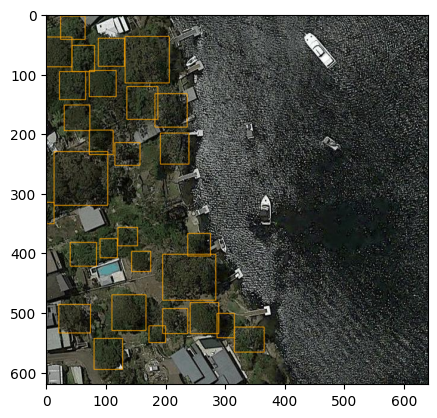

-33-787565523132514_-33-787565523132514_png.rf.aef521440de4eeac079dd44d1ac51a1b.jpg


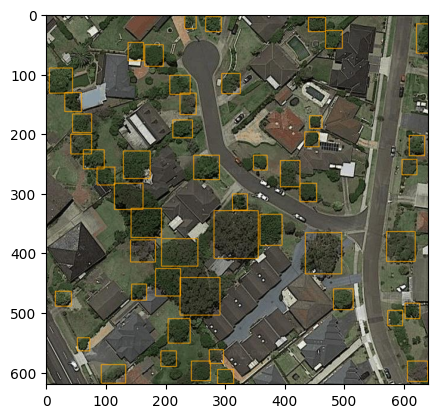

-33-77204462165503_-33-77204462165503_png.rf.c0802f9187c6e42547c269f8836fe6be.jpg


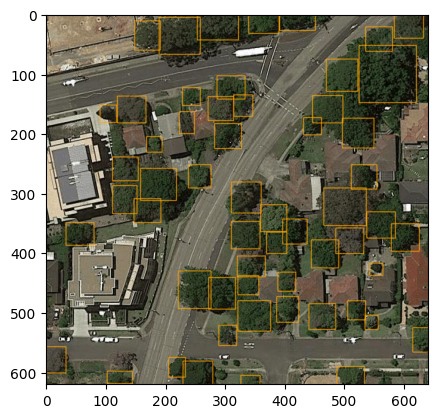

-33-936934727662816_-33-936934727662816_png.rf.09285297a45acbe71c54681dc64f8636.jpg


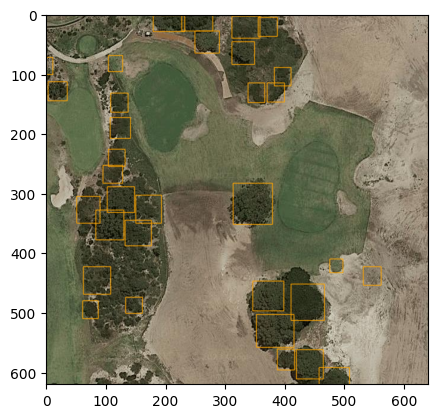

-33-825333518804094_-33-825333518804094_png.rf.1a55501721b47ed6963baf03fbd4ef45.jpg


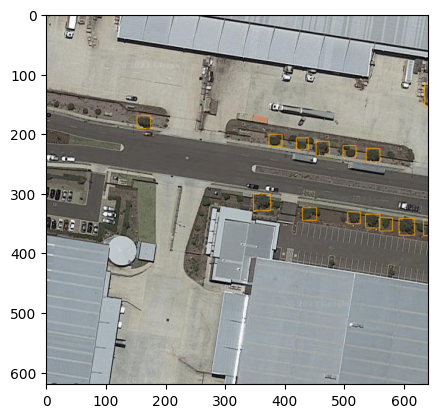

-33-79322352844539_-33-79322352844539_png.rf.3b5fe878c38d6588646eccbbbe103a2d.jpg


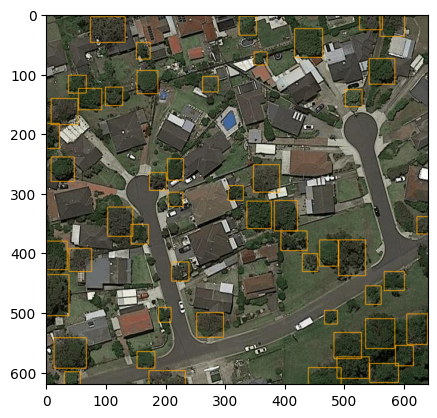

-33-84190386970322_-33-84190386970322_png.rf.288ff087d4cabe4f868bede79d872b2e.jpg


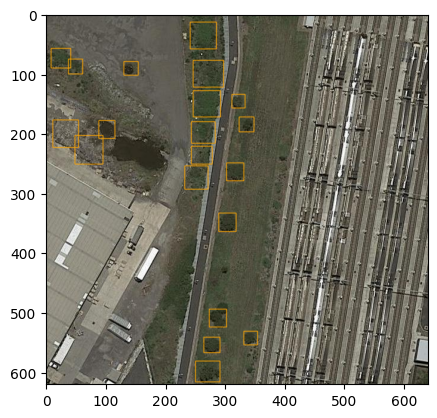

In [ ]:
# img_path = "/content/Tree-Detection-in-Sydney-1/test/-33-787565523132514_-33-787565523132514_png.rf.aef521440de4eeac079dd44d1ac51a1b.jpg"
# img_path = "/content/Tree-Detection-in-Sydney-1/test/-33-77204462165503_-33-77204462165503_png.rf.c0802f9187c6e42547c269f8836fe6be.jpg"
directory = os.fsencode("/content/Tree-Detection-in-Sydney-2/test/")

for file in os.listdir(directory):
     filename = os.fsdecode(file)
     if filename == "_annotations.csv":
          continue
     img = model.predict_image(path="/content/Tree-Detection-in-Sydney-2/test/" + filename, return_plot=True)

     print(filename)
      #predict_image returns plot in BlueGreenRed (opencv style), but matplotlib likes RedGreenBlue, switch the channel order.
     plt.imshow(img[:,:,::-1])
     plt.show()



-33-82056930704311_-33-82056930704311_png.rf.b4ed01943182ed20bf39c68c926c2976.jpg


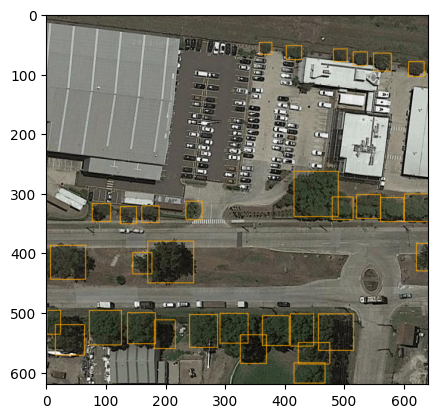

-33-83939310108943_-33-83939310108943_png.rf.b9935fe542a03f013ee8e412dc789a65.jpg


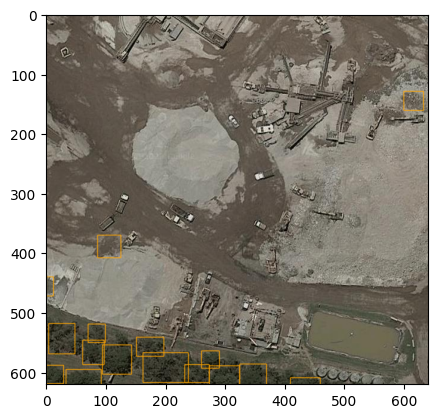

-33-75772422721496_-33-75772422721496_png.rf.42b48dd17da1fb35ca56b141f743eb4a.jpg


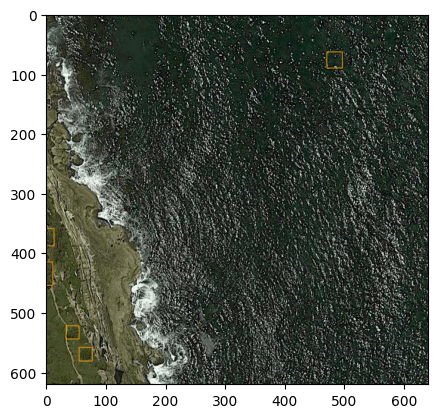

-33-78173763699905_-33-78173763699905_png.rf.46796e7380e63eef11b54406cdb48c67.jpg


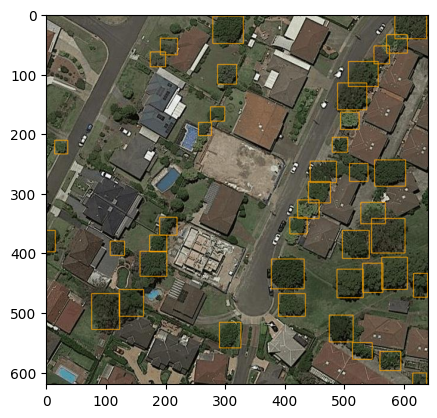

-33-83758338825295_-33-83758338825295_png.rf.1cf28f3161564ab970efe34213edd1d1.jpg


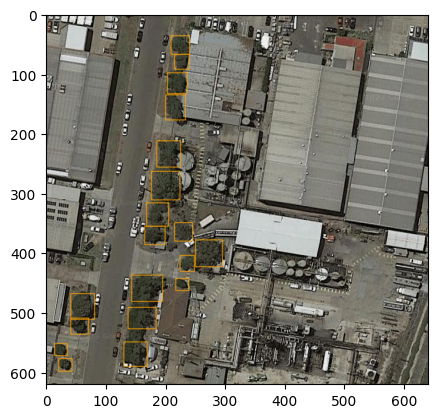

-33-79320549412111_-33-79320549412111_png.rf.feb0f6e1c3f83dc9e1f663745c0bd2b4.jpg


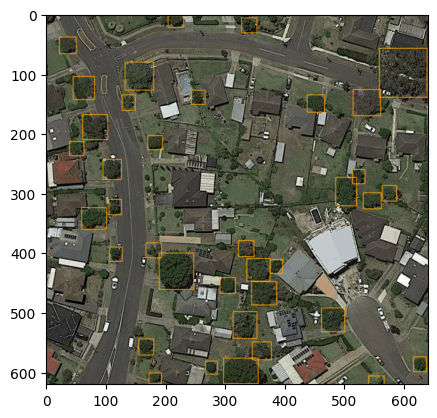

-33-846775344556434_-33-846775344556434_png.rf.05cf316a4792bb6b305b143b3b245fdc.jpg


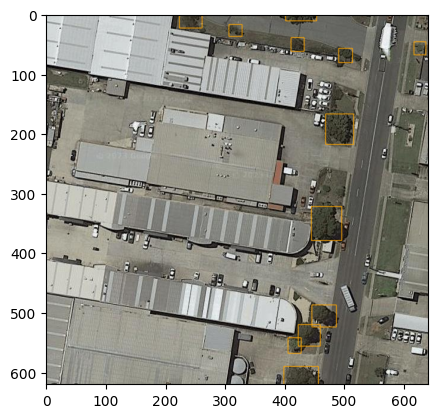

-33-752206652733236_-33-752206652733236_png.rf.1e3a00e48d7c41280f5d3f0cc9b8f392.jpg


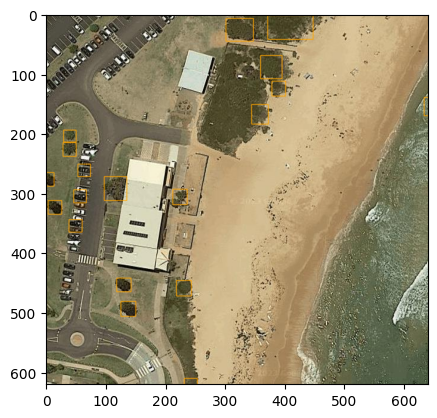

-33-79127565817694_-33-79127565817694_png.rf.a9d8a52a45e0bf00d334c553bdb33996.jpg


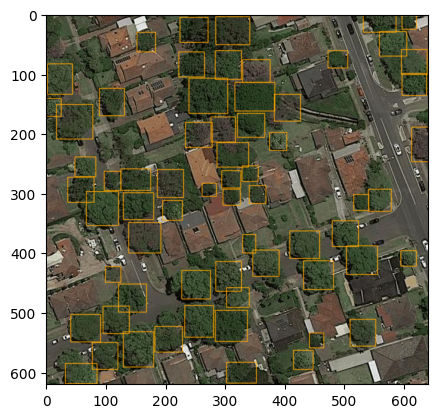

-33-814392643509336_-33-814392643509336_png.rf.7beea7f77b0ab9be08955b9358f1ab0a.jpg


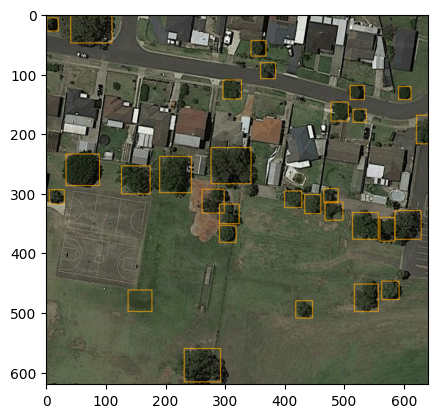

-33-771661978605295_-33-771661978605295_png.rf.fba81f95c508d100d37d8f508b873ec4.jpg


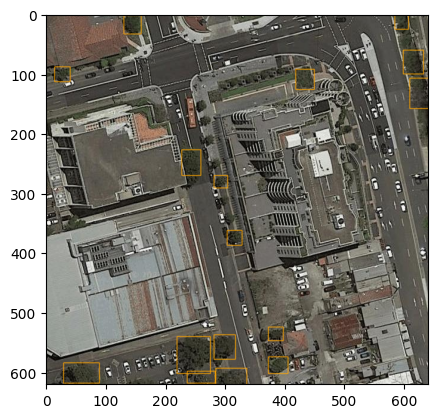

-33-78132830284324_-33-78132830284324_png.rf.2c5bd8b8639c6fceed7683aa22260444.jpg


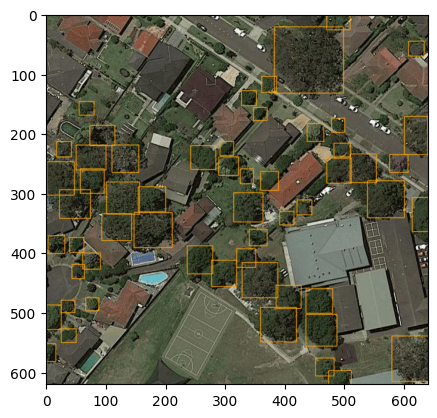

-33-788032863260284_-33-788032863260284_png.rf.ba5632683994053f5601e79f907a80ad.jpg


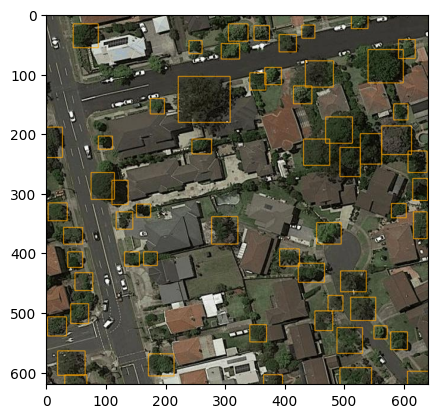

-34-06008965076173_-34-06008965076173_png.rf.5217174d570fbcd5a739645c2852f8dc.jpg


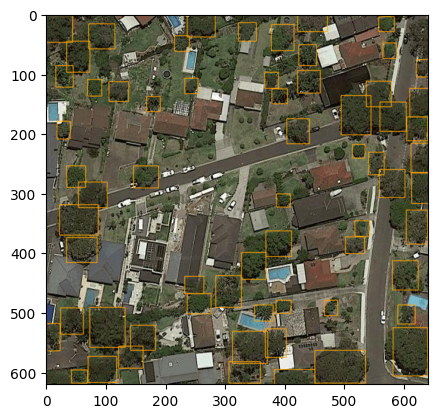

-33-77977499635599_-33-77977499635599_png.rf.75f9d9acb0abf8a2502ef989b7b4bd56.jpg


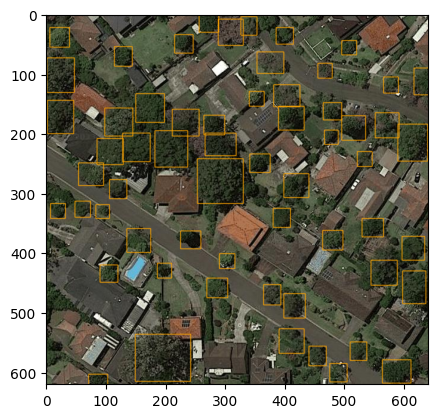

-33-8125603368135_-33-8125603368135_png.rf.e33e138dfeb2507b73bc7f9123d7e660.jpg


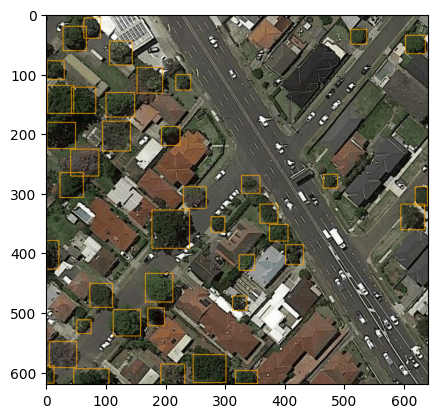

-33-84048150405653_-33-84048150405653_png.rf.3ad298aea6d51c63fa2e85804c2cc0de.jpg


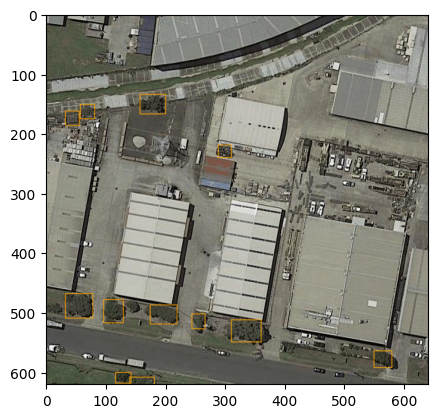

-33-79272203041733_-33-79272203041733_png.rf.fd0d229ff5e1f002399d24c65891150e.jpg


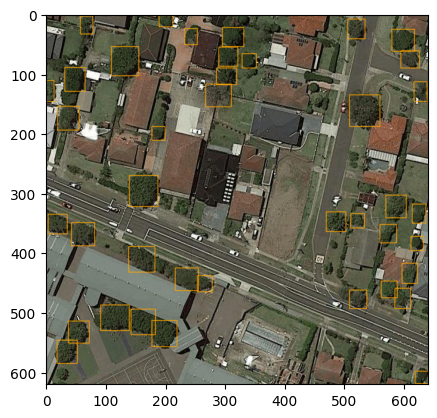

In [ ]:
# img_path = "/content/Tree-Detection-in-Sydney-1/test/-33-787565523132514_-33-787565523132514_png.rf.aef521440de4eeac079dd44d1ac51a1b.jpg"
# img_path = "/content/Tree-Detection-in-Sydney-1/test/-33-77204462165503_-33-77204462165503_png.rf.c0802f9187c6e42547c269f8836fe6be.jpg"
directory = os.fsencode("/content/Tree-Detection-in-Sydney-2/valid/")

for file in os.listdir(directory):
     filename = os.fsdecode(file)
     if filename == "_annotations.csv":
          continue
     img = model.predict_image(path="/content/Tree-Detection-in-Sydney-2/valid/" + filename, return_plot=True)

     print(filename)
      #predict_image returns plot in BlueGreenRed (opencv style), but matplotlib likes RedGreenBlue, switch the channel order.
     plt.imshow(img[:,:,::-1])
     plt.show()



## Save model

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
model.trainer.save_checkpoint("sydney_checkpoint.pl")


In [ ]:
# img2 = model.predict_image(path="/content/green_google_satellite.png",return_plot=False)

In [ ]:
# img2

# Cluster


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
! cp /content/drive/MyDrive/sydney_checkpoint2.pl .
# ! cp -r /content/drive/MyDrive/images .
# ! cp -r /content/drive/MyDrive/cropped_imgs .

Mounted at /content/drive


In [ ]:
from deepforest import main
import os
import matplotlib.pyplot as plt
model  = main.deepforest.load_from_checkpoint("/content/sydney_checkpoint2.pl")

Reading config file: /usr/local/lib/python3.10/dist-packages/deepforest/data/deepforest_config.yml


Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:01<00:00, 71.9MB/s]


No validation file provided. Turning off validation loop


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
img = model.predict_image(path = "/content/google_satellite.png", return_plot=True)
plt.show()


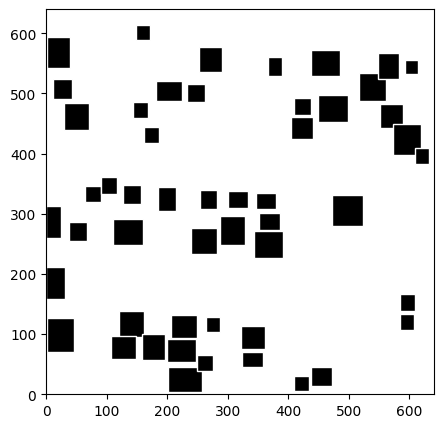

In [ ]:
img = model.predict_image(path = "/content/google_satellite.png", return_plot=False)
fig, ax = plt.subplots(figsize=(5, 5))
from matplotlib.patches import Rectangle
for index, row in img.iterrows():
        xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
        width = xmax - xmin
        height = ymax - ymin
        rect = Rectangle((xmin, ymin), width, height, linewidth=1, edgecolor='white', facecolor='black')
        ax.add_patch(rect)

        # rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=True)
        # ax.add_patch(rect)
ax.set_xlim(0, 640)
ax.set_ylim(0, 640)
# ax.set_xlabel('X-axis')
# ax.set_ylabel('Y-axis')
plt.show()

## data process

- Try auto encncoder

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="MBH9GbS7Y5nKnlxBEd5J")
project = rf.workspace("unsw-urbanai").project("tree-detection-in-sydney")
dataset = project.version(2).download("tensorflow")



loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Tree-Detection-in-Sydney-2 in tensorflow:: 100%|██████████| 228/228 [00:00<00:00, 2672.31it/s]


In [ ]:
from deepforest import main
import os
import matplotlib.pyplot as plt
model  = main.deepforest.load_from_checkpoint("/content/sydney_checkpoint2.pl")

Reading config file: /usr/local/lib/python3.10/dist-packages/deepforest/data/deepforest_config.yml


Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:00<00:00, 203MB/s]


No validation file provided. Turning off validation loop


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
file =  "/content/Tree-Detection-in-Sydney-2/test/-33-77204462165503_-33-77204462165503_png.rf.c0802f9187c6e42547c269f8836fe6be.jpg"
pred = model.predict_image(path = file)



In [ ]:
img = model.predict_image(path = "/content/stitched_image.png", return_plot=True)
plt.imshow(img[:,:,::-1])
plt.show()

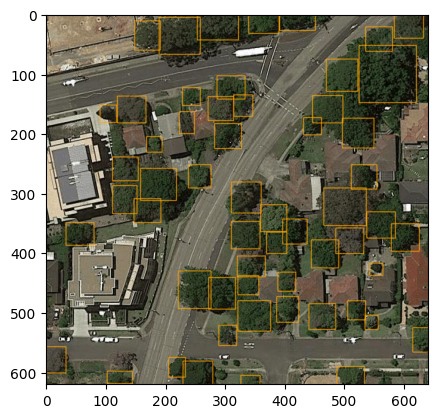

In [ ]:
img = model.predict_image(path = "/content/Tree-Detection-in-Sydney-2/test/-33-77204462165503_-33-77204462165503_png.rf.c0802f9187c6e42547c269f8836fe6be.jpg", return_plot=True)
plt.imshow(img[:,:,::-1])
plt.show()

In [ ]:
!rm cropped_imgs/ -rf
!mkdir cropped_imgs
import os
from PIL import Image
folder_path = "/content/images/"
for filename in os.listdir(folder_path):
   if filename.endswith('.jpg') or filename.endswith('.png'):
      print(filename)
      pred = model.predict_image(path = folder_path + filename)
      if pred is None:
          continue
      for index, row in pred.iterrows():
          xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
          image = Image.open(folder_path + filename)

          # Crop the image using the bounding box
          cropped_image = image.crop((xmin, ymin, xmax, ymax))
          # name = filename.split('.')[0]
          cropped_image.save(f'/content/cropped_imgs/{filename}_{index}.jpg')

# Open the image using PIL



-33.784795244929164_-33.784795244929164.png
-33.913677185520605_-33.913677185520605.png
-33.85315308182898_-33.85315308182898.png
-33.91840795152411_-33.91840795152411.png
-33.91108624210735_-33.91108624210735.png
-33.97307600603625_-33.97307600603625.png
-33.832925114904555_-33.832925114904555.png
-33.967111191127415_-33.967111191127415.png
-33.91047395810337_-33.91047395810337.png
-33.905226167643065_-33.905226167643065.png
-34.04369269887961_-34.04369269887961.png
-33.91150514080407_-33.91150514080407.png
-33.814392643509336_-33.814392643509336.png
-33.8006543628537_-33.8006543628537.png
-34.03729694257993_-34.03729694257993.png
-33.966249531009154_-33.966249531009154.png
-33.77492858950917_-33.77492858950917.png
-33.81202107135806_-33.81202107135806.png
-33.90852808789343_-33.90852808789343.png
-33.919328008694116_-33.919328008694116.png
-33.8613226347493_-33.8613226347493.png
-33.96263274456494_-33.96263274456494.png
-33.974194456550094_-33.974194456550094.png
-34.02933095725989_-

### Crop from training set

In [ ]:
from PIL import Image
folder_path = "/content/Tree-Detection-in-Sydney-2/train/"
for filename in os.listdir(folder_path):
   if filename.endswith('.jpg') or filename.endswith('.png'):
      print(filename.split('.rf.')[0])
  # file =  "/content/Tree-Detection-in-Sydney-2/test/-33-77204462165503_-33-77204462165503_png.rf.c0802f9187c6e42547c269f8836fe6be.jpg"
      pred = model.predict_image(path = folder_path + filename)
      if pred is None:
        continue
      for index, row in pred.iterrows():
          xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
          image = Image.open(folder_path + filename)

          # # Define the bounding box coordinates
          # xmin, ymin, xmax, ymax = 147.0,	309.0,	192.0,	349.0

          # Crop the image using the bounding box
          cropped_image = image.crop((xmin, ymin, xmax, ymax))
          name = filename.split('.rf.')[0]
          cropped_image.save(f'/content/cropped_trains/{name}_{index}.jpg')

-33-79341073135254_-33-79341073135254_png
-33-79140257455766_-33-79140257455766_png
-33-794766056579014_-33-794766056579014_png
-33-81018261141205_-33-81018261141205_png
-33-79208382680196_-33-79208382680196_png
-33-79612462834195_-33-79612462834195_png
-33-83793357584756_-33-83793357584756_png
-33-80303522425099_-33-80303522425099_png
-33-794766056579014_-33-794766056579014_png
-34-02868825999638_-34-02868825999638_png
-33-7881458629625_-33-7881458629625_png
-33-82837173183682_-33-82837173183682_png
-33-81173224253344_-33-81173224253344_png
-33-784795244929164_-33-784795244929164_png
-33-79430777628854_-33-79430777628854_png
-33-913677185520605_-33-913677185520605_png
-34-063661567701914_-34-063661567701914_png
-33-82118835175123_-33-82118835175123_png
-33-77714794282482_-33-77714794282482_png
-33-77724822236651_-33-77724822236651_png
-33-75280578242878_-33-75280578242878_png
-33-96450327978131_-33-96450327978131_png
-33-795970844687105_-33-795970844687105_png
-34-04681512996399_-34-0

## KNN + feature extracting

### Feature Extracting

In [ ]:
import cv2
import numpy as np
# sift = cv2.xfeatures2d.SIFT_create()
import cv2
import numpy as np

def extract_features(img, target_size=(100, 100)):
    height, width, channels = img.shape

    # Resize the image to the target size
    img = cv2.resize(img, target_size)

    # Separate the image into Red, Green, and Blue channels
    blue_channel, green_channel, red_channel = cv2.split(img)

    # Calculate basic statistics for each color channel
    mean_red = np.mean(red_channel)
    std_dev_red = np.std(red_channel)

    mean_green = np.mean(green_channel)
    std_dev_green = np.std(green_channel)

    mean_blue = np.mean(blue_channel)
    std_dev_blue = np.std(blue_channel)

    # Compute the histograms of pixel intensities for each channel
    hist_red = cv2.calcHist([red_channel], [0], None, [256], [0, 256])
    hist_green = cv2.calcHist([green_channel], [0], None, [256], [0, 256])
    hist_blue = cv2.calcHist([blue_channel], [0], None, [256], [0, 256])

    # Flatten the histograms to 1D arrays and normalize
    hist_red = hist_red.flatten() / hist_red.sum()
    hist_green = hist_green.flatten() / hist_green.sum()
    hist_blue = hist_blue.flatten() / hist_blue.sum()

    # Concatenate the features into a single vector
    features = np.concatenate([[mean_red, std_dev_red, mean_green, std_dev_green, mean_blue, std_dev_blue], hist_red])
    features = np.concatenate([features, hist_green])
    features = np.concatenate([features, hist_blue])

    return features


# print(extract_features(cv2.imread("/content/images/-33.771661978605295_-33.771661978605295.png")))


In [ ]:
import cv2
import os
from sklearn.cluster import KMeans
import shutil

# Define the folder path containing the images
folder_path = '/content/cropped_imgs'

# Load the images from the folder
images = []
paths = []
for filename in os.listdir(folder_path):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(folder_path, filename)
        paths.append(image_path)
        image = cv2.imread(image_path)
        images.append(image)

# Convert the images to feature vectors
feature_vectors = []
for image in images:
    # Extract features from the image (e.g., using color histograms, texture descriptors)
    feature_vector = extract_features(image)
    feature_vectors.append(feature_vector)

# Convert the feature vectors to a numpy array
X = np.array(feature_vectors)

Text(0, 0.5, 'cumulative explained variance')

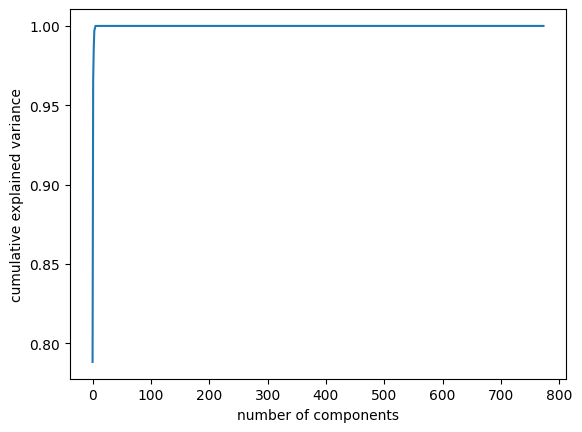

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

pca = PCA().fit(X )
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')


In [ ]:

pca = PCA(n_components=30)
PCA_X = pca.fit_transform(X)

In [ ]:
import joblib
joblib.dump(pca, 'pca.pkl')

['pca.pkl']

### Find Best K

For n_clusters = 2 The average silhouette_score is : 0.391366757708274
For n_clusters = 3 The average silhouette_score is : 0.3452144704030891
For n_clusters = 4 The average silhouette_score is : 0.2947313382036666
For n_clusters = 5 The average silhouette_score is : 0.29983318564079786
For n_clusters = 6 The average silhouette_score is : 0.29006715599418775
For n_clusters = 7 The average silhouette_score is : 0.2842247429399472
For n_clusters = 8 The average silhouette_score is : 0.26808746334550426
For n_clusters = 9 The average silhouette_score is : 0.2635662168833478
For n_clusters = 10 The average silhouette_score is : 0.2642706876502582
For n_clusters = 11 The average silhouette_score is : 0.2576031980287895
For n_clusters = 12 The average silhouette_score is : 0.24823526327097648
For n_clusters = 13 The average silhouette_score is : 0.25076440341360107
For n_clusters = 14 The average silhouette_score is : 0.2445013384975786
For n_clusters = 15 The average silhouette_score is : 0

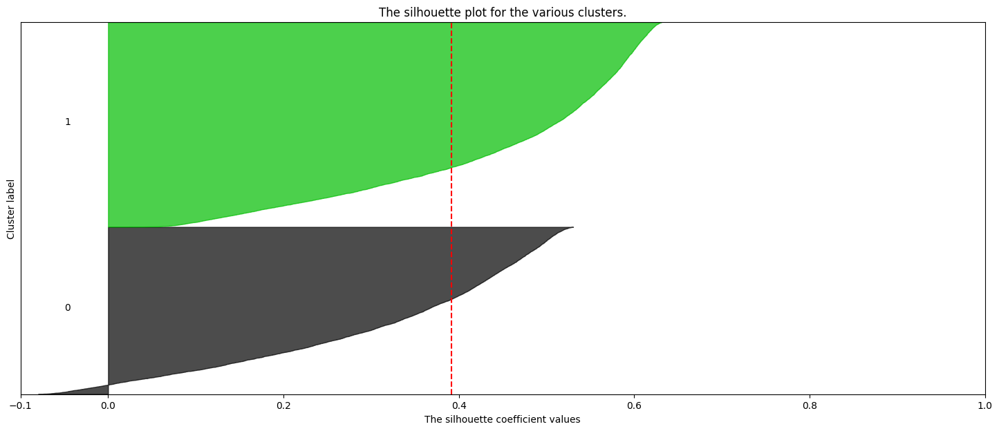

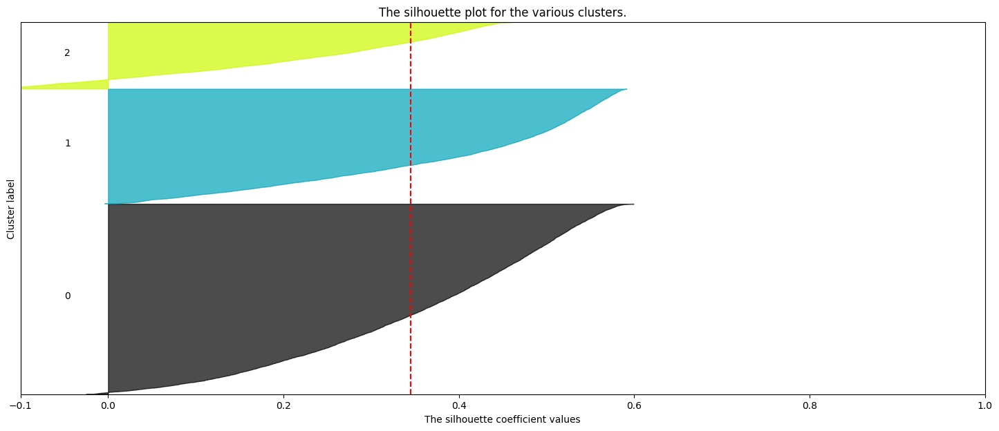

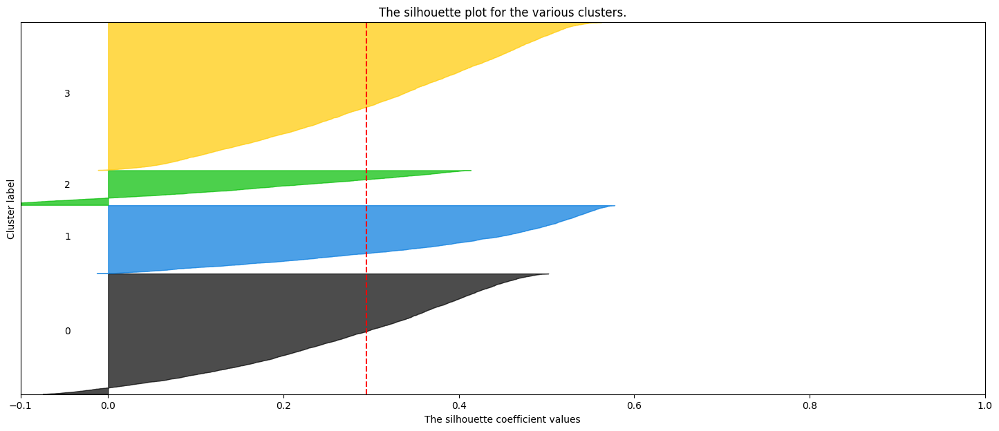

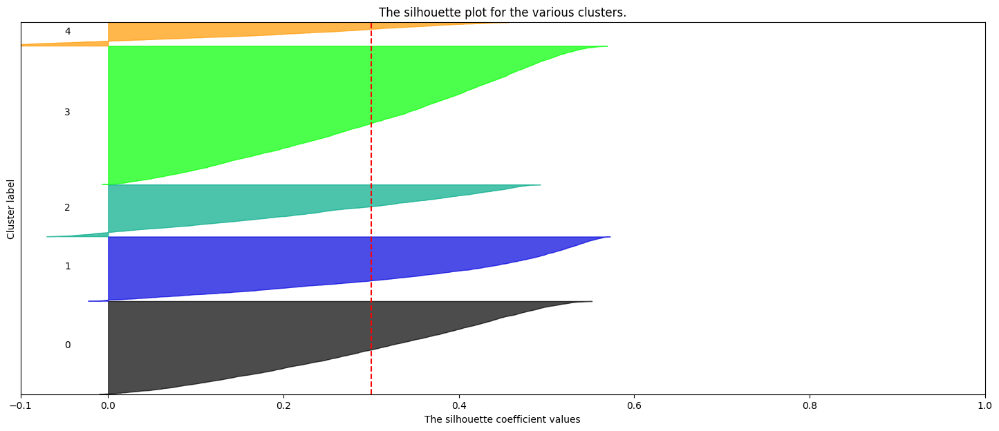

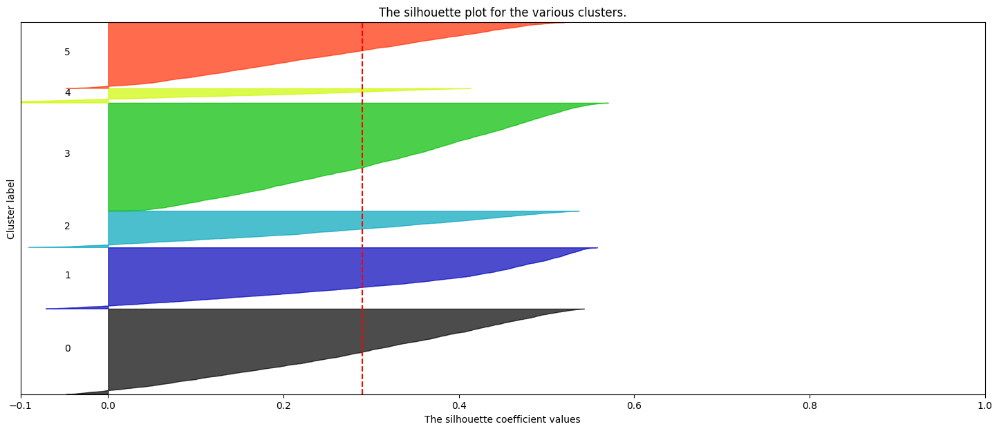

...

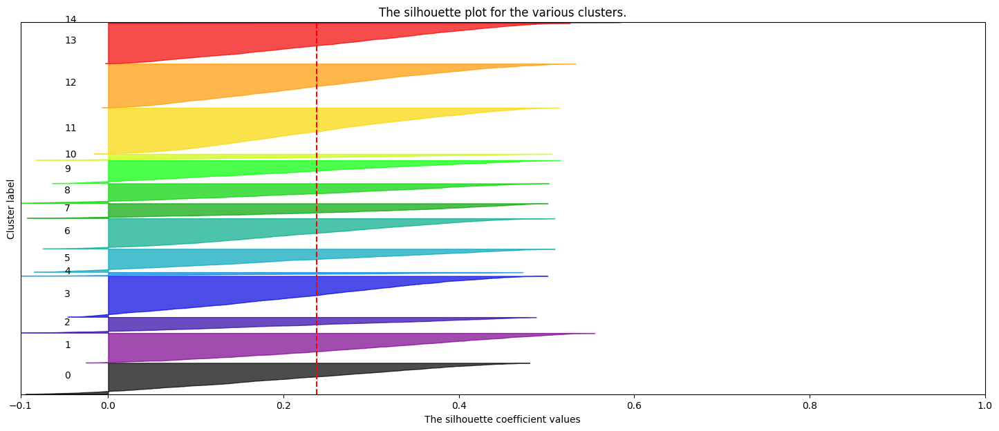

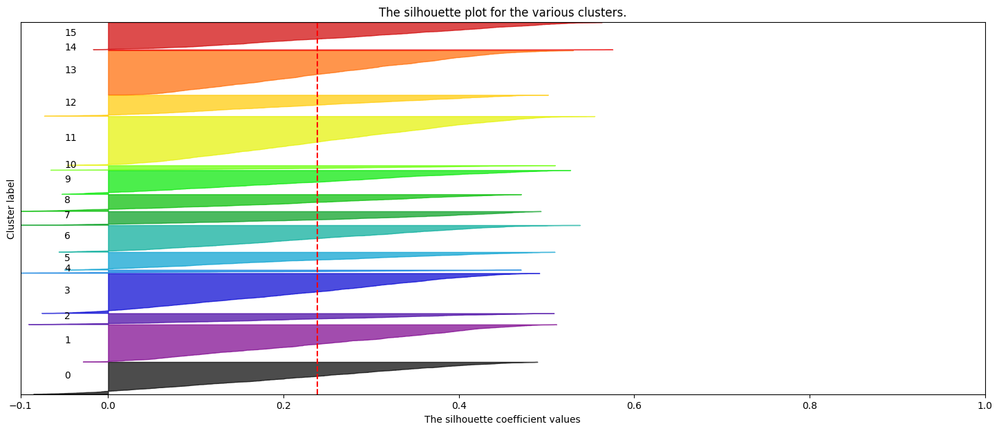

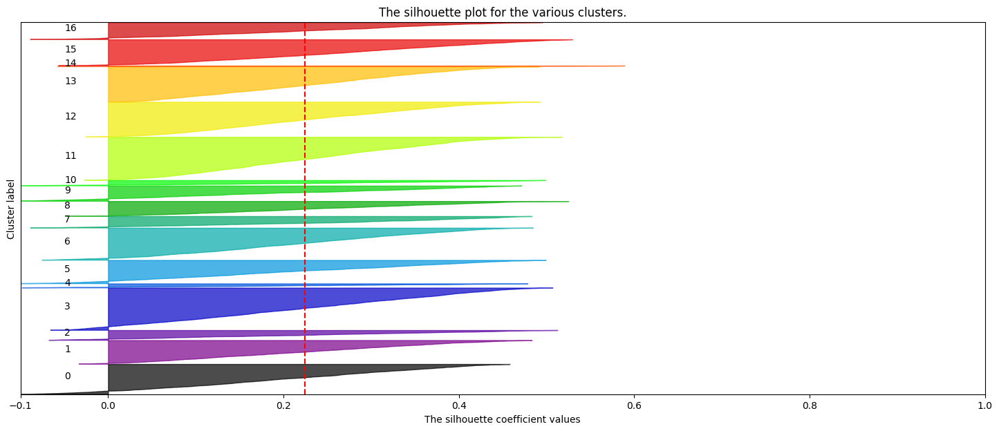

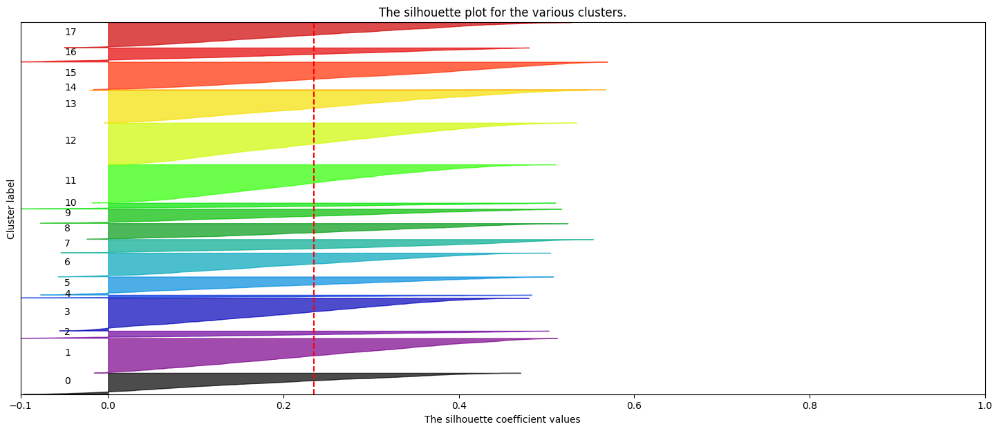

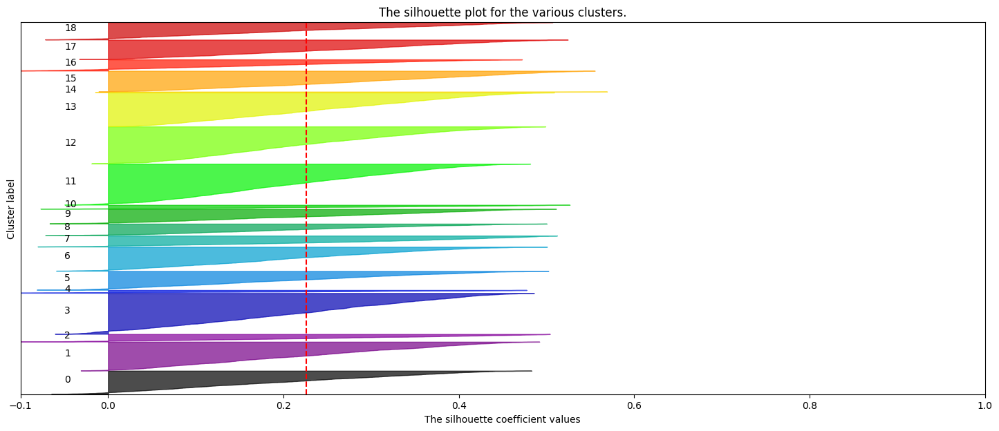

In [ ]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score

import cv2
import os
from sklearn.cluster import KMeans
import shutil

range_n_clusters = [2, 3, 4, 5, 6, 8]

for n_clusters in range(2, 20, 1):
    # Create a subplot with 1 row and 2 columns
    fig, ax1  = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(PCA_X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=10)
    cluster_labels = clusterer.fit_predict(PCA_X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(PCA_X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(PCA_X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])


In [ ]:


# define the number of clusters
CLUSTERS = 7
for cluster in range(0, CLUSTERS+1):
  isExist = os.path.exists(f"/content/{cluster}")
  if not isExist:
   # Create a new directory because it does not exist
   os.makedirs(f"/content/{cluster}")
   print("The new directory is created!")
  else:
    shutil.rmtree(f"/content/{cluster}")
    os.makedirs(f"/content/{cluster}")

from sklearn.cluster import MeanShift
from sklearn.cluster import SpectralClustering
from sklearn.cluster import BisectingKMeans
# Perform DBSCAN clustering
dbscan = KMeans(n_clusters=CLUSTERS)
# dbscan = KMeans(n_clusters=CLUSTERS, n_init="auto", random_state=10)
labels = dbscan.fit_predict(PCA_X)

# Print the cluster labels for each image
for i, label in enumerate(labels):
    # print(f'/content/{label}/{paths[i].split("/content/cropped_imgs/")[-1]}')
    shutil.copyfile(paths[i], f'/content/{label}/{paths[i].split("/content/cropped_imgs/")[-1]}')

    # print(f'Image {i+1}: Cluster {label}')

The new directory is created!
The new directory is created!


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


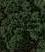

/content/0/-33.77204462165503_-33.77204462165503.png_38.jpg


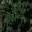

/content/0/-33.97967636751759_-33.97967636751759.png_33.jpg


/content/0/-33.871224772051164_-33.871224772051164.png_20.jpg


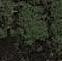

/content/0/-33.907999319522006_-33.907999319522006.png_0.jpg


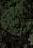

/content/0/-33.788032863260284_-33.788032863260284.png_45.jpg


/content/0/-33.7955739455384_-33.7955739455384.png_67.jpg


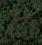

/content/0/-33.774165569919646_-33.774165569919646.png_53.jpg


/content/0/-33.84853343930616_-33.84853343930616.png_53.jpg


/content/0/-33.91009452175608_-33.91009452175608.png_6.jpg


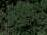

/content/0/-33.79322352844539_-33.79322352844539.png_49.jpg


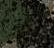

/content/0/-33.832925114904555_-33.832925114904555.png_16.jpg


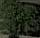

/content/0/-33.78678367009111_-33.78678367009111.png_2.jpg


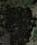

/content/0/-33.82056930704311_-33.82056930704311.png_14.jpg


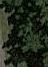

/content/0/-33.91009452175608_-33.91009452175608.png_5.jpg


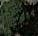

/content/0/-33.806128795098715_-33.806128795098715.png_30.jpg


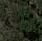

/content/0/-33.79430777628854_-33.79430777628854.png_61.jpg


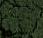

/content/0/-33.913442328940405_-33.913442328940405.png_32.jpg


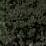

/content/0/-33.7881458629625_-33.7881458629625.png_33.jpg


/content/0/-33.96945427970518_-33.96945427970518.png_12.jpg


/content/0/-33.850237130332886_-33.850237130332886.png_28.jpg


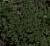

/content/0/-33.92576753521442_-33.92576753521442.png_32.jpg


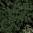

/content/0/-33.79430777628854_-33.79430777628854.png_57.jpg


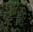

/content/0/-33.788032863260284_-33.788032863260284.png_51.jpg


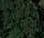

/content/0/-33.84853343930616_-33.84853343930616.png_18.jpg


/content/0/-33.974194456550094_-33.974194456550094.png_4.jpg


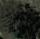

/content/0/-33.84853343930616_-33.84853343930616.png_8.jpg


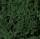

/content/0/-33.774165569919646_-33.774165569919646.png_72.jpg


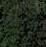

/content/0/-33.98307019138977_-33.98307019138977.png_23.jpg


/content/0/-33.885429100221394_-33.885429100221394.png_51.jpg


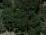

/content/0/-33.7955739455384_-33.7955739455384.png_96.jpg


/content/0/-33.814151436279346_-33.814151436279346.png_33.jpg


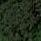

/content/0/-33.774165569919646_-33.774165569919646.png_2.jpg


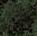

/content/0/-33.78806372685979_-33.78806372685979.png_49.jpg


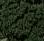

/content/0/-33.98227477040155_-33.98227477040155.png_25.jpg


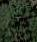

/content/0/-33.963115096736395_-33.963115096736395.png_27.jpg


/content/0/-33.98426459454405_-33.98426459454405.png_32.jpg


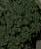

/content/0/-33.97129065781866_-33.97129065781866.png_24.jpg


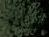

/content/0/-33.885429100221394_-33.885429100221394.png_33.jpg


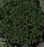

/content/0/-33.82837173183682_-33.82837173183682.png_0.jpg


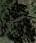

/content/0/-33.83165446563834_-33.83165446563834.png_45.jpg


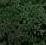

/content/0/-33.7955739455384_-33.7955739455384.png_40.jpg


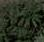

/content/0/-33.88085846895865_-33.88085846895865.png_15.jpg


/content/0/-33.85983197197308_-33.85983197197308.png_27.jpg


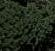

/content/0/-33.85691993785866_-33.85691993785866.png_33.jpg


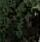

/content/0/-33.80961749654923_-33.80961749654923.png_48.jpg


/content/0/-33.82118835175123_-33.82118835175123.png_17.jpg


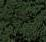

/content/0/-34.0440596679214_-34.0440596679214.png_5.jpg


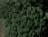

/content/0/-33.885429100221394_-33.885429100221394.png_22.jpg


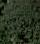

/content/0/-33.96945427970518_-33.96945427970518.png_54.jpg


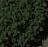

/content/0/-33.801540682301976_-33.801540682301976.png_26.jpg


/content/0/-33.79322352844539_-33.79322352844539.png_47.jpg


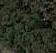

/content/0/-33.80897473791712_-33.80897473791712.png_49.jpg


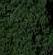

/content/0/-33.98307019138977_-33.98307019138977.png_71.jpg


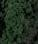

/content/0/-33.84853343930616_-33.84853343930616.png_65.jpg


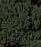

/content/0/-33.953786645084264_-33.953786645084264.png_30.jpg


/content/0/-33.87253660257565_-33.87253660257565.png_10.jpg


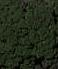

/content/0/-33.974519737480996_-33.974519737480996.png_32.jpg


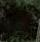

/content/0/-33.874052809962926_-33.874052809962926.png_9.jpg


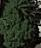

/content/0/-33.80961749654923_-33.80961749654923.png_11.jpg


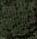

/content/0/-33.91878005615652_-33.91878005615652.png_7.jpg


/content/0/-33.77977499635599_-33.77977499635599.png_15.jpg


/content/0/-33.814392643509336_-33.814392643509336.png_26.jpg


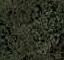

/content/0/-33.775954322152806_-33.775954322152806.png_69.jpg


/content/0/-33.97967636751759_-33.97967636751759.png_39.jpg


/content/0/-33.78678367009111_-33.78678367009111.png_47.jpg


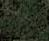

/content/0/-33.80897473791712_-33.80897473791712.png_25.jpg


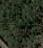

/content/0/-33.8212759735773_-33.8212759735773.png_49.jpg


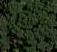

/content/0/-33.913677185520605_-33.913677185520605.png_10.jpg


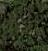

/content/0/-33.90670084469867_-33.90670084469867.png_40.jpg


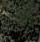

/content/0/-33.85944570496735_-33.85944570496735.png_14.jpg


/content/0/-33.7955739455384_-33.7955739455384.png_75.jpg


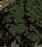

/content/0/-33.933507613786325_-33.933507613786325.png_37.jpg


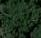

/content/0/-33.84853343930616_-33.84853343930616.png_33.jpg


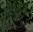

/content/0/-33.81343619258548_-33.81343619258548.png_30.jpg


/content/0/-33.874052809962926_-33.874052809962926.png_19.jpg


/content/0/-33.98307019138977_-33.98307019138977.png_3.jpg


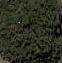

/content/0/-33.96962042303279_-33.96962042303279.png_4.jpg


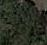

/content/0/-33.80897473791712_-33.80897473791712.png_19.jpg


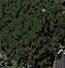

/content/0/-33.80210418723449_-33.80210418723449.png_12.jpg


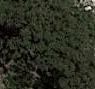

/content/0/-33.79817694475697_-33.79817694475697.png_21.jpg


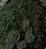

/content/0/-33.87926189595346_-33.87926189595346.png_4.jpg


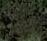

/content/0/-33.775954322152806_-33.775954322152806.png_20.jpg


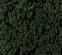

/content/0/-33.98307019138977_-33.98307019138977.png_21.jpg


/content/0/-33.7955739455384_-33.7955739455384.png_36.jpg


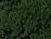

/content/0/-33.98307019138977_-33.98307019138977.png_60.jpg


/content/0/-33.91764819497187_-33.91764819497187.png_9.jpg


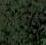

/content/0/-33.775954322152806_-33.775954322152806.png_49.jpg


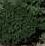

/content/0/-33.87822243684813_-33.87822243684813.png_3.jpg


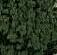

/content/0/-33.91009452175608_-33.91009452175608.png_1.jpg


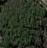

/content/0/-33.80434688824013_-33.80434688824013.png_3.jpg


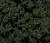

/content/0/-33.7955739455384_-33.7955739455384.png_54.jpg


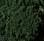

/content/0/-33.885429100221394_-33.885429100221394.png_18.jpg


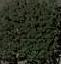

/content/0/-33.97706397086192_-33.97706397086192.png_1.jpg


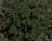

/content/0/-33.92694526074041_-33.92694526074041.png_24.jpg


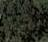

/content/0/-33.80897473791712_-33.80897473791712.png_1.jpg


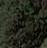

/content/0/-33.874052809962926_-33.874052809962926.png_4.jpg


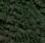

/content/0/-33.8325839537181_-33.8325839537181.png_53.jpg


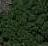

/content/0/-34.0440596679214_-34.0440596679214.png_14.jpg


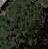

/content/0/-33.815228034100684_-33.815228034100684.png_22.jpg


/content/0/-33.78678367009111_-33.78678367009111.png_52.jpg
----------------------------------------------------------


/content/1/-33.94033248385097_-33.94033248385097.png_14.jpg


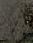

/content/1/-33.77204462165503_-33.77204462165503.png_47.jpg


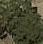

/content/1/-33.93438224536404_-33.93438224536404.png_16.jpg


/content/1/-33.79430777628854_-33.79430777628854.png_38.jpg


/content/1/-33.82056930704311_-33.82056930704311.png_21.jpg


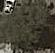

/content/1/-33.920782491181214_-33.920782491181214.png_1.jpg


/content/1/-33.923457904763616_-33.923457904763616.png_4.jpg


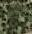

/content/1/-33.93344605814121_-33.93344605814121.png_8.jpg


/content/1/-33.95878736899063_-33.95878736899063.png_31.jpg


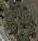

/content/1/-33.90512699972322_-33.90512699972322.png_24.jpg


/content/1/-33.95756873295237_-33.95756873295237.png_22.jpg


/content/1/-33.85983197197308_-33.85983197197308.png_20.jpg


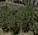

/content/1/-33.92331560899621_-33.92331560899621.png_5.jpg


/content/1/-33.91620426519703_-33.91620426519703.png_10.jpg


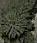

/content/1/-33.96450327978131_-33.96450327978131.png_11.jpg


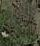

/content/1/-34.052161107551896_-34.052161107551896.png_20.jpg


/content/1/-33.91648710827274_-33.91648710827274.png_17.jpg


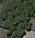

/content/1/-33.79695769009388_-33.79695769009388.png_41.jpg


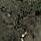

/content/1/-33.97129065781866_-33.97129065781866.png_47.jpg


/content/1/-33.94033248385097_-33.94033248385097.png_18.jpg


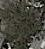

/content/1/-33.81701022985311_-33.81701022985311.png_2.jpg


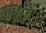

/content/1/-33.92618723253119_-33.92618723253119.png_40.jpg


/content/1/-33.8160489739298_-33.8160489739298.png_26.jpg


/content/1/-33.801540682301976_-33.801540682301976.png_55.jpg


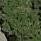

/content/1/-33.91726446346118_-33.91726446346118.png_29.jpg


/content/1/-33.89883210872744_-33.89883210872744.png_25.jpg


/content/1/-33.77492858950917_-33.77492858950917.png_33.jpg


/content/1/-33.84048150405653_-33.84048150405653.png_1.jpg


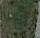

/content/1/-33.84190386970322_-33.84190386970322.png_7.jpg


/content/1/-33.869835193560625_-33.869835193560625.png_33.jpg


/content/1/-33.93776596070898_-33.93776596070898.png_17.jpg


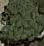

/content/1/-34.05318631603975_-34.05318631603975.png_6.jpg


/content/1/-33.836534872987535_-33.836534872987535.png_25.jpg


/content/1/-33.92618723253119_-33.92618723253119.png_3.jpg


/content/1/-33.93014447793407_-33.93014447793407.png_18.jpg


/content/1/-33.90512699972322_-33.90512699972322.png_14.jpg


/content/1/-33.85983197197308_-33.85983197197308.png_15.jpg


/content/1/-34.052161107551896_-34.052161107551896.png_40.jpg


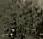

/content/1/-33.91764819497187_-33.91764819497187.png_20.jpg


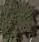

/content/1/-33.91451801809517_-33.91451801809517.png_4.jpg


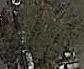

/content/1/-33.94267835983631_-33.94267835983631.png_8.jpg


/content/1/-33.95357695863401_-33.95357695863401.png_22.jpg


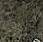

/content/1/-33.90852808789343_-33.90852808789343.png_28.jpg


/content/1/-33.92046249320792_-33.92046249320792.png_45.jpg


/content/1/-33.81202107135806_-33.81202107135806.png_23.jpg


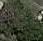

/content/1/-33.81580975244062_-33.81580975244062.png_11.jpg


/content/1/-33.87562817357351_-33.87562817357351.png_20.jpg


/content/1/-33.78970910055953_-33.78970910055953.png_18.jpg


/content/1/-33.94416286870672_-33.94416286870672.png_33.jpg


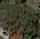

/content/1/-33.9263666090922_-33.9263666090922.png_9.jpg


/content/1/-33.94267835983631_-33.94267835983631.png_12.jpg


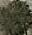

/content/1/-33.927302970054036_-33.927302970054036.png_8.jpg


/content/1/-33.91425867323046_-33.91425867323046.png_10.jpg


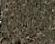

/content/1/-34.0298124476484_-34.0298124476484.png_18.jpg


/content/1/-34.04593504687838_-34.04593504687838.png_8.jpg


/content/1/-33.87300739454285_-33.87300739454285.png_10.jpg


/content/1/-33.84622378450602_-33.84622378450602.png_17.jpg


/content/1/-33.971092645268094_-33.971092645268094.png_42.jpg


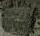

/content/1/-33.8498281900632_-33.8498281900632.png_6.jpg


/content/1/-33.81202107135806_-33.81202107135806.png_19.jpg


/content/1/-33.86610095798211_-33.86610095798211.png_12.jpg


/content/1/-33.96962042303279_-33.96962042303279.png_32.jpg


/content/1/-33.91451801809517_-33.91451801809517.png_38.jpg


/content/1/-34.03679052087878_-34.03679052087878.png_40.jpg


/content/1/-33.92331560899621_-33.92331560899621.png_33.jpg


/content/1/-33.825333518804094_-33.825333518804094.png_5.jpg


/content/1/-33.91548187886308_-33.91548187886308.png_39.jpg


/content/1/-33.80708499429534_-33.80708499429534.png_32.jpg


/content/1/-33.91486340803538_-33.91486340803538.png_17.jpg


/content/1/-33.98290397036044_-33.98290397036044.png_29.jpg


/content/1/-33.91548187886308_-33.91548187886308.png_43.jpg


/content/1/-33.97129065781866_-33.97129065781866.png_40.jpg


/content/1/-33.851650482016794_-33.851650482016794.png_8.jpg


/content/1/-34.06008965076173_-34.06008965076173.png_45.jpg


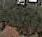

/content/1/-33.85315308182898_-33.85315308182898.png_8.jpg


/content/1/-33.933507613786325_-33.933507613786325.png_44.jpg


/content/1/-33.95730273942797_-33.95730273942797.png_21.jpg


/content/1/-34.03892137271019_-34.03892137271019.png_13.jpg


/content/1/-34.033365017731036_-34.033365017731036.png_19.jpg


/content/1/-33.93966677012558_-33.93966677012558.png_30.jpg


/content/1/-33.77254901554439_-33.77254901554439.png_17.jpg


/content/1/-33.851650482016794_-33.851650482016794.png_19.jpg


/content/1/-33.869835193560625_-33.869835193560625.png_43.jpg


/content/1/-33.815933365037566_-33.815933365037566.png_7.jpg


/content/1/-33.91967731095415_-33.91967731095415.png_10.jpg


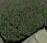

/content/1/-33.96450327978131_-33.96450327978131.png_3.jpg


/content/1/-33.911848888469066_-33.911848888469066.png_8.jpg


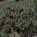

/content/1/-33.777723454967415_-33.777723454967415.png_17.jpg


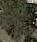

/content/1/-33.92071770130151_-33.92071770130151.png_10.jpg


/content/1/-33.90741360262161_-33.90741360262161.png_11.jpg


/content/1/-33.93014447793407_-33.93014447793407.png_9.jpg


/content/1/-33.784437582794766_-33.784437582794766.png_28.jpg


/content/1/-33.906403962007815_-33.906403962007815.png_16.jpg


/content/1/-33.83165446563834_-33.83165446563834.png_37.jpg


/content/1/-33.923457904763616_-33.923457904763616.png_11.jpg


/content/1/-33.851650482016794_-33.851650482016794.png_23.jpg


/content/1/-33.80556648530902_-33.80556648530902.png_17.jpg


/content/1/-33.77254901554439_-33.77254901554439.png_5.jpg


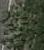

/content/1/-33.874052809962926_-33.874052809962926.png_33.jpg


/content/1/-33.91739223176836_-33.91739223176836.png_8.jpg
----------------------------------------------------------


/content/2/-33.953786645084264_-33.953786645084264.png_21.jpg


/content/2/-33.93683627031715_-33.93683627031715.png_36.jpg


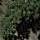

/content/2/-33.78194039624411_-33.78194039624411.png_18.jpg


/content/2/-33.9575494508767_-33.9575494508767.png_39.jpg


/content/2/-33.787565523132514_-33.787565523132514.png_42.jpg


/content/2/-33.95990692866725_-33.95990692866725.png_11.jpg


/content/2/-34.04593504687838_-34.04593504687838.png_23.jpg


/content/2/-33.80600584864532_-33.80600584864532.png_29.jpg


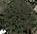

/content/2/-33.81580975244062_-33.81580975244062.png_21.jpg


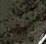

/content/2/-33.91486340803538_-33.91486340803538.png_20.jpg


/content/2/-33.975845671303446_-33.975845671303446.png_9.jpg


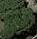

/content/2/-33.96918503792231_-33.96918503792231.png_43.jpg


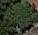

/content/2/-34.042055294949535_-34.042055294949535.png_33.jpg


/content/2/-33.92332292543133_-33.92332292543133.png_44.jpg


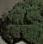

/content/2/-33.90656389648789_-33.90656389648789.png_11.jpg


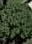

/content/2/-33.97764280851468_-33.97764280851468.png_9.jpg


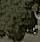

/content/2/-33.92332292543133_-33.92332292543133.png_52.jpg


/content/2/-33.80556648530902_-33.80556648530902.png_28.jpg


/content/2/-33.92694526074041_-33.92694526074041.png_41.jpg


/content/2/-33.92576753521442_-33.92576753521442.png_43.jpg


/content/2/-33.79762945747859_-33.79762945747859.png_47.jpg


/content/2/-33.91525916281142_-33.91525916281142.png_37.jpg


/content/2/-33.97213629614094_-33.97213629614094.png_30.jpg


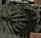

/content/2/-33.86610095798211_-33.86610095798211.png_1.jpg


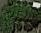

/content/2/-34.03892137271019_-34.03892137271019.png_38.jpg


/content/2/-34.04817756328939_-34.04817756328939.png_56.jpg


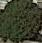

/content/2/-33.92049321986321_-33.92049321986321.png_0.jpg


/content/2/-33.82118835175123_-33.82118835175123.png_19.jpg


/content/2/-33.975845671303446_-33.975845671303446.png_31.jpg


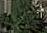

/content/2/-33.77724822236651_-33.77724822236651.png_16.jpg


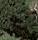

/content/2/-34.04681512996399_-34.04681512996399.png_31.jpg


/content/2/-33.87196721013416_-33.87196721013416.png_19.jpg


/content/2/-33.920799165386775_-33.920799165386775.png_13.jpg


/content/2/-33.92560102690655_-33.92560102690655.png_23.jpg


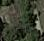

/content/2/-33.788032863260284_-33.788032863260284.png_57.jpg


/content/2/-33.96817463428106_-33.96817463428106.png_7.jpg


/content/2/-33.86183877621924_-33.86183877621924.png_13.jpg


/content/2/-33.92368054565189_-33.92368054565189.png_15.jpg


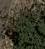

/content/2/-33.92973887689588_-33.92973887689588.png_50.jpg


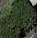

/content/2/-33.95443963473776_-33.95443963473776.png_25.jpg


/content/2/-33.80708499429534_-33.80708499429534.png_28.jpg


/content/2/-33.906403962007815_-33.906403962007815.png_30.jpg


/content/2/-33.801540682301976_-33.801540682301976.png_56.jpg


/content/2/-33.86563381644105_-33.86563381644105.png_24.jpg


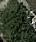

/content/2/-33.96945427970518_-33.96945427970518.png_26.jpg


/content/2/-33.94005519354731_-33.94005519354731.png_19.jpg


/content/2/-33.91108624210735_-33.91108624210735.png_41.jpg


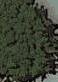

/content/2/-33.91620426519703_-33.91620426519703.png_3.jpg


/content/2/-33.80254487949665_-33.80254487949665.png_12.jpg


/content/2/-33.93776421036587_-33.93776421036587.png_24.jpg


/content/2/-33.96238064294552_-33.96238064294552.png_23.jpg


/content/2/-33.784795244929164_-33.784795244929164.png_18.jpg


/content/2/-33.87196721013416_-33.87196721013416.png_23.jpg


/content/2/-33.91548187886308_-33.91548187886308.png_6.jpg


/content/2/-33.9366740557126_-33.9366740557126.png_37.jpg


/content/2/-33.939236698530394_-33.939236698530394.png_26.jpg


/content/2/-33.91731336912437_-33.91731336912437.png_11.jpg


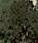

/content/2/-34.06008965076173_-34.06008965076173.png_32.jpg


/content/2/-33.97764280851468_-33.97764280851468.png_11.jpg


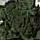

/content/2/-34.04369269887961_-34.04369269887961.png_5.jpg


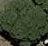

/content/2/-33.96237520251141_-33.96237520251141.png_2.jpg


/content/2/-33.96115935437024_-33.96115935437024.png_35.jpg


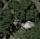

/content/2/-33.88085846895865_-33.88085846895865.png_41.jpg


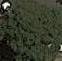

/content/2/-33.92038264565631_-33.92038264565631.png_6.jpg


/content/2/-33.810016455899316_-33.810016455899316.png_11.jpg


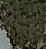

/content/2/-34.05318631603975_-34.05318631603975.png_41.jpg


/content/2/-33.87300739454285_-33.87300739454285.png_17.jpg


/content/2/-33.93398649921131_-33.93398649921131.png_16.jpg


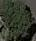

/content/2/-33.88085846895865_-33.88085846895865.png_3.jpg


/content/2/-33.801540682301976_-33.801540682301976.png_31.jpg


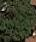

/content/2/-33.92694526074041_-33.92694526074041.png_45.jpg


/content/2/-33.80313383211838_-33.80313383211838.png_29.jpg


/content/2/-33.94267835983631_-33.94267835983631.png_22.jpg


/content/2/-33.93542647812037_-33.93542647812037.png_19.jpg


/content/2/-33.81018261141205_-33.81018261141205.png_20.jpg


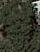

/content/2/-33.77269906651448_-33.77269906651448.png_30.jpg


/content/2/-33.91195265784434_-33.91195265784434.png_6.jpg


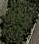

/content/2/-34.04020219188604_-34.04020219188604.png_11.jpg


/content/2/-33.871224772051164_-33.871224772051164.png_29.jpg


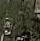

/content/2/-33.910114025966166_-33.910114025966166.png_39.jpg


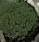

/content/2/-33.959864698007685_-33.959864698007685.png_4.jpg


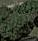

/content/2/-33.80210418723449_-33.80210418723449.png_18.jpg


/content/2/-33.80078884260376_-33.80078884260376.png_58.jpg


/content/2/-33.794766056579014_-33.794766056579014.png_30.jpg


/content/2/-33.836534872987535_-33.836534872987535.png_5.jpg


/content/2/-33.80574800633773_-33.80574800633773.png_37.jpg


/content/2/-33.77977499635599_-33.77977499635599.png_37.jpg


/content/2/-33.94407247659519_-33.94407247659519.png_33.jpg


/content/2/-33.96986870587083_-33.96986870587083.png_27.jpg


/content/2/-33.80210418723449_-33.80210418723449.png_24.jpg


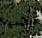

/content/2/-33.982574284665546_-33.982574284665546.png_25.jpg


/content/2/-33.83165446563834_-33.83165446563834.png_39.jpg


/content/2/-33.85829219782105_-33.85829219782105.png_34.jpg


/content/2/-33.95357695863401_-33.95357695863401.png_35.jpg


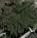

/content/2/-33.96115935437024_-33.96115935437024.png_7.jpg


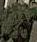

/content/2/-33.91764819497187_-33.91764819497187.png_33.jpg


/content/2/-33.98214638453072_-33.98214638453072.png_12.jpg


/content/2/-33.793517987148654_-33.793517987148654.png_27.jpg


/content/2/-33.79272203041733_-33.79272203041733.png_31.jpg


/content/2/-33.80556648530902_-33.80556648530902.png_40.jpg
----------------------------------------------------------


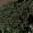

/content/3/-33.96945427970518_-33.96945427970518.png_30.jpg


/content/3/-34.029531837170616_-34.029531837170616.png_37.jpg


/content/3/-33.91819448180171_-33.91819448180171.png_37.jpg


/content/3/-33.8613226347493_-33.8613226347493.png_12.jpg


/content/3/-33.80078884260376_-33.80078884260376.png_41.jpg


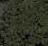

/content/3/-33.97039676265393_-33.97039676265393.png_27.jpg


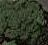

/content/3/-33.815228034100684_-33.815228034100684.png_2.jpg


/content/3/-33.77977499635599_-33.77977499635599.png_16.jpg


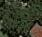

/content/3/-33.80708499429534_-33.80708499429534.png_11.jpg


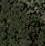

/content/3/-34.04593504687838_-34.04593504687838.png_28.jpg


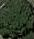

/content/3/-33.88085846895865_-33.88085846895865.png_9.jpg


/content/3/-33.90670084469867_-33.90670084469867.png_53.jpg


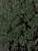

/content/3/-33.844230871244505_-33.844230871244505.png_14.jpg


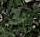

/content/3/-33.95443963473776_-33.95443963473776.png_21.jpg


/content/3/-33.806128795098715_-33.806128795098715.png_44.jpg


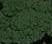

/content/3/-33.7955739455384_-33.7955739455384.png_22.jpg


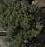

/content/3/-33.77724822236651_-33.77724822236651.png_1.jpg


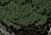

/content/3/-33.96450327978131_-33.96450327978131.png_24.jpg


/content/3/-33.96120952005672_-33.96120952005672.png_10.jpg


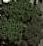

/content/3/-33.907249116719_-33.907249116719.png_12.jpg


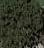

/content/3/-33.98023245961893_-33.98023245961893.png_6.jpg


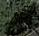

/content/3/-33.96945427970518_-33.96945427970518.png_35.jpg


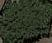

/content/3/-33.78173763699905_-33.78173763699905.png_4.jpg


/content/3/-33.78132830284324_-33.78132830284324.png_29.jpg


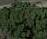

/content/3/-33.77204462165503_-33.77204462165503.png_10.jpg


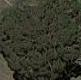

/content/3/-33.80780351329181_-33.80780351329181.png_5.jpg


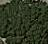

/content/3/-33.91764819497187_-33.91764819497187.png_34.jpg


/content/3/-33.954820329262276_-33.954820329262276.png_13.jpg


/content/3/-33.80434688824013_-33.80434688824013.png_20.jpg


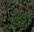

/content/3/-33.81154006507382_-33.81154006507382.png_51.jpg


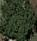

/content/3/-33.81154006507382_-33.81154006507382.png_4.jpg


/content/3/-33.96846285336229_-33.96846285336229.png_60.jpg


/content/3/-33.9366740557126_-33.9366740557126.png_36.jpg


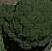

/content/3/-33.954820329262276_-33.954820329262276.png_6.jpg


/content/3/-33.88085846895865_-33.88085846895865.png_12.jpg


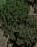

/content/3/-33.93683627031715_-33.93683627031715.png_22.jpg


/content/3/-33.91819448180171_-33.91819448180171.png_9.jpg


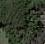

/content/3/-33.88085846895865_-33.88085846895865.png_18.jpg


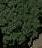

/content/3/-33.80975403857292_-33.80975403857292.png_20.jpg


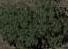

/content/3/-33.85829219782105_-33.85829219782105.png_26.jpg


/content/3/-33.80078884260376_-33.80078884260376.png_40.jpg


/content/3/-33.80434688824013_-33.80434688824013.png_41.jpg


/content/3/-33.9296348024509_-33.9296348024509.png_36.jpg


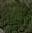

/content/3/-33.91046417030443_-33.91046417030443.png_26.jpg


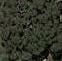

/content/3/-33.79762945747859_-33.79762945747859.png_8.jpg


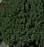

/content/3/-33.97976692907611_-33.97976692907611.png_18.jpg


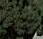

/content/3/-33.98227477040155_-33.98227477040155.png_10.jpg


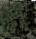

/content/3/-33.82033271330875_-33.82033271330875.png_5.jpg


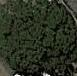

/content/3/-33.98023245961893_-33.98023245961893.png_5.jpg


/content/3/-33.80780351329181_-33.80780351329181.png_37.jpg


/content/3/-33.7881458629625_-33.7881458629625.png_46.jpg


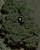

/content/3/-33.97039676265393_-33.97039676265393.png_8.jpg


/content/3/-33.92046249320792_-33.92046249320792.png_36.jpg


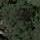

/content/3/-33.8212759735773_-33.8212759735773.png_31.jpg


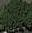

/content/3/-33.79762945747859_-33.79762945747859.png_12.jpg


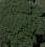

/content/3/-33.80975403857292_-33.80975403857292.png_27.jpg


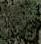

/content/3/-33.77487029262844_-33.77487029262844.png_17.jpg


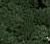

/content/3/-33.87061809048001_-33.87061809048001.png_39.jpg


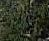

/content/3/-34.05975652023457_-34.05975652023457.png_9.jpg


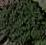

/content/3/-33.79689066318984_-33.79689066318984.png_10.jpg


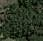

/content/3/-33.79127565817694_-33.79127565817694.png_40.jpg


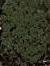

/content/3/-34.06008965076173_-34.06008965076173.png_3.jpg


/content/3/-33.97833800804419_-33.97833800804419.png_12.jpg


/content/3/-33.907999319522006_-33.907999319522006.png_9.jpg


/content/3/-33.850237130332886_-33.850237130332886.png_15.jpg


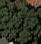

/content/3/-33.974519737480996_-33.974519737480996.png_8.jpg


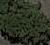

/content/3/-33.96726413276078_-33.96726413276078.png_6.jpg


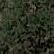

/content/3/-33.775954322152806_-33.775954322152806.png_5.jpg


/content/3/-33.80384444476587_-33.80384444476587.png_28.jpg


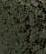

/content/3/-33.78132830284324_-33.78132830284324.png_13.jpg


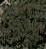

/content/3/-33.98265810117472_-33.98265810117472.png_17.jpg


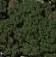

/content/3/-33.90670084469867_-33.90670084469867.png_49.jpg


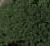

/content/3/-33.77204462165503_-33.77204462165503.png_18.jpg


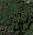

/content/3/-33.81154006507382_-33.81154006507382.png_28.jpg


/content/3/-33.922329744499066_-33.922329744499066.png_13.jpg


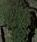

/content/3/-33.87196721013416_-33.87196721013416.png_12.jpg


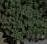

/content/3/-33.79341073135254_-33.79341073135254.png_22.jpg


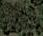

/content/3/-33.98227477040155_-33.98227477040155.png_18.jpg


/content/3/-33.87061809048001_-33.87061809048001.png_15.jpg


/content/3/-33.93542647812037_-33.93542647812037.png_28.jpg


/content/3/-33.95730273942797_-33.95730273942797.png_23.jpg


/content/3/-33.87211758287329_-33.87211758287329.png_34.jpg


/content/3/-33.86183877621924_-33.86183877621924.png_28.jpg


/content/3/-33.80434688824013_-33.80434688824013.png_34.jpg


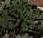

/content/3/-33.939236698530394_-33.939236698530394.png_10.jpg


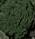

/content/3/-33.88085846895865_-33.88085846895865.png_8.jpg


/content/3/-33.81535115206846_-33.81535115206846.png_21.jpg


/content/3/-33.80780351329181_-33.80780351329181.png_42.jpg


/content/3/-33.87196721013416_-33.87196721013416.png_26.jpg


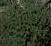

/content/3/-33.97833800804419_-33.97833800804419.png_32.jpg


/content/3/-33.77269906651448_-33.77269906651448.png_39.jpg


/content/3/-33.8125603368135_-33.8125603368135.png_20.jpg


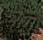

/content/3/-33.78806372685979_-33.78806372685979.png_3.jpg


/content/3/-33.95725723524588_-33.95725723524588.png_19.jpg


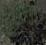

/content/3/-33.844230871244505_-33.844230871244505.png_5.jpg


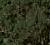

/content/3/-33.91747611903886_-33.91747611903886.png_30.jpg


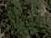

/content/3/-33.94218620359492_-33.94218620359492.png_11.jpg


/content/3/-33.77269906651448_-33.77269906651448.png_14.jpg


/content/3/-34.04020219188604_-34.04020219188604.png_22.jpg


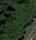

/content/3/-33.8325839537181_-33.8325839537181.png_44.jpg
----------------------------------------------------------


/content/4/-33.805987357059614_-33.805987357059614.png_52.jpg


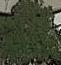

/content/4/-33.91726446346118_-33.91726446346118.png_11.jpg


/content/4/-33.923457904763616_-33.923457904763616.png_5.jpg


/content/4/-33.91425867323046_-33.91425867323046.png_21.jpg


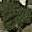

/content/4/-33.91747611903886_-33.91747611903886.png_12.jpg


/content/4/-33.97307600603625_-33.97307600603625.png_24.jpg


/content/4/-33.91895670359154_-33.91895670359154.png_8.jpg


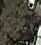

/content/4/-33.91648710827274_-33.91648710827274.png_2.jpg


/content/4/-33.94407247659519_-33.94407247659519.png_28.jpg


/content/4/-34.029531837170616_-34.029531837170616.png_51.jpg


/content/4/-33.97630530115373_-33.97630530115373.png_7.jpg


/content/4/-33.82518198306368_-33.82518198306368.png_44.jpg


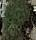

/content/4/-33.79272203041733_-33.79272203041733.png_10.jpg


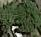

/content/4/-33.9366740557126_-33.9366740557126.png_19.jpg


/content/4/-33.85691993785866_-33.85691993785866.png_47.jpg


/content/4/-33.80600584864532_-33.80600584864532.png_27.jpg


/content/4/-33.94267835983631_-33.94267835983631.png_7.jpg


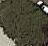

/content/4/-33.919556049674_-33.919556049674.png_0.jpg


/content/4/-33.95730273942797_-33.95730273942797.png_27.jpg


/content/4/-33.903421305902306_-33.903421305902306.png_6.jpg


/content/4/-33.79817694475697_-33.79817694475697.png_38.jpg


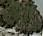

/content/4/-34.05318631603975_-34.05318631603975.png_9.jpg


/content/4/-33.920799165386775_-33.920799165386775.png_14.jpg


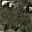

/content/4/-33.91764819497187_-33.91764819497187.png_44.jpg


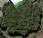

/content/4/-33.97307600603625_-33.97307600603625.png_5.jpg


/content/4/-33.955771136277015_-33.955771136277015.png_23.jpg


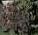

/content/4/-34.04369269887961_-34.04369269887961.png_24.jpg


/content/4/-33.93765931056981_-33.93765931056981.png_29.jpg


/content/4/-33.96399588208459_-33.96399588208459.png_16.jpg


/content/4/-33.91014460465312_-33.91014460465312.png_42.jpg


/content/4/-33.907058129708886_-33.907058129708886.png_43.jpg


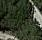

/content/4/-33.97976692907611_-33.97976692907611.png_42.jpg


/content/4/-33.920799165386775_-33.920799165386775.png_24.jpg


/content/4/-33.81580975244062_-33.81580975244062.png_26.jpg


/content/4/-33.87084139309525_-33.87084139309525.png_11.jpg


/content/4/-33.82518198306368_-33.82518198306368.png_36.jpg


/content/4/-33.97307600603625_-33.97307600603625.png_37.jpg


/content/4/-34.0298124476484_-34.0298124476484.png_16.jpg


/content/4/-33.920799165386775_-33.920799165386775.png_6.jpg


/content/4/-34.04593504687838_-34.04593504687838.png_9.jpg


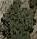

/content/4/-33.93756996531083_-33.93756996531083.png_31.jpg


/content/4/-33.906403962007815_-33.906403962007815.png_46.jpg


/content/4/-33.82355717281341_-33.82355717281341.png_30.jpg


/content/4/-33.79272203041733_-33.79272203041733.png_30.jpg


/content/4/-33.91548187886308_-33.91548187886308.png_18.jpg


/content/4/-34.03106634531281_-34.03106634531281.png_35.jpg


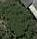

/content/4/-33.966249531009154_-33.966249531009154.png_38.jpg


/content/4/-33.920799165386775_-33.920799165386775.png_25.jpg


/content/4/-33.87971377826596_-33.87971377826596.png_11.jpg


/content/4/-33.955307049570685_-33.955307049570685.png_20.jpg


/content/4/-33.906403962007815_-33.906403962007815.png_36.jpg


/content/4/-33.96260864427253_-33.96260864427253.png_22.jpg


/content/4/-33.81018261141205_-33.81018261141205.png_27.jpg


/content/4/-33.89883210872744_-33.89883210872744.png_45.jpg


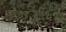

/content/4/-33.9296348024509_-33.9296348024509.png_29.jpg


/content/4/-33.97039676265393_-33.97039676265393.png_22.jpg


/content/4/-33.89883210872744_-33.89883210872744.png_13.jpg


/content/4/-33.97833800804419_-33.97833800804419.png_34.jpg


/content/4/-34.04593504687838_-34.04593504687838.png_40.jpg


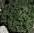

/content/4/-33.79127565817694_-33.79127565817694.png_38.jpg


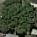

/content/4/-34.042055294949535_-34.042055294949535.png_2.jpg


/content/4/-33.80708499429534_-33.80708499429534.png_37.jpg


/content/4/-33.91747611903886_-33.91747611903886.png_8.jpg


/content/4/-33.92534958615767_-33.92534958615767.png_45.jpg


/content/4/-33.92534958615767_-33.92534958615767.png_27.jpg


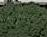

/content/4/-33.77492858950917_-33.77492858950917.png_40.jpg


/content/4/-33.89883210872744_-33.89883210872744.png_41.jpg


/content/4/-33.93966677012558_-33.93966677012558.png_14.jpg


/content/4/-34.03679052087878_-34.03679052087878.png_33.jpg


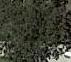

/content/4/-34.029531837170616_-34.029531837170616.png_16.jpg


/content/4/-33.92143324564951_-33.92143324564951.png_13.jpg


/content/4/-33.80526020982918_-33.80526020982918.png_22.jpg


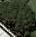

/content/4/-33.79223858531032_-33.79223858531032.png_21.jpg


/content/4/-33.95990692866725_-33.95990692866725.png_18.jpg


/content/4/-33.8498281900632_-33.8498281900632.png_8.jpg


/content/4/-33.91648710827274_-33.91648710827274.png_10.jpg


/content/4/-33.92331560899621_-33.92331560899621.png_39.jpg


/content/4/-33.86183877621924_-33.86183877621924.png_10.jpg


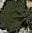

/content/4/-34.04523925003062_-34.04523925003062.png_10.jpg


/content/4/-33.91282768303347_-33.91282768303347.png_39.jpg


/content/4/-33.92071770130151_-33.92071770130151.png_37.jpg


/content/4/-33.93014447793407_-33.93014447793407.png_26.jpg


/content/4/-33.91014460465312_-33.91014460465312.png_24.jpg


/content/4/-33.911848888469066_-33.911848888469066.png_9.jpg


/content/4/-33.91048851592869_-33.91048851592869.png_4.jpg


/content/4/-33.80556648530902_-33.80556648530902.png_45.jpg


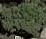

/content/4/-33.907249116719_-33.907249116719.png_2.jpg


/content/4/-33.966249531009154_-33.966249531009154.png_33.jpg


/content/4/-33.92143324564951_-33.92143324564951.png_6.jpg


/content/4/-33.84013243414026_-33.84013243414026.png_26.jpg


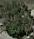

/content/4/-33.97706397086192_-33.97706397086192.png_7.jpg


/content/4/-33.83793357584756_-33.83793357584756.png_18.jpg


/content/4/-33.89883210872744_-33.89883210872744.png_30.jpg


/content/4/-33.966249531009154_-33.966249531009154.png_31.jpg


/content/4/-33.805987357059614_-33.805987357059614.png_32.jpg


/content/4/-33.77204462165503_-33.77204462165503.png_36.jpg


/content/4/-33.84219458835753_-33.84219458835753.png_9.jpg


/content/4/-33.96263274456494_-33.96263274456494.png_18.jpg


/content/4/-33.933507613786325_-33.933507613786325.png_34.jpg


/content/4/-33.87971377826596_-33.87971377826596.png_26.jpg
----------------------------------------------------------


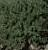

/content/5/-33.77487029262844_-33.77487029262844.png_1.jpg


/content/5/-33.93094696770984_-33.93094696770984.png_21.jpg


/content/5/-33.83612761820723_-33.83612761820723.png_2.jpg


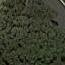

/content/5/-33.976367714598126_-33.976367714598126.png_22.jpg


/content/5/-33.97764280851468_-33.97764280851468.png_35.jpg


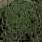

/content/5/-33.93756996531083_-33.93756996531083.png_6.jpg


/content/5/-33.794766056579014_-33.794766056579014.png_16.jpg


/content/5/-33.913442328940405_-33.913442328940405.png_14.jpg


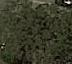

/content/5/-33.9202558610692_-33.9202558610692.png_3.jpg


/content/5/-34.03679052087878_-34.03679052087878.png_51.jpg


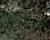

/content/5/-33.80961749654923_-33.80961749654923.png_53.jpg


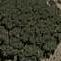

/content/5/-33.93756996531083_-33.93756996531083.png_7.jpg


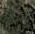

/content/5/-33.83165446563834_-33.83165446563834.png_31.jpg


/content/5/-33.78970910055953_-33.78970910055953.png_38.jpg


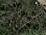

/content/5/-33.97953928679019_-33.97953928679019.png_30.jpg


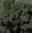

/content/5/-33.78194039624411_-33.78194039624411.png_21.jpg


/content/5/-33.814151436279346_-33.814151436279346.png_30.jpg


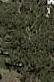

/content/5/-34.052161107551896_-34.052161107551896.png_12.jpg


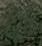

/content/5/-33.836534872987535_-33.836534872987535.png_7.jpg


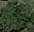

/content/5/-33.787565523132514_-33.787565523132514.png_21.jpg


/content/5/-33.91046417030443_-33.91046417030443.png_45.jpg


/content/5/-33.815228034100684_-33.815228034100684.png_32.jpg


/content/5/-33.79272203041733_-33.79272203041733.png_22.jpg


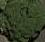

/content/5/-33.92427666005508_-33.92427666005508.png_6.jpg


/content/5/-34.04681512996399_-34.04681512996399.png_28.jpg


/content/5/-34.04681512996399_-34.04681512996399.png_55.jpg


/content/5/-33.80708499429534_-33.80708499429534.png_23.jpg


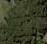

/content/5/-33.93776596070898_-33.93776596070898.png_12.jpg


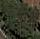

/content/5/-33.97039676265393_-33.97039676265393.png_4.jpg


/content/5/-33.79695769009388_-33.79695769009388.png_21.jpg


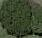

/content/5/-33.959864698007685_-33.959864698007685.png_2.jpg


/content/5/-33.87562817357351_-33.87562817357351.png_23.jpg


/content/5/-33.8212759735773_-33.8212759735773.png_27.jpg


/content/5/-33.955307049570685_-33.955307049570685.png_6.jpg


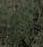

/content/5/-33.80897473791712_-33.80897473791712.png_33.jpg


/content/5/-33.77204462165503_-33.77204462165503.png_44.jpg


/content/5/-33.96115935437024_-33.96115935437024.png_27.jpg


/content/5/-33.80289295672762_-33.80289295672762.png_29.jpg


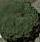

/content/5/-33.953786645084264_-33.953786645084264.png_3.jpg


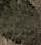

/content/5/-33.9296348024509_-33.9296348024509.png_19.jpg


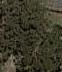

/content/5/-34.05318631603975_-34.05318631603975.png_23.jpg


/content/5/-34.03729694257993_-34.03729694257993.png_15.jpg


/content/5/-33.92694526074041_-33.92694526074041.png_63.jpg


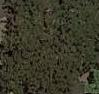

/content/5/-34.05358480877774_-34.05358480877774.png_30.jpg


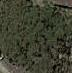

/content/5/-34.04593504687838_-34.04593504687838.png_15.jpg


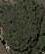

/content/5/-33.964306831909596_-33.964306831909596.png_1.jpg


/content/5/-33.81154006507382_-33.81154006507382.png_12.jpg


/content/5/-33.98405015932163_-33.98405015932163.png_19.jpg


/content/5/-33.79430777628854_-33.79430777628854.png_33.jpg


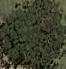

/content/5/-33.936934727662816_-33.936934727662816.png_0.jpg


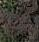

/content/5/-33.78751943395539_-33.78751943395539.png_36.jpg


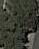

/content/5/-33.849662269805826_-33.849662269805826.png_15.jpg


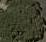

/content/5/-33.93966677012558_-33.93966677012558.png_5.jpg


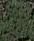

/content/5/-33.79223858531032_-33.79223858531032.png_39.jpg


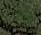

/content/5/-34.04107787348382_-34.04107787348382.png_4.jpg


/content/5/-33.91014460465312_-33.91014460465312.png_48.jpg


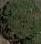

/content/5/-33.92694526074041_-33.92694526074041.png_4.jpg


/content/5/-33.91425867323046_-33.91425867323046.png_20.jpg


/content/5/-33.94218620359492_-33.94218620359492.png_8.jpg


/content/5/-33.85759089763092_-33.85759089763092.png_28.jpg


/content/5/-33.79353198378261_-33.79353198378261.png_42.jpg


/content/5/-33.784620253157534_-33.784620253157534.png_42.jpg


/content/5/-33.910114025966166_-33.910114025966166.png_38.jpg


/content/5/-33.907058129708886_-33.907058129708886.png_31.jpg


/content/5/-33.788032863260284_-33.788032863260284.png_50.jpg


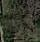

/content/5/-33.784437582794766_-33.784437582794766.png_57.jpg


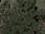

/content/5/-33.83939310108943_-33.83939310108943.png_0.jpg


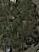

/content/5/-34.033365017731036_-34.033365017731036.png_9.jpg


/content/5/-33.79353198378261_-33.79353198378261.png_16.jpg


/content/5/-33.98401371375975_-33.98401371375975.png_20.jpg


/content/5/-33.856469553844676_-33.856469553844676.png_7.jpg


/content/5/-33.92560102690655_-33.92560102690655.png_30.jpg


/content/5/-33.956851588602134_-33.956851588602134.png_12.jpg


/content/5/-33.9575494508767_-33.9575494508767.png_27.jpg


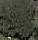

/content/5/-33.869835193560625_-33.869835193560625.png_4.jpg


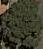

/content/5/-33.922329744499066_-33.922329744499066.png_1.jpg


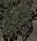

/content/5/-33.77492858950917_-33.77492858950917.png_17.jpg


/content/5/-33.80600584864532_-33.80600584864532.png_31.jpg


/content/5/-33.833338936966406_-33.833338936966406.png_15.jpg


/content/5/-34.03106634531281_-34.03106634531281.png_33.jpg


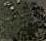

/content/5/-33.788032863260284_-33.788032863260284.png_9.jpg


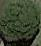

/content/5/-33.95878736899063_-33.95878736899063.png_1.jpg


/content/5/-33.776279362565866_-33.776279362565866.png_28.jpg


/content/5/-33.79320549412111_-33.79320549412111.png_26.jpg


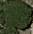

/content/5/-33.927302970054036_-33.927302970054036.png_9.jpg


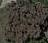

/content/5/-33.80210418723449_-33.80210418723449.png_1.jpg


/content/5/-34.056282311215185_-34.056282311215185.png_11.jpg


/content/5/-33.97396070755525_-33.97396070755525.png_15.jpg


/content/5/-33.94267835983631_-33.94267835983631.png_23.jpg


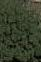

/content/5/-33.91726446346118_-33.91726446346118.png_5.jpg


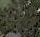

/content/5/-33.97833800804419_-33.97833800804419.png_38.jpg


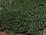

/content/5/-33.82518198306368_-33.82518198306368.png_30.jpg


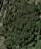

/content/5/-33.955771136277015_-33.955771136277015.png_6.jpg


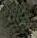

/content/5/-33.96399588208459_-33.96399588208459.png_3.jpg


/content/5/-33.813192825342746_-33.813192825342746.png_44.jpg


/content/5/-33.81202107135806_-33.81202107135806.png_29.jpg


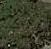

/content/5/-33.927302970054036_-33.927302970054036.png_26.jpg


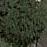

/content/5/-33.776279362565866_-33.776279362565866.png_8.jpg


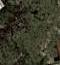

/content/5/-33.94218620359492_-33.94218620359492.png_15.jpg


/content/5/-33.80574800633773_-33.80574800633773.png_23.jpg
----------------------------------------------------------


/content/6/-33.908736509946905_-33.908736509946905.png_35.jpg


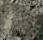

/content/6/-33.83612761820723_-33.83612761820723.png_29.jpg


/content/6/-33.98265810117472_-33.98265810117472.png_31.jpg


/content/6/-33.91680860969191_-33.91680860969191.png_7.jpg


/content/6/-33.91620426519703_-33.91620426519703.png_6.jpg


/content/6/-33.91425867323046_-33.91425867323046.png_16.jpg


/content/6/-33.936934727662816_-33.936934727662816.png_29.jpg


/content/6/-33.91236762236352_-33.91236762236352.png_3.jpg


/content/6/-33.905226167643065_-33.905226167643065.png_12.jpg


/content/6/-33.83939310108943_-33.83939310108943.png_12.jpg


/content/6/-33.97595442033598_-33.97595442033598.png_24.jpg


/content/6/-33.91680860969191_-33.91680860969191.png_11.jpg


/content/6/-34.03729694257993_-34.03729694257993.png_17.jpg


/content/6/-33.96821607101372_-33.96821607101372.png_12.jpg


/content/6/-33.96962042303279_-33.96962042303279.png_34.jpg


/content/6/-33.79637106426437_-33.79637106426437.png_15.jpg


/content/6/-33.90795006839414_-33.90795006839414.png_6.jpg


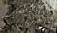

/content/6/-34.0298124476484_-34.0298124476484.png_11.jpg


/content/6/-33.81018261141205_-33.81018261141205.png_35.jpg


/content/6/-33.91282768303347_-33.91282768303347.png_41.jpg


/content/6/-33.923457904763616_-33.923457904763616.png_10.jpg


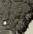

/content/6/-33.91680860969191_-33.91680860969191.png_12.jpg


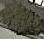

/content/6/-33.911848888469066_-33.911848888469066.png_0.jpg


/content/6/-33.90852808789343_-33.90852808789343.png_25.jpg


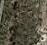

/content/6/-34.0298124476484_-34.0298124476484.png_12.jpg


/content/6/-33.78194039624411_-33.78194039624411.png_27.jpg


/content/6/-33.784620253157534_-33.784620253157534.png_49.jpg


/content/6/-33.93438224536404_-33.93438224536404.png_35.jpg


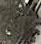

/content/6/-33.91680860969191_-33.91680860969191.png_3.jpg


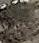

/content/6/-33.91739223176836_-33.91739223176836.png_3.jpg


/content/6/-33.91739223176836_-33.91739223176836.png_13.jpg


/content/6/-33.91150514080407_-33.91150514080407.png_15.jpg


/content/6/-33.90795006839414_-33.90795006839414.png_10.jpg


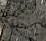

/content/6/-33.81018261141205_-33.81018261141205.png_37.jpg


/content/6/-33.917216107222565_-33.917216107222565.png_8.jpg


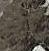

/content/6/-33.91150514080407_-33.91150514080407.png_3.jpg


/content/6/-33.93344605814121_-33.93344605814121.png_22.jpg


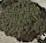

/content/6/-33.91486340803538_-33.91486340803538.png_0.jpg


/content/6/-33.92936514682347_-33.92936514682347.png_37.jpg


/content/6/-33.91047395810337_-33.91047395810337.png_7.jpg


/content/6/-33.825333518804094_-33.825333518804094.png_10.jpg


/content/6/-33.93756996531083_-33.93756996531083.png_41.jpg


/content/6/-33.865559450768586_-33.865559450768586.png_23.jpg


/content/6/-34.04523925003062_-34.04523925003062.png_38.jpg


/content/6/-33.836248484219155_-33.836248484219155.png_16.jpg


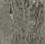

/content/6/-33.96726413276078_-33.96726413276078.png_42.jpg


/content/6/-33.96031149720626_-33.96031149720626.png_20.jpg


/content/6/-33.96962042303279_-33.96962042303279.png_26.jpg


/content/6/-34.052161107551896_-34.052161107551896.png_21.jpg


/content/6/-33.77714794282482_-33.77714794282482.png_9.jpg


/content/6/-33.80600584864532_-33.80600584864532.png_26.jpg


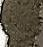

/content/6/-33.8995692183628_-33.8995692183628.png_15.jpg


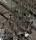

/content/6/-33.836248484219155_-33.836248484219155.png_11.jpg


/content/6/-33.92071770130151_-33.92071770130151.png_42.jpg


/content/6/-33.91425867323046_-33.91425867323046.png_26.jpg


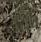

/content/6/-34.0298124476484_-34.0298124476484.png_9.jpg


/content/6/-34.028841268192146_-34.028841268192146.png_34.jpg


/content/6/-34.05318631603975_-34.05318631603975.png_37.jpg


/content/6/-33.815933365037566_-33.815933365037566.png_13.jpg


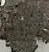

/content/6/-33.919328008694116_-33.919328008694116.png_0.jpg


/content/6/-33.82937400444684_-33.82937400444684.png_12.jpg


/content/6/-33.96031149720626_-33.96031149720626.png_31.jpg


/content/6/-33.86998999145979_-33.86998999145979.png_5.jpg


/content/6/-33.825333518804094_-33.825333518804094.png_12.jpg


/content/6/-33.91739223176836_-33.91739223176836.png_14.jpg


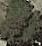

/content/6/-33.90852808789343_-33.90852808789343.png_0.jpg


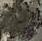

/content/6/-33.91840795152411_-33.91840795152411.png_4.jpg


/content/6/-33.91048851592869_-33.91048851592869.png_21.jpg


/content/6/-33.93542647812037_-33.93542647812037.png_26.jpg


/content/6/-33.90795006839414_-33.90795006839414.png_8.jpg


/content/6/-33.93014447793407_-33.93014447793407.png_31.jpg


/content/6/-33.91840795152411_-33.91840795152411.png_16.jpg


/content/6/-33.844230871244505_-33.844230871244505.png_41.jpg


/content/6/-33.87971377826596_-33.87971377826596.png_25.jpg


/content/6/-33.936934727662816_-33.936934727662816.png_32.jpg


/content/6/-33.836248484219155_-33.836248484219155.png_17.jpg


/content/6/-33.91451801809517_-33.91451801809517.png_20.jpg


/content/6/-33.907999319522006_-33.907999319522006.png_7.jpg


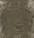

/content/6/-33.82937400444684_-33.82937400444684.png_5.jpg


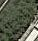

/content/6/-33.89883210872744_-33.89883210872744.png_27.jpg


/content/6/-33.90512699972322_-33.90512699972322.png_26.jpg


/content/6/-33.90852808789343_-33.90852808789343.png_20.jpg


/content/6/-33.959740945648406_-33.959740945648406.png_16.jpg


/content/6/-33.919556049674_-33.919556049674.png_19.jpg


/content/6/-33.91486340803538_-33.91486340803538.png_14.jpg


/content/6/-33.91150514080407_-33.91150514080407.png_7.jpg


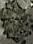

/content/6/-33.80780351329181_-33.80780351329181.png_19.jpg


/content/6/-33.77492858950917_-33.77492858950917.png_10.jpg


/content/6/-33.91739223176836_-33.91739223176836.png_6.jpg


/content/6/-34.028841268192146_-34.028841268192146.png_4.jpg


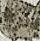

/content/6/-33.90795006839414_-33.90795006839414.png_5.jpg


/content/6/-33.91680860969191_-33.91680860969191.png_6.jpg


/content/6/-33.90807947968192_-33.90807947968192.png_25.jpg


/content/6/-33.846775344556434_-33.846775344556434.png_10.jpg


/content/6/-34.052161107551896_-34.052161107551896.png_45.jpg


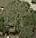

/content/6/-33.92534958615767_-33.92534958615767.png_33.jpg


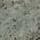

/content/6/-33.865559450768586_-33.865559450768586.png_14.jpg


/content/6/-33.8666118788447_-33.8666118788447.png_2.jpg


/content/6/-33.91451801809517_-33.91451801809517.png_15.jpg


/content/6/-33.90807947968192_-33.90807947968192.png_18.jpg
----------------------------------------------------------
----------------------------------------------------------


In [ ]:
from IPython.display import Image, display

max_each_label = 100
for i in range(0, CLUSTERS + 1):
  folder_path = f"/content/{i}/"
  current = 0
  for filename in os.listdir(folder_path):
    if current >= max_each_label:
      break
    if filename.endswith('.jpg') or filename.endswith('.png'):
      display(Image(filename=folder_path + filename))
      print(folder_path + filename)
      current += 1
  print("----------------------------------------------------------")

In [ ]:
import joblib
joblib.dump(dbscan, 'cluster.pkl')

['cluster.pkl']

### Backend Test for given image


In [ ]:
from deepforest import main
import joblib
import cv2
from keras.applications.vgg16 import VGG16
from keras.models import Model
from keras.applications.vgg16 import preprocess_input

detect_model_path = "/content/sydney_checkpoint2.pl"
cluster_model_path = "/content/cluster.pkl"
pca_path = "/content/pca.pkl"
detect_model = main.deepforest.load_from_checkpoint(detect_model_path)
cluster_model = joblib.load(cluster_model_path)
pca = joblib.load(pca_path)
rbg_image = cv2.imread("/content/stitched_image.png")

Reading config file: /usr/local/lib/python3.10/dist-packages/deepforest/data/deepforest_config.yml


Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth
100%|██████████| 130M/130M [00:00<00:00, 165MB/s]


No validation file provided. Turning off validation loop


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
def map_label_to_tree_type(label):
    # for example only
    # print(label)
    maper = {
        0 : 'Pine',
        1 : 'Pine',
        2 : 'Spruce',
        3 : 'Birch',
        4 : 'Oak',
        5 : 'Ash',
        6 : 'Maple',
        7 : 'Aspen',
        9 : 'Willow',
        10 : 'Alder',
        11 : 'Poplar',
        12 : 'Fir',
        13 : 'Cedar',
        14 : 'Hemlock',
    }
    return maper[label]

def extract_features(cropped_image, pca, target_size=(100, 100)):
    img = cv2.resize(cropped_image, target_size)
    blue_channel, green_channel, red_channel = cv2.split(img)
    mean_red = np.mean(red_channel)
    std_dev_red = np.std(red_channel)
    mean_green = np.mean(green_channel)
    std_dev_green = np.std(green_channel)
    mean_blue = np.mean(blue_channel)
    std_dev_blue = np.std(blue_channel)
    hist_red = cv2.calcHist([red_channel], [0], None, [256], [0, 256])
    hist_green = cv2.calcHist([green_channel], [0], None, [256], [0, 256])
    hist_blue = cv2.calcHist([blue_channel], [0], None, [256], [0, 256])
    hist_red = hist_red.flatten() / hist_red.sum()
    hist_green = hist_green.flatten() / hist_green.sum()
    hist_blue = hist_blue.flatten() / hist_blue.sum()
    features = np.concatenate([[mean_red, std_dev_red, mean_green, std_dev_green, mean_blue, std_dev_blue], hist_red])
    features = np.concatenate([features, hist_green])
    features = np.concatenate([features, hist_blue])
    return pca.transform(features.reshape(1, -1))

def predict(bgr_image):
        pred = detect_model.predict_tile(image = bgr_image, return_plot = False, patch_size=700,patch_overlap=0.3)
        trees = []
        if pred is None:
            return trees
        pred['width'] = pred['xmax'] - pred['xmin']
        pred['height'] = pred['ymax'] - pred['ymin']
        pred = pred[~((pred['width'] > pred['height'] * 2) | (pred['width'] * 2 < pred['height']))]
        for index, row in pred.iterrows():
            xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
            # crop the image using the bounding box
            cropped_image = bgr_image[int(ymin):int(ymax), int(xmin):int(xmax)]
            feature = extract_features(cropped_image, pca)
            label = cluster_model.predict(feature)[0]
            tree = {
                'seq_number' : index,
                'position' : {'x' : np.average([row['xmin'], row['xmax']]), 'y' : np.average([row['ymin'], row['ymax']])},
                'size' : {'width': row['xmax'] - row['xmin'], 'height': row['ymax'] - row['ymin']},
                'model_type' : map_label_to_tree_type(label)
            }
            trees.append(tree)
        print(len(trees), "trees ")
        return trees

In [ ]:
predict(rbg_image)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=1` in the `DataLoader` to improve performance.


Predicting: |          | 0/? [00:00<?, ?it/s]

1814 predictions in overlapping windows, applying non-max supression
936 predictions kept after non-max suppression
921 trees 


[{'seq_number': 0,
  'position': {'x': 1502.0, 'y': 641.0},
  'size': {'width': 60.0, 'height': 56.0},
  'model_type': 'Birch'},
 {'seq_number': 1,
  'position': {'x': 2285.0, 'y': 647.5},
  'size': {'width': 46.0, 'height': 45.0},
  'model_type': 'Birch'},
 {'seq_number': 2,
  'position': {'x': 1981.5, 'y': 120.5},
  'size': {'width': 53.0, 'height': 53.0},
  'model_type': 'Spruce'},
 {'seq_number': 3,
  'position': {'x': 3260.5, 'y': 720.0},
  'size': {'width': 55.0, 'height': 52.0},
  'model_type': 'Ash'},
 {'seq_number': 4,
  'position': {'x': 2180.5, 'y': 2451.0},
  'size': {'width': 53.0, 'height': 52.0},
  'model_type': 'Birch'},
 {'seq_number': 5,
  'position': {'x': 1779.0, 'y': 678.0},
  'size': {'width': 56.0, 'height': 44.0},
  'model_type': 'Spruce'},
 {'seq_number': 6,
  'position': {'x': 2326.5, 'y': 593.0},
  'size': {'width': 49.0, 'height': 50.0},
  'model_type': 'Spruce'},
 {'seq_number': 7,
  'position': {'x': 329.0, 'y': 546.5},
  'size': {'width': 50.0, 'height': 

## CNN + PCA + KMEANS Clustering

In [ ]:
!cp -r /content/drive/MyDrive/flower_features.pkl .
# for loading/processing the images
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.applications.vgg16 import preprocess_input

# models
from keras.applications.vgg16 import VGG16
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

In [ ]:
path = r"/content/cropped_imgs"
# change the working directory to the path where the images are located
os.chdir(path)

# this list holds all the image filename
flowers = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the flowers list
            flowers.append(file.name)

In [ ]:
# load the model first and pass as an argument


def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img)
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3)
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

In [ ]:
data = {}
p = r"/content/flower_features.pkl"

# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)


# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat.shape
# (210, 1, 4096)

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)
feat.shape
# (210, 4096)


流式输出内容被截断，只能显示最后 5000 行内容。
1/1 [==============================] - 0s 28ms/step


FileNotFoundError: ignored

In [ ]:

p = r"/content/flower_features.pkl"
with open(p,'rb') as file:
  data = pickle.load(file)

In [ ]:
feat[0].flatten().shape

(4096,)

In [ ]:
len(data)
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat.shape
# (210, 1, 4096)

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)
feat[0].shape

(4096,)

Text(0, 0.5, 'cumulative explained variance')

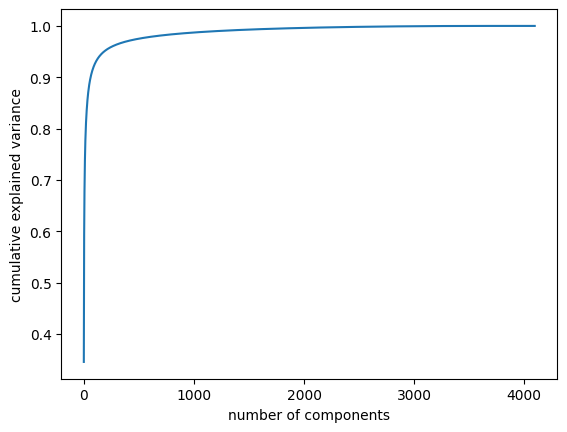

In [ ]:
pca = PCA().fit(feat)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')


In [ ]:
pca = PCA(n_components=200, random_state=22)
pca.fit(feat)
x = pca.transform(feat)

In [ ]:
import joblib
joblib.dump(pca, 'pca.pkl')


['pca.pkl']

For n_clusters = 2 The average silhouette_score is : 0.2642296
For n_clusters = 3 The average silhouette_score is : 0.17919861
For n_clusters = 4 The average silhouette_score is : 0.16069935
For n_clusters = 5 The average silhouette_score is : 0.15185675
For n_clusters = 6 The average silhouette_score is : 0.1521125
For n_clusters = 7 The average silhouette_score is : 0.12979181
For n_clusters = 8 The average silhouette_score is : 0.11319305
For n_clusters = 9 The average silhouette_score is : 0.10995743
For n_clusters = 10 The average silhouette_score is : 0.10781515
For n_clusters = 11 The average silhouette_score is : 0.10893547
For n_clusters = 12 The average silhouette_score is : 0.095780924
For n_clusters = 13 The average silhouette_score is : 0.101247035
For n_clusters = 14 The average silhouette_score is : 0.092354745
For n_clusters = 15 The average silhouette_score is : 0.092406735
For n_clusters = 16 The average silhouette_score is : 0.0953032
For n_clusters = 17 The average 

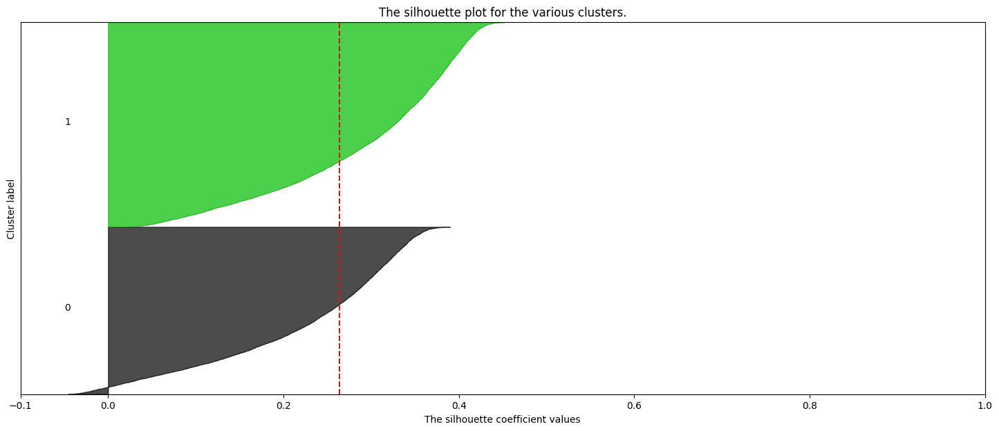

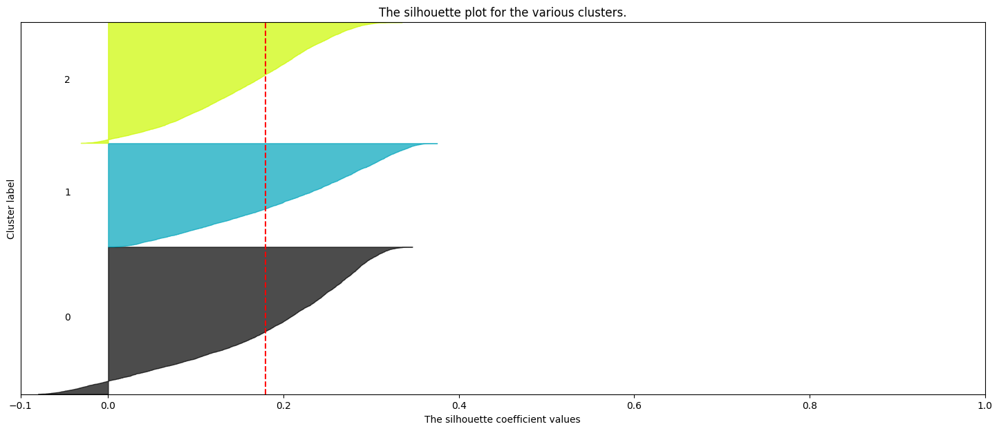

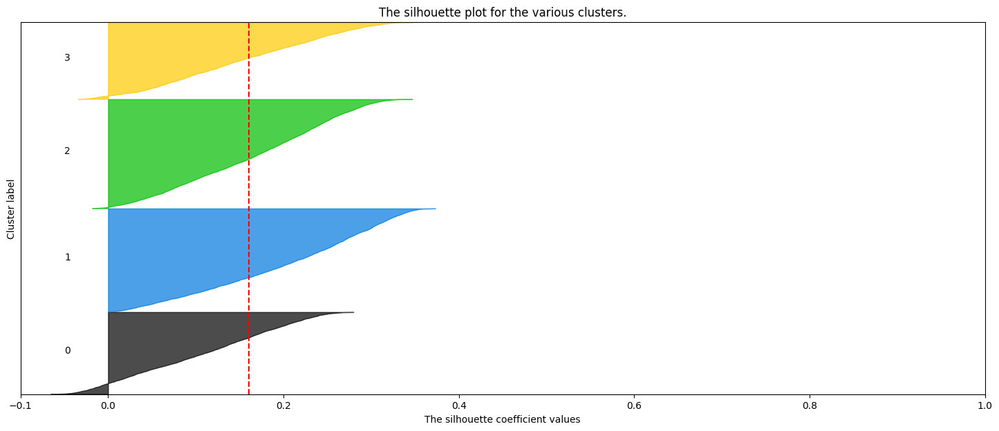

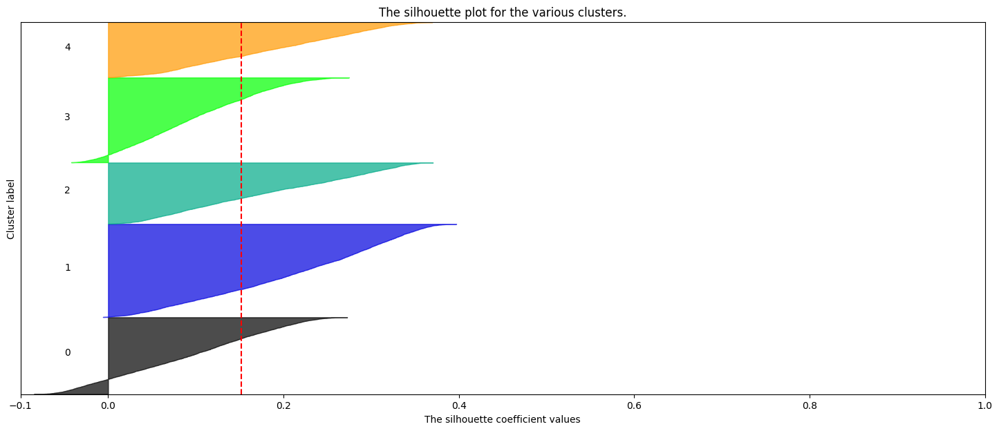

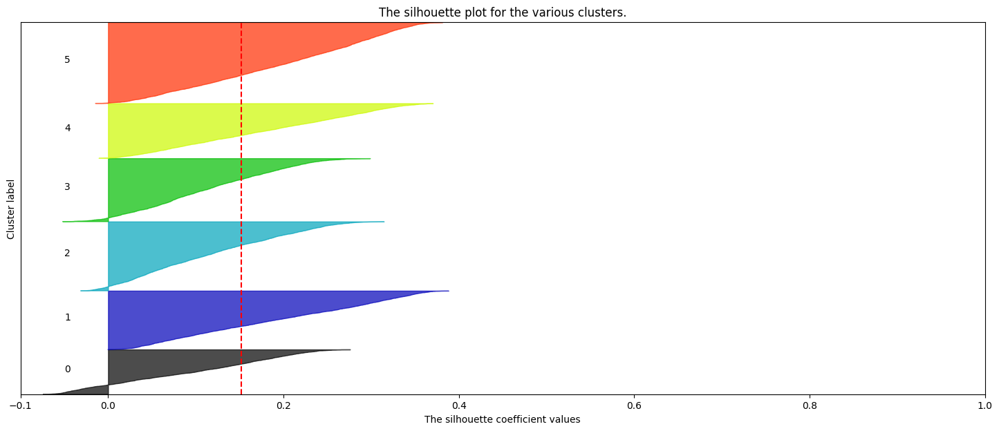

...

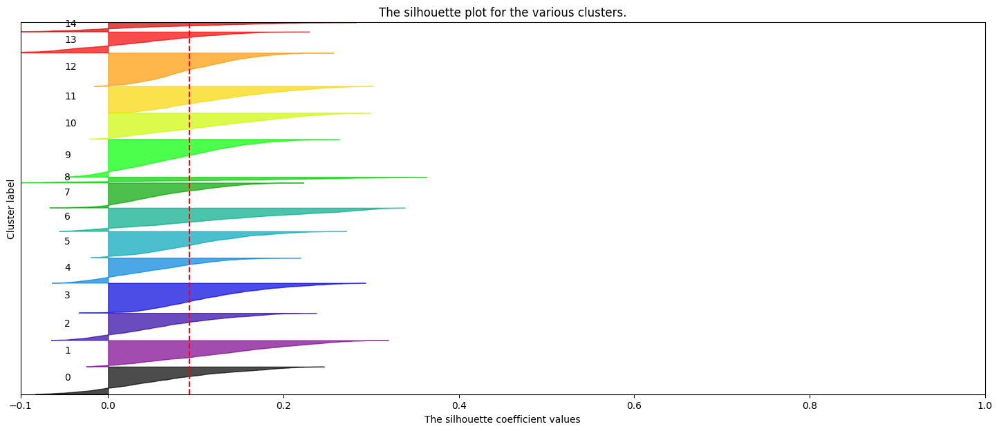

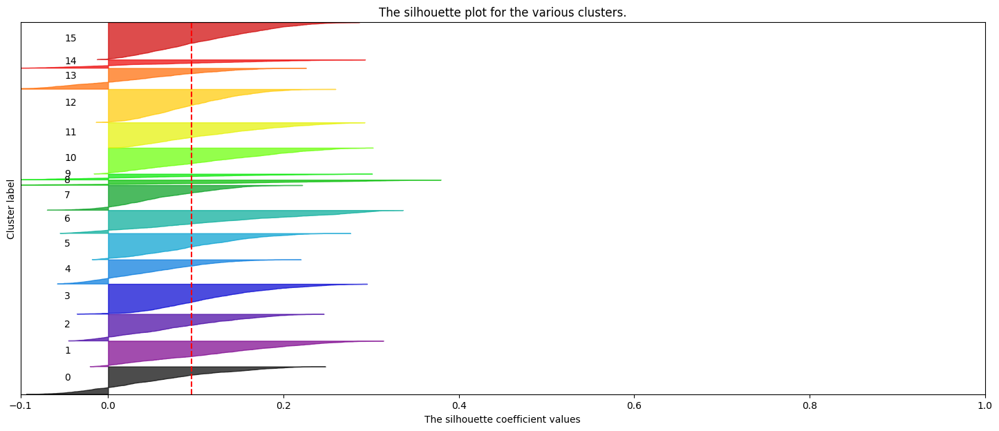

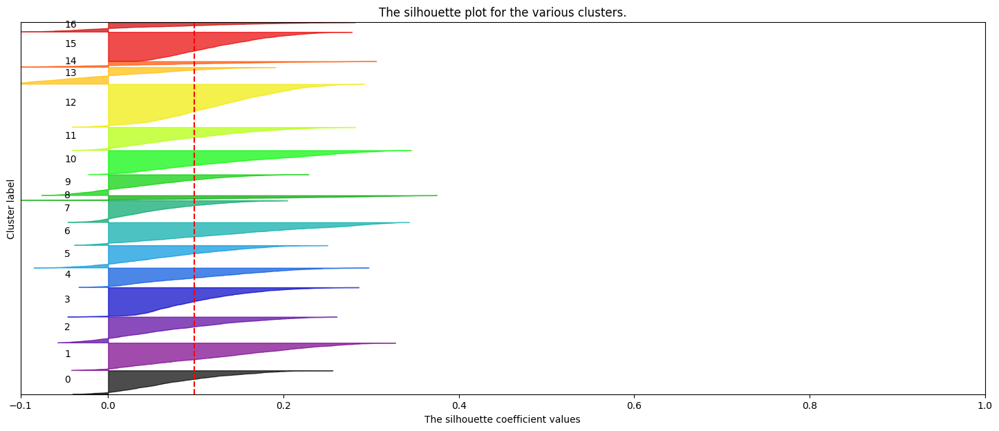

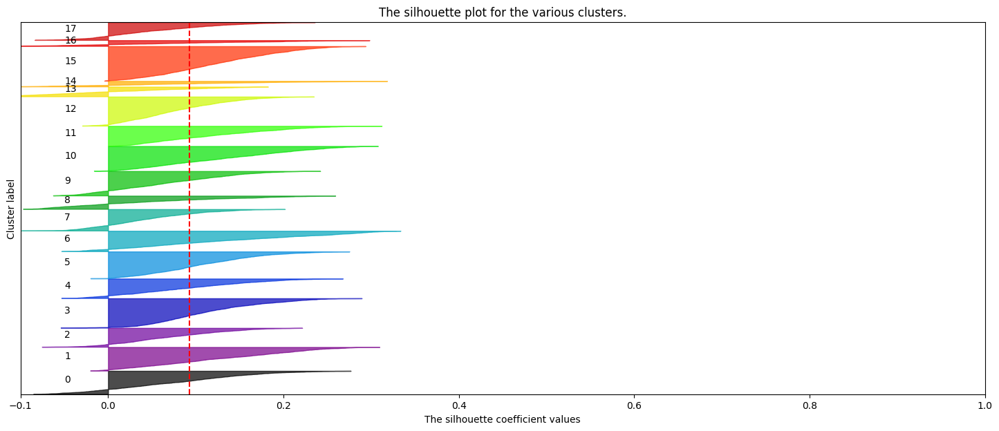

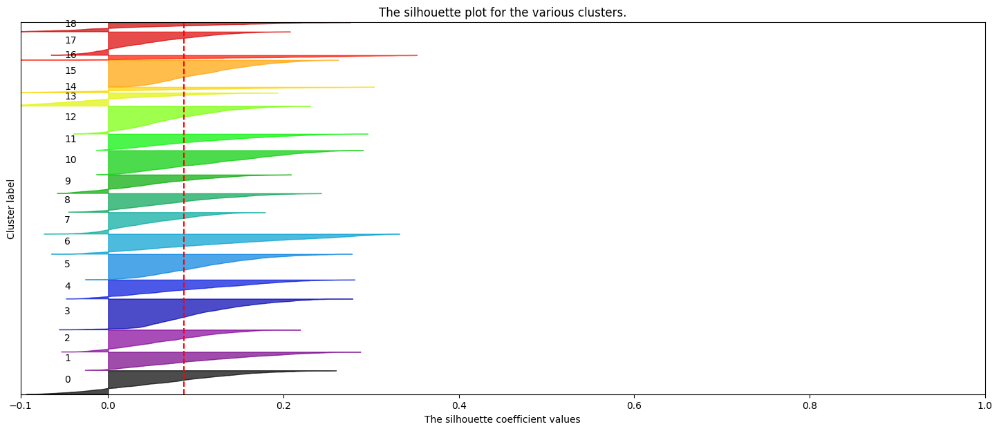

In [ ]:
# Convert the feature vectors to a numpy array
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score

import cv2
import os
from sklearn.cluster import KMeans
import shutil
X = x
range_n_clusters = [2, 3, 4, 5, 6, 8]

for n_clusters in range(2, 20, 1):
    # Create a subplot with 1 row and 2 columns
    fig, ax1  = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

In [ ]:
X = x

In [ ]:
import shutil
CLUSTERS = 14

for cluster in range(0, CLUSTERS+1):
  isExist = os.path.exists(f"/content/{cluster}")
  if not isExist:
   # Create a new directory because it does not exist
   os.makedirs(f"/content/{cluster}")
   print("The new directory is created!")
  else:
    shutil.rmtree(f"/content/{cluster}")
    os.makedirs(f"/content/{cluster}")
filenames

# Perform DBSCAN clustering
dbscan = KMeans(n_clusters=CLUSTERS, n_init="auto", random_state=10)
labels = dbscan.fit_predict(X)

# Print the cluster labels for each image
for i, label in enumerate(labels):
    # print(f'/content/{label}/{paths[i].split("/content/cropped_imgs/")[-1]}')
    shutil.copyfile(f'/content/cropped_imgs/{filenames[i]}',
                          f'/content/{label}/{filenames[i]}')

    print(f'Image {i+1}: Cluster {label}')

流式输出内容被截断，只能显示最后 5000 行内容。
Image 10206: Cluster 12
Image 10207: Cluster 6
Image 10208: Cluster 6
Image 10209: Cluster 12
Image 10210: Cluster 5
Image 10211: Cluster 6
Image 10212: Cluster 5
Image 10213: Cluster 6
Image 10214: Cluster 11
Image 10215: Cluster 10
Image 10216: Cluster 9
Image 10217: Cluster 2
Image 10218: Cluster 12
Image 10219: Cluster 5
Image 10220: Cluster 13
Image 10221: Cluster 0
Image 10222: Cluster 13
Image 10223: Cluster 11
Image 10224: Cluster 13
Image 10225: Cluster 7
Image 10226: Cluster 2
Image 10227: Cluster 1
Image 10228: Cluster 9
Image 10229: Cluster 7
Image 10230: Cluster 12
Image 10231: Cluster 0
Image 10232: Cluster 3
Image 10233: Cluster 3
Image 10234: Cluster 1
Image 10235: Cluster 3
Image 10236: Cluster 1
Image 10237: Cluster 10
Image 10238: Cluster 2
Image 10239: Cluster 1
Image 10240: Cluster 0
Image 10241: Cluster 1
Image 10242: Cluster 4
Image 10243: Cluster 7
Image 10244: Cluster 7
Image 10245: Cluster 11
Image 10246: Cluster 0
Image 10247: Clust

In [ ]:
import joblib
joblib.dump(dbscan, 'cluster.pkl')

['cluster.pkl']

In [ ]:
CLUSTERS = 14


# Final cluster


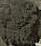

/content/0/-33.90852808789343_-33.90852808789343.png_1.jpg


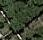

/content/0/-33.96774818900371_-33.96774818900371.png_51.jpg


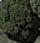

/content/0/-33.8125603368135_-33.8125603368135.png_11.jpg


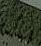

/content/0/-33.79272203041733_-33.79272203041733.png_40.jpg


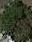

/content/0/-33.959740945648406_-33.959740945648406.png_6.jpg


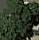

/content/0/-33.83165446563834_-33.83165446563834.png_9.jpg


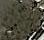

/content/0/-33.919556049674_-33.919556049674.png_6.jpg


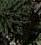

/content/0/-33.815228034100684_-33.815228034100684.png_3.jpg


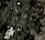

/content/0/-33.81056329781624_-33.81056329781624.png_38.jpg


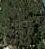

/content/0/-33.98405015932163_-33.98405015932163.png_1.jpg


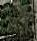

/content/0/-33.77254901554439_-33.77254901554439.png_24.jpg


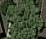

/content/0/-33.80600584864532_-33.80600584864532.png_41.jpg


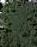

/content/0/-33.8613226347493_-33.8613226347493.png_24.jpg


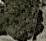

/content/0/-33.910114025966166_-33.910114025966166.png_7.jpg


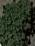

/content/0/-33.80434688824013_-33.80434688824013.png_6.jpg


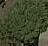

/content/0/-33.93225921618757_-33.93225921618757.png_3.jpg


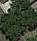

/content/0/-33.96237520251141_-33.96237520251141.png_16.jpg


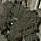

/content/0/-33.91282768303347_-33.91282768303347.png_24.jpg


/content/0/-33.801540682301976_-33.801540682301976.png_60.jpg


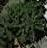

/content/0/-33.96918503792231_-33.96918503792231.png_7.jpg


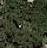

/content/0/-34.04020219188604_-34.04020219188604.png_21.jpg


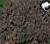

/content/0/-33.80289295672762_-33.80289295672762.png_8.jpg


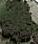

/content/0/-33.80708499429534_-33.80708499429534.png_0.jpg


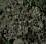

/content/0/-33.78132830284324_-33.78132830284324.png_11.jpg


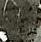

/content/0/-33.91282768303347_-33.91282768303347.png_40.jpg


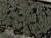

/content/0/-33.84048150405653_-33.84048150405653.png_2.jpg


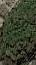

/content/0/-33.8995692183628_-33.8995692183628.png_1.jpg


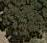

/content/0/-33.936934727662816_-33.936934727662816.png_9.jpg


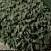

/content/0/-33.80574800633773_-33.80574800633773.png_1.jpg


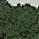

/content/0/-33.77492858950917_-33.77492858950917.png_35.jpg


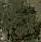

/content/0/-33.93225921618757_-33.93225921618757.png_0.jpg


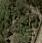

/content/0/-33.93438224536404_-33.93438224536404.png_44.jpg


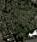

/content/0/-33.96821607101372_-33.96821607101372.png_11.jpg


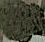

/content/0/-34.02933095725989_-34.02933095725989.png_1.jpg


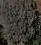

/content/0/-33.87196721013416_-33.87196721013416.png_0.jpg


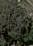

/content/0/-33.79223858531032_-33.79223858531032.png_7.jpg


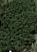

/content/0/-33.787565523132514_-33.787565523132514.png_2.jpg


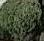

/content/0/-33.78751943395539_-33.78751943395539.png_1.jpg


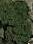

/content/0/-33.93128210622558_-33.93128210622558.png_8.jpg


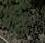

/content/0/-33.77254901554439_-33.77254901554439.png_16.jpg


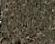

/content/0/-34.0298124476484_-34.0298124476484.png_18.jpg


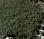

/content/0/-33.91451801809517_-33.91451801809517.png_5.jpg


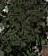

/content/0/-34.042055294949535_-34.042055294949535.png_13.jpg


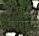

/content/0/-33.94407247659519_-33.94407247659519.png_48.jpg


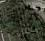

/content/0/-33.79208382680196_-33.79208382680196.png_23.jpg


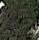

/content/0/-33.81269114630075_-33.81269114630075.png_41.jpg


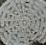

/content/0/-33.844230871244505_-33.844230871244505.png_9.jpg


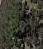

/content/0/-34.04593504687838_-34.04593504687838.png_12.jpg


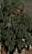

/content/0/-33.92466729926398_-33.92466729926398.png_6.jpg


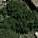

/content/0/-33.95725723524588_-33.95725723524588.png_32.jpg


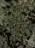

/content/0/-34.04107787348382_-34.04107787348382.png_27.jpg


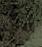

/content/0/-33.80254487949665_-33.80254487949665.png_45.jpg


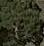

/content/0/-33.91046417030443_-33.91046417030443.png_22.jpg


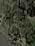

/content/0/-33.77487029262844_-33.77487029262844.png_36.jpg


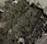

/content/0/-33.91840795152411_-33.91840795152411.png_1.jpg


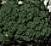

/content/0/-33.87822243684813_-33.87822243684813.png_7.jpg


/content/0/-33.90807947968192_-33.90807947968192.png_7.jpg


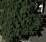

/content/0/-34.04817756328939_-34.04817756328939.png_0.jpg


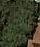

/content/0/-33.91764819497187_-33.91764819497187.png_23.jpg


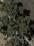

/content/0/-33.959740945648406_-33.959740945648406.png_5.jpg


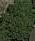

/content/0/-33.91014460465312_-33.91014460465312.png_10.jpg


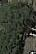

/content/0/-33.81018261141205_-33.81018261141205.png_1.jpg


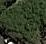

/content/0/-33.954820329262276_-33.954820329262276.png_11.jpg


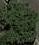

/content/0/-33.98032143971563_-33.98032143971563.png_2.jpg


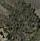

/content/0/-33.97630903686157_-33.97630903686157.png_9.jpg


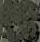

/content/0/-33.849662269805826_-33.849662269805826.png_6.jpg


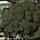

/content/0/-33.93776421036587_-33.93776421036587.png_5.jpg


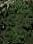

/content/0/-33.98265810117472_-33.98265810117472.png_43.jpg


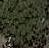

/content/0/-34.056282311215185_-34.056282311215185.png_4.jpg


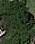

/content/0/-33.971092645268094_-33.971092645268094.png_39.jpg


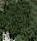

/content/0/-34.04020219188604_-34.04020219188604.png_4.jpg


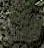

/content/0/-33.95756873295237_-33.95756873295237.png_6.jpg


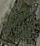

/content/0/-33.849662269805826_-33.849662269805826.png_8.jpg


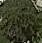

/content/0/-33.93094696770984_-33.93094696770984.png_5.jpg


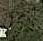

/content/0/-33.92534958615767_-33.92534958615767.png_46.jpg


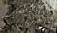

/content/0/-34.0298124476484_-34.0298124476484.png_11.jpg


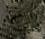

/content/0/-33.968762189999936_-33.968762189999936.png_15.jpg


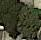

/content/0/-33.93966677012558_-33.93966677012558.png_13.jpg


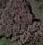

/content/0/-33.77714794282482_-33.77714794282482.png_11.jpg


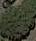

/content/0/-33.98265810117472_-33.98265810117472.png_8.jpg


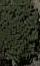

/content/0/-33.97833800804419_-33.97833800804419.png_0.jpg


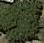

/content/0/-33.92618723253119_-33.92618723253119.png_1.jpg


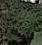

/content/0/-34.04681512996399_-34.04681512996399.png_12.jpg


/content/0/-33.91048851592869_-33.91048851592869.png_21.jpg


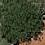

/content/0/-33.955771136277015_-33.955771136277015.png_0.jpg


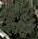

/content/0/-33.79430777628854_-33.79430777628854.png_13.jpg


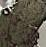

/content/0/-33.919556049674_-33.919556049674.png_20.jpg


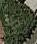

/content/0/-33.77254901554439_-33.77254901554439.png_3.jpg


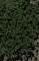

/content/0/-33.85944570496735_-33.85944570496735.png_2.jpg


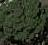

/content/0/-33.974194456550094_-33.974194456550094.png_0.jpg


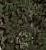

/content/0/-33.91195265784434_-33.91195265784434.png_31.jpg


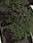

/content/0/-33.917282335069515_-33.917282335069515.png_13.jpg


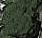

/content/0/-33.81018261141205_-33.81018261141205.png_16.jpg


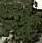

/content/0/-33.93225921618757_-33.93225921618757.png_20.jpg


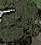

/content/0/-33.8160489739298_-33.8160489739298.png_9.jpg


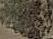

/content/0/-33.94267835983631_-33.94267835983631.png_0.jpg


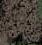

/content/0/-33.77977499635599_-33.77977499635599.png_47.jpg


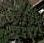

/content/0/-33.970025382836006_-33.970025382836006.png_11.jpg


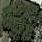

/content/0/-33.7881458629625_-33.7881458629625.png_4.jpg


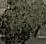

/content/0/-33.92576753521442_-33.92576753521442.png_0.jpg
----------------------------------------------------------


/content/1/-33.94267835983631_-33.94267835983631.png_6.jpg


/content/1/-33.97764280851468_-33.97764280851468.png_43.jpg


/content/1/-33.80303522425099_-33.80303522425099.png_1.jpg


/content/1/-33.794766056579014_-33.794766056579014.png_25.jpg


/content/1/-33.97630903686157_-33.97630903686157.png_26.jpg


/content/1/-33.91819448180171_-33.91819448180171.png_7.jpg


/content/1/-33.81202107135806_-33.81202107135806.png_36.jpg


/content/1/-33.86563381644105_-33.86563381644105.png_19.jpg


/content/1/-33.89883210872744_-33.89883210872744.png_38.jpg


/content/1/-33.8160489739298_-33.8160489739298.png_31.jpg


/content/1/-33.814392643509336_-33.814392643509336.png_22.jpg


/content/1/-33.908736509946905_-33.908736509946905.png_7.jpg


/content/1/-33.851650482016794_-33.851650482016794.png_24.jpg


/content/1/-33.80313383211838_-33.80313383211838.png_20.jpg


/content/1/-33.81475116780956_-33.81475116780956.png_52.jpg


/content/1/-33.933507613786325_-33.933507613786325.png_30.jpg


/content/1/-33.79612462834195_-33.79612462834195.png_32.jpg


/content/1/-33.885429100221394_-33.885429100221394.png_59.jpg


/content/1/-33.98401371375975_-33.98401371375975.png_25.jpg


/content/1/-34.02933095725989_-34.02933095725989.png_25.jpg


/content/1/-34.05318631603975_-34.05318631603975.png_37.jpg


/content/1/-33.93398649921131_-33.93398649921131.png_36.jpg


/content/1/-33.913442328940405_-33.913442328940405.png_17.jpg


/content/1/-33.93438224536404_-33.93438224536404.png_15.jpg


/content/1/-33.93776421036587_-33.93776421036587.png_25.jpg


/content/1/-33.91548187886308_-33.91548187886308.png_8.jpg


/content/1/-33.96821607101372_-33.96821607101372.png_19.jpg


/content/1/-33.97595442033598_-33.97595442033598.png_29.jpg


/content/1/-33.92936514682347_-33.92936514682347.png_19.jpg


/content/1/-33.81056329781624_-33.81056329781624.png_56.jpg


/content/1/-33.907999319522006_-33.907999319522006.png_6.jpg


/content/1/-33.81456991599494_-33.81456991599494.png_34.jpg


/content/1/-33.79637106426437_-33.79637106426437.png_32.jpg


/content/1/-33.81154006507382_-33.81154006507382.png_52.jpg


/content/1/-33.97630903686157_-33.97630903686157.png_29.jpg


/content/1/-33.97764280851468_-33.97764280851468.png_39.jpg


/content/1/-33.93776596070898_-33.93776596070898.png_38.jpg


/content/1/-33.92936514682347_-33.92936514682347.png_42.jpg


/content/1/-33.968762189999936_-33.968762189999936.png_43.jpg


/content/1/-33.88085846895865_-33.88085846895865.png_13.jpg


/content/1/-33.93014447793407_-33.93014447793407.png_34.jpg


/content/1/-33.825333518804094_-33.825333518804094.png_9.jpg


/content/1/-33.80780351329181_-33.80780351329181.png_42.jpg


/content/1/-33.90670084469867_-33.90670084469867.png_58.jpg


/content/1/-33.9366740557126_-33.9366740557126.png_37.jpg


/content/1/-33.825333518804094_-33.825333518804094.png_8.jpg


/content/1/-33.87562817357351_-33.87562817357351.png_21.jpg


/content/1/-33.846775344556434_-33.846775344556434.png_6.jpg


/content/1/-34.03106634531281_-34.03106634531281.png_29.jpg


/content/1/-33.85983197197308_-33.85983197197308.png_42.jpg


/content/1/-33.94407247659519_-33.94407247659519.png_37.jpg


/content/1/-33.96774818900371_-33.96774818900371.png_39.jpg


/content/1/-33.974519737480996_-33.974519737480996.png_45.jpg


/content/1/-33.910114025966166_-33.910114025966166.png_47.jpg


/content/1/-33.78132830284324_-33.78132830284324.png_20.jpg


/content/1/-33.85983197197308_-33.85983197197308.png_11.jpg


/content/1/-33.96260864427253_-33.96260864427253.png_17.jpg


/content/1/-33.86183877621924_-33.86183877621924.png_29.jpg


/content/1/-33.84219458835753_-33.84219458835753.png_27.jpg


/content/1/-33.92331560899621_-33.92331560899621.png_20.jpg


/content/1/-34.056282311215185_-34.056282311215185.png_40.jpg


/content/1/-33.85983197197308_-33.85983197197308.png_37.jpg


/content/1/-33.78970910055953_-33.78970910055953.png_46.jpg


/content/1/-33.97595442033598_-33.97595442033598.png_19.jpg


/content/1/-33.79223858531032_-33.79223858531032.png_38.jpg


/content/1/-33.77492858950917_-33.77492858950917.png_14.jpg


/content/1/-33.94267835983631_-33.94267835983631.png_21.jpg


/content/1/-34.029531837170616_-34.029531837170616.png_24.jpg


/content/1/-33.98227477040155_-33.98227477040155.png_35.jpg


/content/1/-33.95990692866725_-33.95990692866725.png_32.jpg


/content/1/-33.814392643509336_-33.814392643509336.png_16.jpg


/content/1/-33.97976692907611_-33.97976692907611.png_35.jpg


/content/1/-33.908736509946905_-33.908736509946905.png_29.jpg


/content/1/-33.79689066318984_-33.79689066318984.png_41.jpg


/content/1/-33.908736509946905_-33.908736509946905.png_5.jpg


/content/1/-33.927302970054036_-33.927302970054036.png_38.jpg


/content/1/-33.97307600603625_-33.97307600603625.png_25.jpg


/content/1/-33.78970910055953_-33.78970910055953.png_34.jpg


/content/1/-33.784437582794766_-33.784437582794766.png_38.jpg


/content/1/-33.919556049674_-33.919556049674.png_15.jpg


/content/1/-33.975845671303446_-33.975845671303446.png_29.jpg


/content/1/-33.91819448180171_-33.91819448180171.png_36.jpg


/content/1/-33.851650482016794_-33.851650482016794.png_36.jpg


/content/1/-33.93776596070898_-33.93776596070898.png_19.jpg


/content/1/-33.95725723524588_-33.95725723524588.png_36.jpg


/content/1/-33.91764819497187_-33.91764819497187.png_42.jpg


/content/1/-33.907058129708886_-33.907058129708886.png_42.jpg


/content/1/-33.87196721013416_-33.87196721013416.png_45.jpg


/content/1/-33.81475116780956_-33.81475116780956.png_37.jpg


/content/1/-33.92618723253119_-33.92618723253119.png_12.jpg


/content/1/-33.96726413276078_-33.96726413276078.png_35.jpg


/content/1/-33.851650482016794_-33.851650482016794.png_27.jpg


/content/1/-33.83612761820723_-33.83612761820723.png_14.jpg


/content/1/-33.976367714598126_-33.976367714598126.png_37.jpg


/content/1/-33.96238064294552_-33.96238064294552.png_23.jpg


/content/1/-33.89883210872744_-33.89883210872744.png_26.jpg


/content/1/-34.04107787348382_-34.04107787348382.png_30.jpg


/content/1/-33.977571521481245_-33.977571521481245.png_15.jpg


/content/1/-33.81456991599494_-33.81456991599494.png_46.jpg


/content/1/-33.955771136277015_-33.955771136277015.png_29.jpg
----------------------------------------------------------


/content/2/-33.80961749654923_-33.80961749654923.png_35.jpg


/content/2/-33.79695769009388_-33.79695769009388.png_22.jpg


/content/2/-33.92534958615767_-33.92534958615767.png_2.jpg


/content/2/-33.795970844687105_-33.795970844687105.png_14.jpg


/content/2/-33.96986870587083_-33.96986870587083.png_10.jpg


/content/2/-33.81056329781624_-33.81056329781624.png_52.jpg


/content/2/-33.936934727662816_-33.936934727662816.png_8.jpg


/content/2/-33.96399588208459_-33.96399588208459.png_40.jpg


/content/2/-33.81475116780956_-33.81475116780956.png_53.jpg


/content/2/-33.79353198378261_-33.79353198378261.png_19.jpg


/content/2/-33.820399886844186_-33.820399886844186.png_16.jpg


/content/2/-33.974194456550094_-33.974194456550094.png_35.jpg


/content/2/-33.871224772051164_-33.871224772051164.png_9.jpg


/content/2/-33.967111191127415_-33.967111191127415.png_6.jpg


/content/2/-33.98227477040155_-33.98227477040155.png_16.jpg


/content/2/-34.034844247315824_-34.034844247315824.png_3.jpg


/content/2/-33.8498281900632_-33.8498281900632.png_9.jpg


/content/2/-33.98214638453072_-33.98214638453072.png_15.jpg


/content/2/-33.96115935437024_-33.96115935437024.png_11.jpg


/content/2/-33.85393692228541_-33.85393692228541.png_36.jpg


/content/2/-33.90656389648789_-33.90656389648789.png_21.jpg


/content/2/-33.92427666005508_-33.92427666005508.png_30.jpg


/content/2/-33.814151436279346_-33.814151436279346.png_33.jpg


/content/2/-33.97559523926068_-33.97559523926068.png_22.jpg


/content/2/-33.833338936966406_-33.833338936966406.png_2.jpg


/content/2/-33.8125603368135_-33.8125603368135.png_15.jpg


/content/2/-33.8613226347493_-33.8613226347493.png_27.jpg


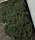

/content/2/-33.79341073135254_-33.79341073135254.png_35.jpg


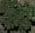

/content/2/-33.97235110835986_-33.97235110835986.png_21.jpg


/content/2/-33.7955739455384_-33.7955739455384.png_49.jpg


/content/2/-33.91895670359154_-33.91895670359154.png_7.jpg


/content/2/-33.96846285336229_-33.96846285336229.png_23.jpg


/content/2/-33.91819448180171_-33.91819448180171.png_3.jpg


/content/2/-33.96115935437024_-33.96115935437024.png_16.jpg


/content/2/-33.97589973714994_-33.97589973714994.png_25.jpg


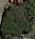

/content/2/-33.92038264565631_-33.92038264565631.png_22.jpg


/content/2/-33.913677185520605_-33.913677185520605.png_15.jpg


/content/2/-33.85691993785866_-33.85691993785866.png_11.jpg


/content/2/-33.966249531009154_-33.966249531009154.png_19.jpg


/content/2/-33.86288139852035_-33.86288139852035.png_28.jpg


/content/2/-33.784437582794766_-33.784437582794766.png_34.jpg


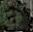

/content/2/-33.79208382680196_-33.79208382680196.png_27.jpg


/content/2/-33.93014447793407_-33.93014447793407.png_31.jpg


/content/2/-33.91525916281142_-33.91525916281142.png_47.jpg


/content/2/-34.04681512996399_-34.04681512996399.png_38.jpg


/content/2/-34.05318631603975_-34.05318631603975.png_26.jpg


/content/2/-33.776279362565866_-33.776279362565866.png_45.jpg


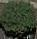

/content/2/-33.85944570496735_-33.85944570496735.png_0.jpg


/content/2/-33.8325839537181_-33.8325839537181.png_19.jpg


/content/2/-33.974519737480996_-33.974519737480996.png_46.jpg


/content/2/-33.92694526074041_-33.92694526074041.png_59.jpg


/content/2/-33.975845671303446_-33.975845671303446.png_5.jpg


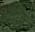

/content/2/-33.795970844687105_-33.795970844687105.png_36.jpg


/content/2/-33.9237323455828_-33.9237323455828.png_31.jpg


/content/2/-33.7955739455384_-33.7955739455384.png_67.jpg


/content/2/-33.788032863260284_-33.788032863260284.png_34.jpg


/content/2/-33.78132830284324_-33.78132830284324.png_51.jpg


/content/2/-33.85944570496735_-33.85944570496735.png_67.jpg


/content/2/-33.84190386970322_-33.84190386970322.png_18.jpg


/content/2/-33.871224772051164_-33.871224772051164.png_10.jpg


/content/2/-33.81343619258548_-33.81343619258548.png_26.jpg


/content/2/-33.88085846895865_-33.88085846895865.png_12.jpg


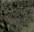

/content/2/-33.80254487949665_-33.80254487949665.png_41.jpg


/content/2/-33.784437582794766_-33.784437582794766.png_50.jpg


/content/2/-33.92049321986321_-33.92049321986321.png_33.jpg


/content/2/-33.92038264565631_-33.92038264565631.png_48.jpg


/content/2/-33.93966677012558_-33.93966677012558.png_10.jpg


/content/2/-33.814392643509336_-33.814392643509336.png_17.jpg


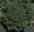

/content/2/-33.82355717281341_-33.82355717281341.png_11.jpg


/content/2/-33.784620253157534_-33.784620253157534.png_31.jpg


/content/2/-33.86183877621924_-33.86183877621924.png_15.jpg


/content/2/-33.91747611903886_-33.91747611903886.png_35.jpg


/content/2/-34.0440596679214_-34.0440596679214.png_12.jpg


/content/2/-33.78806372685979_-33.78806372685979.png_36.jpg


/content/2/-33.78970910055953_-33.78970910055953.png_19.jpg


/content/2/-33.85393692228541_-33.85393692228541.png_28.jpg


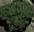

/content/2/-33.96774818900371_-33.96774818900371.png_2.jpg


/content/2/-33.92046249320792_-33.92046249320792.png_29.jpg


/content/2/-34.03679052087878_-34.03679052087878.png_14.jpg


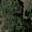

/content/2/-33.814392643509336_-33.814392643509336.png_23.jpg


/content/2/-33.9366740557126_-33.9366740557126.png_3.jpg


/content/2/-33.963115096736395_-33.963115096736395.png_9.jpg


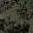

/content/2/-33.79817694475697_-33.79817694475697.png_41.jpg


/content/2/-33.856469553844676_-33.856469553844676.png_15.jpg


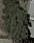

/content/2/-33.83758338825295_-33.83758338825295.png_7.jpg


/content/2/-33.93683627031715_-33.93683627031715.png_5.jpg


/content/2/-33.98227477040155_-33.98227477040155.png_32.jpg


/content/2/-33.7955739455384_-33.7955739455384.png_70.jpg


/content/2/-33.93765931056981_-33.93765931056981.png_23.jpg


/content/2/-33.820399886844186_-33.820399886844186.png_13.jpg


/content/2/-33.93398649921131_-33.93398649921131.png_27.jpg


/content/2/-33.97039676265393_-33.97039676265393.png_36.jpg


/content/2/-33.80574800633773_-33.80574800633773.png_25.jpg


/content/2/-33.91731336912437_-33.91731336912437.png_19.jpg


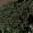

/content/2/-33.96945427970518_-33.96945427970518.png_30.jpg


/content/2/-33.86288139852035_-33.86288139852035.png_14.jpg


/content/2/-33.84013243414026_-33.84013243414026.png_31.jpg


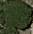

/content/2/-33.927302970054036_-33.927302970054036.png_9.jpg


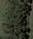

/content/2/-33.87253660257565_-33.87253660257565.png_35.jpg


/content/2/-33.871224772051164_-33.871224772051164.png_4.jpg
----------------------------------------------------------


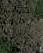

/content/3/-33.814151436279346_-33.814151436279346.png_39.jpg


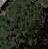

/content/3/-33.815228034100684_-33.815228034100684.png_22.jpg


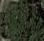

/content/3/-33.81056329781624_-33.81056329781624.png_17.jpg


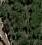

/content/3/-33.98426459454405_-33.98426459454405.png_48.jpg


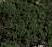

/content/3/-33.93574485728175_-33.93574485728175.png_2.jpg


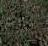

/content/3/-33.970025382836006_-33.970025382836006.png_24.jpg


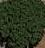

/content/3/-33.91948811581027_-33.91948811581027.png_0.jpg


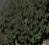

/content/3/-33.78173763699905_-33.78173763699905.png_19.jpg


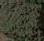

/content/3/-33.77204462165503_-33.77204462165503.png_6.jpg


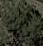

/content/3/-33.85829219782105_-33.85829219782105.png_14.jpg


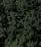

/content/3/-33.774165569919646_-33.774165569919646.png_66.jpg


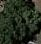

/content/3/-33.8212759735773_-33.8212759735773.png_13.jpg


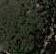

/content/3/-33.806128795098715_-33.806128795098715.png_19.jpg


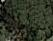

/content/3/-33.814151436279346_-33.814151436279346.png_9.jpg


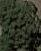

/content/3/-33.82537769920283_-33.82537769920283.png_23.jpg


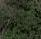

/content/3/-33.8006543628537_-33.8006543628537.png_33.jpg


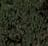

/content/3/-34.04817756328939_-34.04817756328939.png_68.jpg


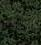

/content/3/-34.0440596679214_-34.0440596679214.png_15.jpg


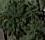

/content/3/-33.87196721013416_-33.87196721013416.png_3.jpg


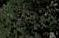

/content/3/-34.04817756328939_-34.04817756328939.png_37.jpg


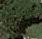

/content/3/-33.9263666090922_-33.9263666090922.png_11.jpg


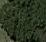

/content/3/-33.97129065781866_-33.97129065781866.png_34.jpg


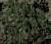

/content/3/-33.77477786112486_-33.77477786112486.png_32.jpg


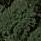

/content/3/-33.77254901554439_-33.77254901554439.png_37.jpg


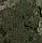

/content/3/-34.06008965076173_-34.06008965076173.png_41.jpg


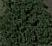

/content/3/-33.79695769009388_-33.79695769009388.png_32.jpg


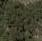

/content/3/-33.93014447793407_-33.93014447793407.png_15.jpg


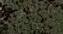

/content/3/-34.05358480877774_-34.05358480877774.png_35.jpg


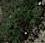

/content/3/-33.77204462165503_-33.77204462165503.png_15.jpg


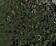

/content/3/-33.7881458629625_-33.7881458629625.png_27.jpg


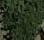

/content/3/-33.79341073135254_-33.79341073135254.png_8.jpg


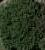

/content/3/-33.974519737480996_-33.974519737480996.png_4.jpg


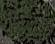

/content/3/-33.98405015932163_-33.98405015932163.png_3.jpg


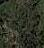

/content/3/-33.96918503792231_-33.96918503792231.png_15.jpg


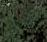

/content/3/-33.80078884260376_-33.80078884260376.png_59.jpg


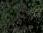

/content/3/-33.774165569919646_-33.774165569919646.png_63.jpg


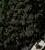

/content/3/-33.80574800633773_-33.80574800633773.png_10.jpg


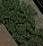

/content/3/-33.97039676265393_-33.97039676265393.png_25.jpg


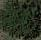

/content/3/-33.83165446563834_-33.83165446563834.png_1.jpg


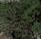

/content/3/-33.80961749654923_-33.80961749654923.png_28.jpg


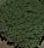

/content/3/-33.95878736899063_-33.95878736899063.png_2.jpg


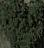

/content/3/-33.83165446563834_-33.83165446563834.png_20.jpg


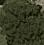

/content/3/-33.93225921618757_-33.93225921618757.png_28.jpg


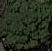

/content/3/-33.81154006507382_-33.81154006507382.png_25.jpg


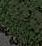

/content/3/-33.787565523132514_-33.787565523132514.png_33.jpg


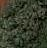

/content/3/-33.77977499635599_-33.77977499635599.png_25.jpg


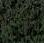

/content/3/-33.774165569919646_-33.774165569919646.png_43.jpg


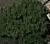

/content/3/-33.970025382836006_-33.970025382836006.png_16.jpg


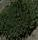

/content/3/-33.97129065781866_-33.97129065781866.png_0.jpg


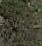

/content/3/-34.05358480877774_-34.05358480877774.png_31.jpg


/content/3/-33.91764819497187_-33.91764819497187.png_9.jpg


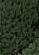

/content/3/-33.81269114630075_-33.81269114630075.png_29.jpg


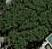

/content/3/-33.98426459454405_-33.98426459454405.png_9.jpg


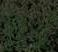

/content/3/-33.775954322152806_-33.775954322152806.png_73.jpg


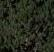

/content/3/-34.04817756328939_-34.04817756328939.png_44.jpg


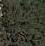

/content/3/-33.79127565817694_-33.79127565817694.png_9.jpg


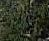

/content/3/-34.05975652023457_-34.05975652023457.png_9.jpg


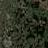

/content/3/-33.974519737480996_-33.974519737480996.png_44.jpg


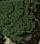

/content/3/-33.92071770130151_-33.92071770130151.png_6.jpg


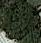

/content/3/-33.97213629614094_-33.97213629614094.png_3.jpg


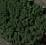

/content/3/-33.806128795098715_-33.806128795098715.png_2.jpg


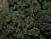

/content/3/-33.85691993785866_-33.85691993785866.png_46.jpg


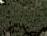

/content/3/-34.06008965076173_-34.06008965076173.png_9.jpg


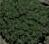

/content/3/-33.805987357059614_-33.805987357059614.png_0.jpg


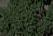

/content/3/-33.81535115206846_-33.81535115206846.png_13.jpg


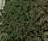

/content/3/-33.91747611903886_-33.91747611903886.png_9.jpg


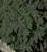

/content/3/-33.78751943395539_-33.78751943395539.png_11.jpg


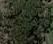

/content/3/-33.85944570496735_-33.85944570496735.png_19.jpg


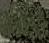

/content/3/-34.02933095725989_-34.02933095725989.png_7.jpg


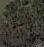

/content/3/-33.80210418723449_-33.80210418723449.png_16.jpg


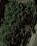

/content/3/-33.81056329781624_-33.81056329781624.png_30.jpg


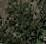

/content/3/-33.85944570496735_-33.85944570496735.png_30.jpg


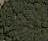

/content/3/-33.93756996531083_-33.93756996531083.png_42.jpg


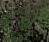

/content/3/-33.907249116719_-33.907249116719.png_13.jpg


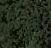

/content/3/-33.774165569919646_-33.774165569919646.png_76.jpg


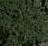

/content/3/-33.78806372685979_-33.78806372685979.png_13.jpg


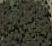

/content/3/-33.77492858950917_-33.77492858950917.png_18.jpg


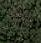

/content/3/-33.98265810117472_-33.98265810117472.png_37.jpg


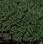

/content/3/-33.77492858950917_-33.77492858950917.png_20.jpg


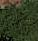

/content/3/-33.91525916281142_-33.91525916281142.png_27.jpg


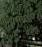

/content/3/-33.86122855260644_-33.86122855260644.png_12.jpg


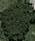

/content/3/-33.805987357059614_-33.805987357059614.png_3.jpg


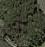

/content/3/-34.03677160959602_-34.03677160959602.png_11.jpg


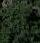

/content/3/-33.98307019138977_-33.98307019138977.png_77.jpg


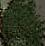

/content/3/-33.91948811581027_-33.91948811581027.png_2.jpg


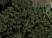

/content/3/-33.97235110835986_-33.97235110835986.png_50.jpg


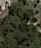

/content/3/-33.93756996531083_-33.93756996531083.png_51.jpg


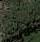

/content/3/-33.80975403857292_-33.80975403857292.png_45.jpg


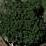

/content/3/-33.96945427970518_-33.96945427970518.png_0.jpg


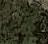

/content/3/-33.92332292543133_-33.92332292543133.png_41.jpg


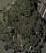

/content/3/-33.81535115206846_-33.81535115206846.png_2.jpg


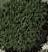

/content/3/-33.79272203041733_-33.79272203041733.png_0.jpg


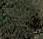

/content/3/-33.80078884260376_-33.80078884260376.png_19.jpg


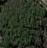

/content/3/-33.80434688824013_-33.80434688824013.png_3.jpg


/content/3/-33.93094696770984_-33.93094696770984.png_29.jpg


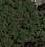

/content/3/-33.917282335069515_-33.917282335069515.png_22.jpg


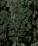

/content/3/-33.79695769009388_-33.79695769009388.png_33.jpg


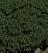

/content/3/-33.91014460465312_-33.91014460465312.png_22.jpg


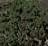

/content/3/-33.98265810117472_-33.98265810117472.png_12.jpg


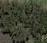

/content/3/-33.96237520251141_-33.96237520251141.png_13.jpg
----------------------------------------------------------


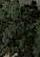

/content/4/-33.832925114904555_-33.832925114904555.png_21.jpg


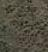

/content/4/-33.820399886844186_-33.820399886844186.png_18.jpg


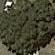

/content/4/-33.93776596070898_-33.93776596070898.png_1.jpg


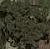

/content/4/-34.052161107551896_-34.052161107551896.png_2.jpg


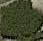

/content/4/-33.93094696770984_-33.93094696770984.png_0.jpg


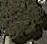

/content/4/-33.91764819497187_-33.91764819497187.png_7.jpg


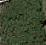

/content/4/-33.8995692183628_-33.8995692183628.png_16.jpg


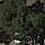

/content/4/-33.88167425622574_-33.88167425622574.png_8.jpg


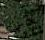

/content/4/-33.80961749654923_-33.80961749654923.png_22.jpg


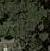

/content/4/-33.97706397086192_-33.97706397086192.png_13.jpg


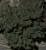

/content/4/-33.85315308182898_-33.85315308182898.png_0.jpg


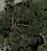

/content/4/-33.8325839537181_-33.8325839537181.png_16.jpg


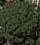

/content/4/-33.91764819497187_-33.91764819497187.png_4.jpg


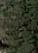

/content/4/-33.91108624210735_-33.91108624210735.png_48.jpg


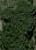

/content/4/-33.97953928679019_-33.97953928679019.png_9.jpg


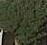

/content/4/-33.92049321986321_-33.92049321986321.png_8.jpg


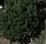

/content/4/-33.8212759735773_-33.8212759735773.png_0.jpg


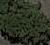

/content/4/-33.96726413276078_-33.96726413276078.png_6.jpg


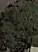

/content/4/-33.92038264565631_-33.92038264565631.png_2.jpg


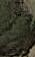

/content/4/-33.90843029513644_-33.90843029513644.png_23.jpg


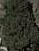

/content/4/-33.86563381644105_-33.86563381644105.png_7.jpg


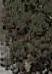

/content/4/-33.85983197197308_-33.85983197197308.png_10.jpg


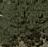

/content/4/-33.93765931056981_-33.93765931056981.png_9.jpg


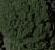

/content/4/-33.81701022985311_-33.81701022985311.png_15.jpg


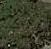

/content/4/-33.927302970054036_-33.927302970054036.png_26.jpg


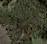

/content/4/-34.05318631603975_-34.05318631603975.png_35.jpg


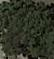

/content/4/-33.88167425622574_-33.88167425622574.png_2.jpg


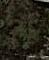

/content/4/-33.907058129708886_-33.907058129708886.png_22.jpg


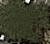

/content/4/-33.93765931056981_-33.93765931056981.png_5.jpg


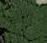

/content/4/-33.97396070755525_-33.97396070755525.png_11.jpg


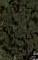

/content/4/-34.05318631603975_-34.05318631603975.png_8.jpg


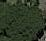

/content/4/-33.89883210872744_-33.89883210872744.png_20.jpg


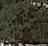

/content/4/-33.920782491181214_-33.920782491181214.png_10.jpg


/content/4/-33.8325839537181_-33.8325839537181.png_3.jpg


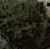

/content/4/-33.91108624210735_-33.91108624210735.png_5.jpg


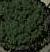

/content/4/-33.81269114630075_-33.81269114630075.png_6.jpg


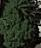

/content/4/-33.80961749654923_-33.80961749654923.png_11.jpg


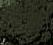

/content/4/-33.79430777628854_-33.79430777628854.png_8.jpg


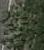

/content/4/-33.874052809962926_-33.874052809962926.png_33.jpg


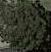

/content/4/-33.87196721013416_-33.87196721013416.png_2.jpg


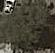

/content/4/-33.920782491181214_-33.920782491181214.png_1.jpg


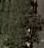

/content/4/-33.907058129708886_-33.907058129708886.png_6.jpg


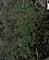

/content/4/-33.96399588208459_-33.96399588208459.png_42.jpg


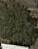

/content/4/-33.9296348024509_-33.9296348024509.png_1.jpg


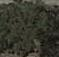

/content/4/-33.82056930704311_-33.82056930704311.png_1.jpg


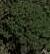

/content/4/-33.92576753521442_-33.92576753521442.png_9.jpg


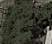

/content/4/-33.83758338825295_-33.83758338825295.png_6.jpg


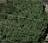

/content/4/-34.042055294949535_-34.042055294949535.png_16.jpg


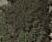

/content/4/-33.90741360262161_-33.90741360262161.png_17.jpg


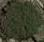

/content/4/-33.94218620359492_-33.94218620359492.png_0.jpg


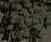

/content/4/-33.92038264565631_-33.92038264565631.png_19.jpg


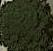

/content/4/-33.92332292543133_-33.92332292543133.png_4.jpg


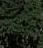

/content/4/-33.85944570496735_-33.85944570496735.png_58.jpg


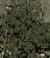

/content/4/-34.052161107551896_-34.052161107551896.png_7.jpg


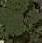

/content/4/-33.93094696770984_-33.93094696770984.png_44.jpg


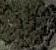

/content/4/-34.029531837170616_-34.029531837170616.png_2.jpg


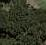

/content/4/-33.93756996531083_-33.93756996531083.png_38.jpg


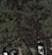

/content/4/-33.83612761820723_-33.83612761820723.png_21.jpg


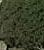

/content/4/-33.91548187886308_-33.91548187886308.png_14.jpg


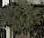

/content/4/-33.77724822236651_-33.77724822236651.png_5.jpg


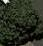

/content/4/-33.97235110835986_-33.97235110835986.png_6.jpg


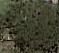

/content/4/-34.06008965076173_-34.06008965076173.png_39.jpg


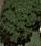

/content/4/-34.06008965076173_-34.06008965076173.png_20.jpg


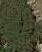

/content/4/-33.92936514682347_-33.92936514682347.png_12.jpg


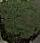

/content/4/-33.92427666005508_-33.92427666005508.png_1.jpg


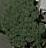

/content/4/-33.82537769920283_-33.82537769920283.png_3.jpg


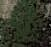

/content/4/-33.81701022985311_-33.81701022985311.png_10.jpg


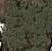

/content/4/-33.91047395810337_-33.91047395810337.png_6.jpg


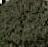

/content/4/-33.93776421036587_-33.93776421036587.png_13.jpg


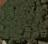

/content/4/-33.92071770130151_-33.92071770130151.png_1.jpg


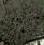

/content/4/-33.79322352844539_-33.79322352844539.png_9.jpg


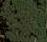

/content/4/-33.92694526074041_-33.92694526074041.png_35.jpg


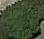

/content/4/-33.98265810117472_-33.98265810117472.png_6.jpg


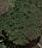

/content/4/-33.784620253157534_-33.784620253157534.png_2.jpg


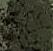

/content/4/-33.79341073135254_-33.79341073135254.png_2.jpg


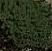

/content/4/-33.92694526074041_-33.92694526074041.png_18.jpg


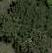

/content/4/-33.917282335069515_-33.917282335069515.png_7.jpg


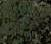

/content/4/-33.77254901554439_-33.77254901554439.png_18.jpg


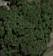

/content/4/-33.93683627031715_-33.93683627031715.png_15.jpg


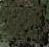

/content/4/-34.04593504687838_-34.04593504687838.png_1.jpg


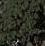

/content/4/-33.810016455899316_-33.810016455899316.png_7.jpg


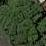

/content/4/-33.971092645268094_-33.971092645268094.png_24.jpg


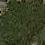

/content/4/-33.92331560899621_-33.92331560899621.png_15.jpg


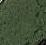

/content/4/-33.81456991599494_-33.81456991599494.png_49.jpg


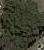

/content/4/-33.98032143971563_-33.98032143971563.png_3.jpg


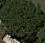

/content/4/-33.91525916281142_-33.91525916281142.png_0.jpg


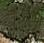

/content/4/-33.94033248385097_-33.94033248385097.png_1.jpg


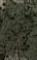

/content/4/-33.8498281900632_-33.8498281900632.png_3.jpg


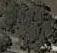

/content/4/-33.849662269805826_-33.849662269805826.png_7.jpg


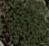

/content/4/-33.94218620359492_-33.94218620359492.png_12.jpg


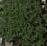

/content/4/-33.92560102690655_-33.92560102690655.png_6.jpg


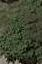

/content/4/-33.90843029513644_-33.90843029513644.png_10.jpg


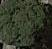

/content/4/-33.80961749654923_-33.80961749654923.png_5.jpg


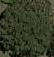

/content/4/-33.93683627031715_-33.93683627031715.png_0.jpg


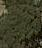

/content/4/-33.93438224536404_-33.93438224536404.png_27.jpg


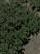

/content/4/-33.8006543628537_-33.8006543628537.png_1.jpg


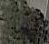

/content/4/-33.83793357584756_-33.83793357584756.png_7.jpg


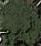

/content/4/-33.81269114630075_-33.81269114630075.png_2.jpg


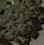

/content/4/-33.9263666090922_-33.9263666090922.png_2.jpg


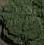

/content/4/-33.954820329262276_-33.954820329262276.png_28.jpg
----------------------------------------------------------


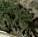

/content/5/-33.93776421036587_-33.93776421036587.png_33.jpg


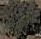

/content/5/-33.82537769920283_-33.82537769920283.png_1.jpg


/content/5/-33.96945427970518_-33.96945427970518.png_11.jpg


/content/5/-33.77977499635599_-33.77977499635599.png_3.jpg


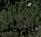

/content/5/-33.97129065781866_-33.97129065781866.png_49.jpg


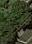

/content/5/-33.91046417030443_-33.91046417030443.png_18.jpg


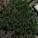

/content/5/-33.96774818900371_-33.96774818900371.png_23.jpg


/content/5/-33.83165446563834_-33.83165446563834.png_23.jpg


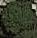

/content/5/-33.907249116719_-33.907249116719.png_6.jpg


/content/5/-33.80384444476587_-33.80384444476587.png_42.jpg


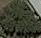

/content/5/-33.976367714598126_-33.976367714598126.png_12.jpg


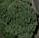

/content/5/-33.784437582794766_-33.784437582794766.png_18.jpg


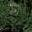

/content/5/-34.0440596679214_-34.0440596679214.png_38.jpg


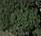

/content/5/-33.810016455899316_-33.810016455899316.png_17.jpg


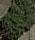

/content/5/-33.92576753521442_-33.92576753521442.png_5.jpg


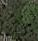

/content/5/-33.96399588208459_-33.96399588208459.png_30.jpg


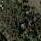

/content/5/-34.05975652023457_-34.05975652023457.png_29.jpg


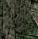

/content/5/-33.81154006507382_-33.81154006507382.png_49.jpg


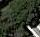

/content/5/-33.8160489739298_-33.8160489739298.png_17.jpg


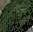

/content/5/-33.81456991599494_-33.81456991599494.png_47.jpg


/content/5/-33.83793357584756_-33.83793357584756.png_3.jpg


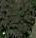

/content/5/-33.97953928679019_-33.97953928679019.png_16.jpg


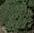

/content/5/-33.90843029513644_-33.90843029513644.png_11.jpg


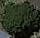

/content/5/-33.80574800633773_-33.80574800633773.png_0.jpg


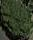

/content/5/-33.954820329262276_-33.954820329262276.png_12.jpg


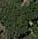

/content/5/-33.97630903686157_-33.97630903686157.png_16.jpg


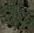

/content/5/-33.96120952005672_-33.96120952005672.png_8.jpg


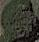

/content/5/-33.83758338825295_-33.83758338825295.png_2.jpg


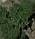

/content/5/-33.971092645268094_-33.971092645268094.png_31.jpg


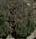

/content/5/-33.93574485728175_-33.93574485728175.png_23.jpg


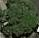

/content/5/-33.97039676265393_-33.97039676265393.png_24.jpg


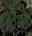

/content/5/-33.78751943395539_-33.78751943395539.png_10.jpg


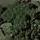

/content/5/-33.97589973714994_-33.97589973714994.png_16.jpg


/content/5/-33.80708499429534_-33.80708499429534.png_29.jpg


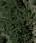

/content/5/-33.793517987148654_-33.793517987148654.png_7.jpg


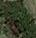

/content/5/-33.975845671303446_-33.975845671303446.png_23.jpg


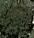

/content/5/-33.95357695863401_-33.95357695863401.png_3.jpg


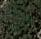

/content/5/-33.80078884260376_-33.80078884260376.png_33.jpg


/content/5/-33.978472430137465_-33.978472430137465.png_28.jpg


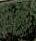

/content/5/-33.801540682301976_-33.801540682301976.png_9.jpg


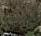

/content/5/-33.93610137571062_-33.93610137571062.png_9.jpg


/content/5/-33.87196721013416_-33.87196721013416.png_38.jpg


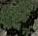

/content/5/-33.97833800804419_-33.97833800804419.png_14.jpg


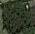

/content/5/-33.80526020982918_-33.80526020982918.png_16.jpg


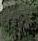

/content/5/-33.777723454967415_-33.777723454967415.png_1.jpg


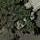

/content/5/-33.97559523926068_-33.97559523926068.png_41.jpg


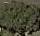

/content/5/-33.92618723253119_-33.92618723253119.png_0.jpg


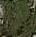

/content/5/-33.9288631607713_-33.9288631607713.png_32.jpg


/content/5/-33.81202107135806_-33.81202107135806.png_38.jpg


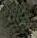

/content/5/-33.96399588208459_-33.96399588208459.png_3.jpg


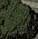

/content/5/-34.02933095725989_-34.02933095725989.png_20.jpg


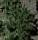

/content/5/-33.98405015932163_-33.98405015932163.png_10.jpg


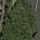

/content/5/-34.03679052087878_-34.03679052087878.png_15.jpg


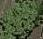

/content/5/-34.04523925003062_-34.04523925003062.png_18.jpg


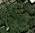

/content/5/-33.967111191127415_-33.967111191127415.png_21.jpg


/content/5/-33.82537769920283_-33.82537769920283.png_19.jpg


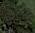

/content/5/-33.98214638453072_-33.98214638453072.png_36.jpg


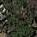

/content/5/-33.96238064294552_-33.96238064294552.png_27.jpg


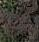

/content/5/-33.78751943395539_-33.78751943395539.png_36.jpg


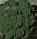

/content/5/-33.784795244929164_-33.784795244929164.png_11.jpg


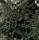

/content/5/-33.96945427970518_-33.96945427970518.png_24.jpg


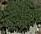

/content/5/-34.06008965076173_-34.06008965076173.png_33.jpg


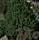

/content/5/-33.96945427970518_-33.96945427970518.png_48.jpg


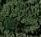

/content/5/-33.97967636751759_-33.97967636751759.png_38.jpg


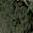

/content/5/-33.96846285336229_-33.96846285336229.png_22.jpg


/content/5/-33.77977499635599_-33.77977499635599.png_5.jpg


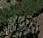

/content/5/-33.81154006507382_-33.81154006507382.png_55.jpg


/content/5/-33.86288139852035_-33.86288139852035.png_24.jpg


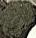

/content/5/-33.919556049674_-33.919556049674.png_17.jpg


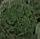

/content/5/-34.04020219188604_-34.04020219188604.png_26.jpg


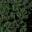

/content/5/-33.97967636751759_-33.97967636751759.png_56.jpg


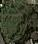

/content/5/-33.9202558610692_-33.9202558610692.png_7.jpg


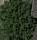

/content/5/-33.97976692907611_-33.97976692907611.png_5.jpg


/content/5/-33.97976692907611_-33.97976692907611.png_17.jpg


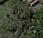

/content/5/-33.98023245961893_-33.98023245961893.png_46.jpg


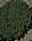

/content/5/-33.80600584864532_-33.80600584864532.png_1.jpg


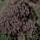

/content/5/-33.77714794282482_-33.77714794282482.png_5.jpg


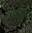

/content/5/-33.96774818900371_-33.96774818900371.png_36.jpg


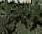

/content/5/-34.03677160959602_-34.03677160959602.png_31.jpg


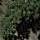

/content/5/-33.78194039624411_-33.78194039624411.png_18.jpg


/content/5/-33.97630530115373_-33.97630530115373.png_24.jpg


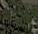

/content/5/-33.96821607101372_-33.96821607101372.png_25.jpg


/content/5/-33.774165569919646_-33.774165569919646.png_46.jpg


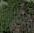

/content/5/-33.79223858531032_-33.79223858531032.png_35.jpg


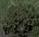

/content/5/-33.79430777628854_-33.79430777628854.png_24.jpg


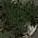

/content/5/-33.97039676265393_-33.97039676265393.png_15.jpg


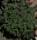

/content/5/-33.96422754258788_-33.96422754258788.png_4.jpg


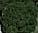

/content/5/-33.9588225641219_-33.9588225641219.png_9.jpg


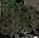

/content/5/-33.8212759735773_-33.8212759735773.png_18.jpg


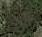

/content/5/-34.04020219188604_-34.04020219188604.png_33.jpg


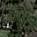

/content/5/-33.814151436279346_-33.814151436279346.png_24.jpg


/content/5/-33.79963973225738_-33.79963973225738.png_42.jpg


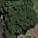

/content/5/-33.795970844687105_-33.795970844687105.png_8.jpg


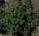

/content/5/-33.974519737480996_-33.974519737480996.png_17.jpg


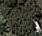

/content/5/-33.81154006507382_-33.81154006507382.png_19.jpg


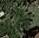

/content/5/-33.974194456550094_-33.974194456550094.png_47.jpg


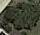

/content/5/-33.81580975244062_-33.81580975244062.png_20.jpg


/content/5/-33.971092645268094_-33.971092645268094.png_43.jpg


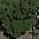

/content/5/-33.92694526074041_-33.92694526074041.png_29.jpg


/content/5/-33.79695769009388_-33.79695769009388.png_44.jpg
----------------------------------------------------------


/content/6/-33.77977499635599_-33.77977499635599.png_38.jpg


/content/6/-33.81701022985311_-33.81701022985311.png_33.jpg


/content/6/-34.04369269887961_-34.04369269887961.png_27.jpg


/content/6/-33.80897473791712_-33.80897473791712.png_14.jpg


/content/6/-33.78173763699905_-33.78173763699905.png_28.jpg


/content/6/-33.78194039624411_-33.78194039624411.png_7.jpg


/content/6/-33.78173763699905_-33.78173763699905.png_8.jpg


/content/6/-33.81018261141205_-33.81018261141205.png_15.jpg


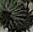

/content/6/-33.858701799663045_-33.858701799663045.png_3.jpg


/content/6/-33.95756873295237_-33.95756873295237.png_19.jpg


/content/6/-34.04523925003062_-34.04523925003062.png_12.jpg


/content/6/-33.91425867323046_-33.91425867323046.png_29.jpg


/content/6/-33.96846285336229_-33.96846285336229.png_48.jpg


/content/6/-33.97953928679019_-33.97953928679019.png_25.jpg


/content/6/-33.98401371375975_-33.98401371375975.png_13.jpg


/content/6/-33.976367714598126_-33.976367714598126.png_26.jpg


/content/6/-33.87196721013416_-33.87196721013416.png_44.jpg


/content/6/-33.933507613786325_-33.933507613786325.png_43.jpg


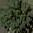

/content/6/-33.79272203041733_-33.79272203041733.png_7.jpg


/content/6/-33.94033248385097_-33.94033248385097.png_29.jpg


/content/6/-33.81343619258548_-33.81343619258548.png_32.jpg


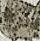

/content/6/-33.90795006839414_-33.90795006839414.png_5.jpg


/content/6/-33.927302970054036_-33.927302970054036.png_40.jpg


/content/6/-33.903421305902306_-33.903421305902306.png_13.jpg


/content/6/-33.956851588602134_-33.956851588602134.png_22.jpg


/content/6/-33.93776596070898_-33.93776596070898.png_30.jpg


/content/6/-33.96450327978131_-33.96450327978131.png_6.jpg


/content/6/-33.907249116719_-33.907249116719.png_32.jpg


/content/6/-33.91895670359154_-33.91895670359154.png_5.jpg


/content/6/-33.836534872987535_-33.836534872987535.png_13.jpg


/content/6/-33.97589973714994_-33.97589973714994.png_24.jpg


/content/6/-33.784437582794766_-33.784437582794766.png_35.jpg


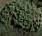

/content/6/-33.79612462834195_-33.79612462834195.png_18.jpg


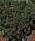

/content/6/-34.042055294949535_-34.042055294949535.png_21.jpg


/content/6/-33.956851588602134_-33.956851588602134.png_3.jpg


/content/6/-33.87253660257565_-33.87253660257565.png_40.jpg


/content/6/-34.033365017731036_-34.033365017731036.png_39.jpg


/content/6/-33.96501659958289_-33.96501659958289.png_14.jpg


/content/6/-33.80313383211838_-33.80313383211838.png_30.jpg


/content/6/-34.04681512996399_-34.04681512996399.png_26.jpg


/content/6/-33.80434688824013_-33.80434688824013.png_17.jpg


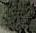

/content/6/-33.83793357584756_-33.83793357584756.png_5.jpg


/content/6/-33.93398649921131_-33.93398649921131.png_9.jpg


/content/6/-33.90843029513644_-33.90843029513644.png_41.jpg


/content/6/-33.81202107135806_-33.81202107135806.png_21.jpg


/content/6/-33.90512699972322_-33.90512699972322.png_18.jpg


/content/6/-33.95443963473776_-33.95443963473776.png_8.jpg


/content/6/-33.913442328940405_-33.913442328940405.png_10.jpg


/content/6/-33.92973887689588_-33.92973887689588.png_33.jpg


/content/6/-34.04107787348382_-34.04107787348382.png_34.jpg


/content/6/-33.793517987148654_-33.793517987148654.png_32.jpg


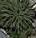

/content/6/-33.98265810117472_-33.98265810117472.png_24.jpg


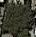

/content/6/-34.03892137271019_-34.03892137271019.png_15.jpg


/content/6/-33.81475116780956_-33.81475116780956.png_21.jpg


/content/6/-33.98214638453072_-33.98214638453072.png_8.jpg


/content/6/-34.042055294949535_-34.042055294949535.png_29.jpg


/content/6/-33.974194456550094_-33.974194456550094.png_3.jpg


/content/6/-33.93776596070898_-33.93776596070898.png_25.jpg


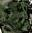

/content/6/-33.98405015932163_-33.98405015932163.png_13.jpg


/content/6/-33.90512699972322_-33.90512699972322.png_10.jpg


/content/6/-33.77269906651448_-33.77269906651448.png_33.jpg


/content/6/-33.79817694475697_-33.79817694475697.png_42.jpg


/content/6/-33.787565523132514_-33.787565523132514.png_45.jpg


/content/6/-33.906403962007815_-33.906403962007815.png_27.jpg


/content/6/-33.91648710827274_-33.91648710827274.png_19.jpg


/content/6/-33.91895670359154_-33.91895670359154.png_17.jpg


/content/6/-33.92046249320792_-33.92046249320792.png_53.jpg


/content/6/-33.92071770130151_-33.92071770130151.png_34.jpg


/content/6/-33.91282768303347_-33.91282768303347.png_29.jpg


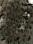

/content/6/-34.04107787348382_-34.04107787348382.png_15.jpg


/content/6/-34.03106634531281_-34.03106634531281.png_10.jpg


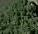

/content/6/-33.80384444476587_-33.80384444476587.png_45.jpg


/content/6/-33.971092645268094_-33.971092645268094.png_42.jpg


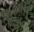

/content/6/-33.784620253157534_-33.784620253157534.png_46.jpg


/content/6/-33.84219458835753_-33.84219458835753.png_24.jpg


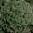

/content/6/-33.79127565817694_-33.79127565817694.png_11.jpg


/content/6/-33.93398649921131_-33.93398649921131.png_16.jpg


/content/6/-33.956851588602134_-33.956851588602134.png_13.jpg


/content/6/-33.97630903686157_-33.97630903686157.png_24.jpg


/content/6/-33.96422754258788_-33.96422754258788.png_11.jpg


/content/6/-33.80574800633773_-33.80574800633773.png_21.jpg


/content/6/-33.79353198378261_-33.79353198378261.png_27.jpg


/content/6/-33.96918503792231_-33.96918503792231.png_33.jpg


/content/6/-33.92046249320792_-33.92046249320792.png_37.jpg


/content/6/-33.858701799663045_-33.858701799663045.png_35.jpg


/content/6/-33.80384444476587_-33.80384444476587.png_37.jpg


/content/6/-33.96986870587083_-33.96986870587083.png_3.jpg


/content/6/-33.93574485728175_-33.93574485728175.png_4.jpg


/content/6/-34.028841268192146_-34.028841268192146.png_25.jpg


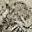

/content/6/-33.90795006839414_-33.90795006839414.png_9.jpg


/content/6/-33.93344605814121_-33.93344605814121.png_22.jpg


/content/6/-33.955771136277015_-33.955771136277015.png_18.jpg


/content/6/-33.87253660257565_-33.87253660257565.png_20.jpg


/content/6/-33.953786645084264_-33.953786645084264.png_35.jpg


/content/6/-33.905226167643065_-33.905226167643065.png_0.jpg


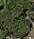

/content/6/-33.94416286870672_-33.94416286870672.png_19.jpg


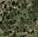

/content/6/-33.93344605814121_-33.93344605814121.png_24.jpg


/content/6/-33.966249531009154_-33.966249531009154.png_35.jpg


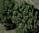

/content/6/-33.77477786112486_-33.77477786112486.png_13.jpg


/content/6/-33.81456991599494_-33.81456991599494.png_15.jpg
----------------------------------------------------------


/content/7/-33.84622378450602_-33.84622378450602.png_26.jpg


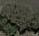

/content/7/-33.869835193560625_-33.869835193560625.png_22.jpg


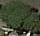

/content/7/-33.9237323455828_-33.9237323455828.png_14.jpg


/content/7/-33.97764280851468_-33.97764280851468.png_30.jpg


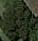

/content/7/-33.97214649987404_-33.97214649987404.png_8.jpg


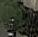

/content/7/-33.864506614876355_-33.864506614876355.png_5.jpg


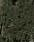

/content/7/-34.03892137271019_-34.03892137271019.png_41.jpg


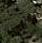

/content/7/-33.94407247659519_-33.94407247659519.png_47.jpg


/content/7/-33.92038264565631_-33.92038264565631.png_38.jpg


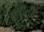

/content/7/-33.864506614876355_-33.864506614876355.png_2.jpg


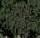

/content/7/-33.810016455899316_-33.810016455899316.png_21.jpg


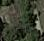

/content/7/-33.788032863260284_-33.788032863260284.png_57.jpg


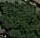

/content/7/-33.805987357059614_-33.805987357059614.png_41.jpg


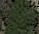

/content/7/-33.82518198306368_-33.82518198306368.png_29.jpg


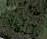

/content/7/-33.79612462834195_-33.79612462834195.png_24.jpg


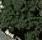

/content/7/-33.96945427970518_-33.96945427970518.png_29.jpg


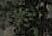

/content/7/-33.84013243414026_-33.84013243414026.png_24.jpg


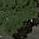

/content/7/-33.92560102690655_-33.92560102690655.png_44.jpg


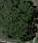

/content/7/-33.8613226347493_-33.8613226347493.png_0.jpg


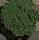

/content/7/-33.933507613786325_-33.933507613786325.png_0.jpg


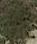

/content/7/-33.93014447793407_-33.93014447793407.png_7.jpg


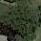

/content/7/-33.98214638453072_-33.98214638453072.png_6.jpg


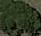

/content/7/-33.91878005615652_-33.91878005615652.png_13.jpg


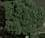

/content/7/-33.78806372685979_-33.78806372685979.png_2.jpg


/content/7/-33.92046249320792_-33.92046249320792.png_58.jpg


/content/7/-33.885429100221394_-33.885429100221394.png_66.jpg


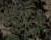

/content/7/-33.85829219782105_-33.85829219782105.png_32.jpg


/content/7/-33.77724822236651_-33.77724822236651.png_43.jpg


/content/7/-33.913677185520605_-33.913677185520605.png_28.jpg


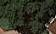

/content/7/-33.81269114630075_-33.81269114630075.png_1.jpg


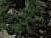

/content/7/-33.864506614876355_-33.864506614876355.png_3.jpg


/content/7/-33.91108624210735_-33.91108624210735.png_9.jpg


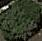

/content/7/-33.970025382836006_-33.970025382836006.png_3.jpg


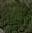

/content/7/-33.91046417030443_-33.91046417030443.png_26.jpg


/content/7/-33.97039676265393_-33.97039676265393.png_20.jpg


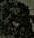

/content/7/-33.82118835175123_-33.82118835175123.png_27.jpg


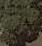

/content/7/-33.9296348024509_-33.9296348024509.png_13.jpg


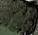

/content/7/-33.832925114904555_-33.832925114904555.png_8.jpg


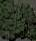

/content/7/-33.85759089763092_-33.85759089763092.png_15.jpg


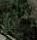

/content/7/-33.80897473791712_-33.80897473791712.png_37.jpg


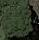

/content/7/-33.80210418723449_-33.80210418723449.png_14.jpg


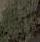

/content/7/-33.91048851592869_-33.91048851592869.png_13.jpg


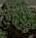

/content/7/-34.05358480877774_-34.05358480877774.png_10.jpg


/content/7/-33.83165446563834_-33.83165446563834.png_6.jpg


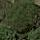

/content/7/-33.93542647812037_-33.93542647812037.png_13.jpg


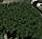

/content/7/-33.81475116780956_-33.81475116780956.png_16.jpg


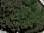

/content/7/-33.975845671303446_-33.975845671303446.png_13.jpg


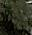

/content/7/-33.92694526074041_-33.92694526074041.png_62.jpg


/content/7/-34.04817756328939_-34.04817756328939.png_3.jpg


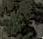

/content/7/-33.82033271330875_-33.82033271330875.png_28.jpg


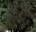

/content/7/-33.864506614876355_-33.864506614876355.png_11.jpg


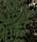

/content/7/-33.91525916281142_-33.91525916281142.png_22.jpg


/content/7/-34.04020219188604_-34.04020219188604.png_1.jpg


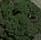

/content/7/-33.968762189999936_-33.968762189999936.png_22.jpg


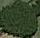

/content/7/-33.96237520251141_-33.96237520251141.png_5.jpg


/content/7/-33.78740277568652_-33.78740277568652.png_49.jpg


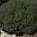

/content/7/-33.92560102690655_-33.92560102690655.png_4.jpg


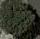

/content/7/-33.97559523926068_-33.97559523926068.png_2.jpg


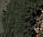

/content/7/-33.85315308182898_-33.85315308182898.png_7.jpg


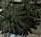

/content/7/-33.871224772051164_-33.871224772051164.png_0.jpg


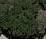

/content/7/-33.80708499429534_-33.80708499429534.png_7.jpg


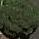

/content/7/-33.92427666005508_-33.92427666005508.png_14.jpg


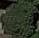

/content/7/-33.80975403857292_-33.80975403857292.png_38.jpg


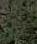

/content/7/-33.80254487949665_-33.80254487949665.png_40.jpg


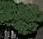

/content/7/-33.85944570496735_-33.85944570496735.png_25.jpg


/content/7/-33.81154006507382_-33.81154006507382.png_23.jpg


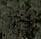

/content/7/-33.774165569919646_-33.774165569919646.png_26.jpg


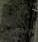

/content/7/-33.87253660257565_-33.87253660257565.png_22.jpg


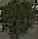

/content/7/-33.93574485728175_-33.93574485728175.png_0.jpg


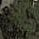

/content/7/-33.92038264565631_-33.92038264565631.png_21.jpg


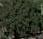

/content/7/-33.77269906651448_-33.77269906651448.png_1.jpg


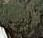

/content/7/-33.80600584864532_-33.80600584864532.png_37.jpg


/content/7/-33.7955739455384_-33.7955739455384.png_8.jpg


/content/7/-33.96846285336229_-33.96846285336229.png_20.jpg


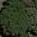

/content/7/-33.80254487949665_-33.80254487949665.png_5.jpg


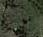

/content/7/-33.79612462834195_-33.79612462834195.png_38.jpg


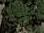

/content/7/-33.93683627031715_-33.93683627031715.png_33.jpg


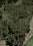

/content/7/-33.93756996531083_-33.93756996531083.png_32.jpg


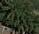

/content/7/-33.79612462834195_-33.79612462834195.png_19.jpg


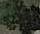

/content/7/-33.86288139852035_-33.86288139852035.png_16.jpg


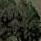

/content/7/-33.81154006507382_-33.81154006507382.png_35.jpg


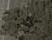

/content/7/-33.91840795152411_-33.91840795152411.png_14.jpg


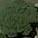

/content/7/-33.953786645084264_-33.953786645084264.png_4.jpg


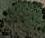

/content/7/-33.814151436279346_-33.814151436279346.png_28.jpg


/content/7/-33.7955739455384_-33.7955739455384.png_52.jpg


/content/7/-33.81269114630075_-33.81269114630075.png_39.jpg


/content/7/-33.93756996531083_-33.93756996531083.png_39.jpg


/content/7/-33.8325839537181_-33.8325839537181.png_30.jpg


/content/7/-33.858701799663045_-33.858701799663045.png_5.jpg


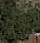

/content/7/-33.968762189999936_-33.968762189999936.png_19.jpg


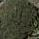

/content/7/-33.97630530115373_-33.97630530115373.png_20.jpg


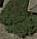

/content/7/-33.927302970054036_-33.927302970054036.png_5.jpg


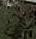

/content/7/-33.907058129708886_-33.907058129708886.png_17.jpg


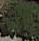

/content/7/-33.91726446346118_-33.91726446346118.png_4.jpg


/content/7/-34.06008965076173_-34.06008965076173.png_55.jpg


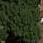

/content/7/-33.92576753521442_-33.92576753521442.png_24.jpg


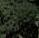

/content/7/-33.85691993785866_-33.85691993785866.png_48.jpg


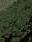

/content/7/-33.97833800804419_-33.97833800804419.png_11.jpg


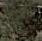

/content/7/-33.907058129708886_-33.907058129708886.png_1.jpg


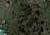

/content/7/-33.775954322152806_-33.775954322152806.png_3.jpg
----------------------------------------------------------


/content/8/-33.78970910055953_-33.78970910055953.png_41.jpg


/content/8/-33.874052809962926_-33.874052809962926.png_37.jpg


/content/8/-34.04107787348382_-34.04107787348382.png_48.jpg


/content/8/-33.93438224536404_-33.93438224536404.png_36.jpg


/content/8/-33.93765931056981_-33.93765931056981.png_6.jpg


/content/8/-33.93776596070898_-33.93776596070898.png_28.jpg


/content/8/-33.794766056579014_-33.794766056579014.png_34.jpg


/content/8/-34.028841268192146_-34.028841268192146.png_34.jpg


/content/8/-33.93398649921131_-33.93398649921131.png_8.jpg


/content/8/-33.81701022985311_-33.81701022985311.png_30.jpg


/content/8/-33.86998999145979_-33.86998999145979.png_5.jpg


/content/8/-33.81173224253344_-33.81173224253344.png_22.jpg


/content/8/-33.90795006839414_-33.90795006839414.png_6.jpg


/content/8/-33.836248484219155_-33.836248484219155.png_1.jpg


/content/8/-33.836534872987535_-33.836534872987535.png_6.jpg


/content/8/-33.85691993785866_-33.85691993785866.png_30.jpg


/content/8/-34.034844247315824_-34.034844247315824.png_13.jpg


/content/8/-33.9575494508767_-33.9575494508767.png_25.jpg


/content/8/-33.974519737480996_-33.974519737480996.png_40.jpg


/content/8/-33.91150514080407_-33.91150514080407.png_17.jpg


/content/8/-33.92332292543133_-33.92332292543133.png_33.jpg


/content/8/-33.78173763699905_-33.78173763699905.png_36.jpg


/content/8/-34.06008965076173_-34.06008965076173.png_56.jpg


/content/8/-33.8160489739298_-33.8160489739298.png_1.jpg


/content/8/-33.885429100221394_-33.885429100221394.png_39.jpg


/content/8/-33.784795244929164_-33.784795244929164.png_5.jpg


/content/8/-33.966249531009154_-33.966249531009154.png_24.jpg


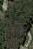

/content/8/-33.98265810117472_-33.98265810117472.png_26.jpg


/content/8/-33.81202107135806_-33.81202107135806.png_29.jpg


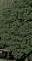

/content/8/-34.03677160959602_-34.03677160959602.png_16.jpg


/content/8/-33.920799165386775_-33.920799165386775.png_27.jpg


/content/8/-33.91451801809517_-33.91451801809517.png_23.jpg


/content/8/-33.795970844687105_-33.795970844687105.png_35.jpg


/content/8/-33.98401371375975_-33.98401371375975.png_29.jpg


/content/8/-33.910114025966166_-33.910114025966166.png_43.jpg


/content/8/-33.77492858950917_-33.77492858950917.png_41.jpg


/content/8/-33.92038264565631_-33.92038264565631.png_42.jpg


/content/8/-33.815228034100684_-33.815228034100684.png_7.jpg


/content/8/-33.81269114630075_-33.81269114630075.png_45.jpg


/content/8/-34.0440596679214_-34.0440596679214.png_28.jpg


/content/8/-33.97630530115373_-33.97630530115373.png_21.jpg


/content/8/-33.91009452175608_-33.91009452175608.png_12.jpg


/content/8/-33.787565523132514_-33.787565523132514.png_46.jpg


/content/8/-33.91108624210735_-33.91108624210735.png_43.jpg


/content/8/-33.8666118788447_-33.8666118788447.png_8.jpg


/content/8/-33.81456991599494_-33.81456991599494.png_30.jpg


/content/8/-33.98032143971563_-33.98032143971563.png_20.jpg


/content/8/-33.96918503792231_-33.96918503792231.png_9.jpg


/content/8/-34.029531837170616_-34.029531837170616.png_48.jpg


/content/8/-33.82518198306368_-33.82518198306368.png_20.jpg


/content/8/-33.96962042303279_-33.96962042303279.png_14.jpg


/content/8/-33.905226167643065_-33.905226167643065.png_3.jpg


/content/8/-33.90795006839414_-33.90795006839414.png_11.jpg


/content/8/-33.905226167643065_-33.905226167643065.png_5.jpg


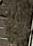

/content/8/-33.9296348024509_-33.9296348024509.png_39.jpg


/content/8/-33.967111191127415_-33.967111191127415.png_20.jpg


/content/8/-33.97396070755525_-33.97396070755525.png_23.jpg


/content/8/-33.91895670359154_-33.91895670359154.png_6.jpg


/content/8/-33.82056930704311_-33.82056930704311.png_18.jpg


/content/8/-33.93225921618757_-33.93225921618757.png_26.jpg


/content/8/-33.92619375558609_-33.92619375558609.png_20.jpg


/content/8/-33.815228034100684_-33.815228034100684.png_30.jpg


/content/8/-33.92619375558609_-33.92619375558609.png_12.jpg


/content/8/-33.849662269805826_-33.849662269805826.png_16.jpg


/content/8/-33.97559523926068_-33.97559523926068.png_29.jpg


/content/8/-33.84219458835753_-33.84219458835753.png_36.jpg


/content/8/-33.81701022985311_-33.81701022985311.png_23.jpg


/content/8/-33.865559450768586_-33.865559450768586.png_26.jpg


/content/8/-33.80526020982918_-33.80526020982918.png_33.jpg


/content/8/-33.85983197197308_-33.85983197197308.png_39.jpg


/content/8/-33.78173763699905_-33.78173763699905.png_17.jpg


/content/8/-33.94005519354731_-33.94005519354731.png_13.jpg


/content/8/-33.851323897424436_-33.851323897424436.png_2.jpg


/content/8/-33.79762945747859_-33.79762945747859.png_34.jpg


/content/8/-33.913677185520605_-33.913677185520605.png_30.jpg


/content/8/-33.97129065781866_-33.97129065781866.png_26.jpg


/content/8/-33.82355717281341_-33.82355717281341.png_39.jpg


/content/8/-33.92560102690655_-33.92560102690655.png_40.jpg


/content/8/-33.92694526074041_-33.92694526074041.png_49.jpg


/content/8/-33.96501659958289_-33.96501659958289.png_4.jpg


/content/8/-33.91620426519703_-33.91620426519703.png_8.jpg


/content/8/-34.052161107551896_-34.052161107551896.png_26.jpg


/content/8/-33.83939310108943_-33.83939310108943.png_7.jpg


/content/8/-33.97706397086192_-33.97706397086192.png_30.jpg


/content/8/-34.056282311215185_-34.056282311215185.png_16.jpg


/content/8/-33.836248484219155_-33.836248484219155.png_10.jpg


/content/8/-33.77487029262844_-33.77487029262844.png_39.jpg


/content/8/-33.820399886844186_-33.820399886844186.png_15.jpg


/content/8/-33.88167425622574_-33.88167425622574.png_19.jpg


/content/8/-33.90512699972322_-33.90512699972322.png_34.jpg


/content/8/-33.92038264565631_-33.92038264565631.png_36.jpg


/content/8/-33.79817694475697_-33.79817694475697.png_51.jpg


/content/8/-34.03892137271019_-34.03892137271019.png_5.jpg


/content/8/-34.06008965076173_-34.06008965076173.png_29.jpg


/content/8/-33.97307600603625_-33.97307600603625.png_1.jpg


/content/8/-33.79430777628854_-33.79430777628854.png_58.jpg


/content/8/-33.971092645268094_-33.971092645268094.png_56.jpg


/content/8/-33.90670084469867_-33.90670084469867.png_31.jpg


/content/8/-33.905226167643065_-33.905226167643065.png_10.jpg


/content/8/-33.81269114630075_-33.81269114630075.png_31.jpg
----------------------------------------------------------


/content/9/-33.97595442033598_-33.97595442033598.png_8.jpg


/content/9/-33.84622378450602_-33.84622378450602.png_13.jpg


/content/9/-33.93683627031715_-33.93683627031715.png_32.jpg


/content/9/-33.97589973714994_-33.97589973714994.png_28.jpg


/content/9/-33.907249116719_-33.907249116719.png_24.jpg


/content/9/-33.9288631607713_-33.9288631607713.png_34.jpg


/content/9/-33.871224772051164_-33.871224772051164.png_23.jpg


/content/9/-33.79320549412111_-33.79320549412111.png_8.jpg


/content/9/-33.95725723524588_-33.95725723524588.png_23.jpg


/content/9/-33.954820329262276_-33.954820329262276.png_13.jpg


/content/9/-33.885429100221394_-33.885429100221394.png_77.jpg


/content/9/-33.96774818900371_-33.96774818900371.png_34.jpg


/content/9/-33.96774818900371_-33.96774818900371.png_16.jpg


/content/9/-33.94407247659519_-33.94407247659519.png_40.jpg


/content/9/-33.80574800633773_-33.80574800633773.png_23.jpg


/content/9/-33.87822243684813_-33.87822243684813.png_20.jpg


/content/9/-33.96962042303279_-33.96962042303279.png_23.jpg


/content/9/-33.814151436279346_-33.814151436279346.png_25.jpg


/content/9/-33.97953928679019_-33.97953928679019.png_27.jpg


/content/9/-33.84190386970322_-33.84190386970322.png_14.jpg


/content/9/-33.974194456550094_-33.974194456550094.png_30.jpg


/content/9/-33.8160489739298_-33.8160489739298.png_25.jpg


/content/9/-33.871224772051164_-33.871224772051164.png_22.jpg


/content/9/-33.92534958615767_-33.92534958615767.png_10.jpg


/content/9/-33.963115096736395_-33.963115096736395.png_21.jpg


/content/9/-33.92038264565631_-33.92038264565631.png_25.jpg


/content/9/-33.79695769009388_-33.79695769009388.png_53.jpg


/content/9/-33.87061809048001_-33.87061809048001.png_22.jpg


/content/9/-33.968762189999936_-33.968762189999936.png_44.jpg


/content/9/-33.96986870587083_-33.96986870587083.png_8.jpg


/content/9/-33.801540682301976_-33.801540682301976.png_39.jpg


/content/9/-33.853473766363024_-33.853473766363024.png_25.jpg


/content/9/-33.90670084469867_-33.90670084469867.png_57.jpg


/content/9/-33.91014460465312_-33.91014460465312.png_20.jpg


/content/9/-33.8212759735773_-33.8212759735773.png_30.jpg


/content/9/-33.805987357059614_-33.805987357059614.png_10.jpg


/content/9/-33.82518198306368_-33.82518198306368.png_27.jpg


/content/9/-34.03106634531281_-34.03106634531281.png_14.jpg


/content/9/-33.96263274456494_-33.96263274456494.png_19.jpg


/content/9/-33.9588225641219_-33.9588225641219.png_21.jpg


/content/9/-33.79817694475697_-33.79817694475697.png_48.jpg


/content/9/-33.794766056579014_-33.794766056579014.png_19.jpg


/content/9/-33.966249531009154_-33.966249531009154.png_30.jpg


/content/9/-33.93438224536404_-33.93438224536404.png_26.jpg


/content/9/-33.92331560899621_-33.92331560899621.png_34.jpg


/content/9/-33.96774818900371_-33.96774818900371.png_28.jpg


/content/9/-33.975845671303446_-33.975845671303446.png_27.jpg


/content/9/-33.95990692866725_-33.95990692866725.png_31.jpg


/content/9/-33.95725723524588_-33.95725723524588.png_28.jpg


/content/9/-34.02933095725989_-34.02933095725989.png_21.jpg


/content/9/-33.77477786112486_-33.77477786112486.png_22.jpg


/content/9/-33.92427666005508_-33.92427666005508.png_27.jpg


/content/9/-33.80574800633773_-33.80574800633773.png_36.jpg


/content/9/-33.922329744499066_-33.922329744499066.png_38.jpg


/content/9/-33.81535115206846_-33.81535115206846.png_10.jpg


/content/9/-33.9263666090922_-33.9263666090922.png_33.jpg


/content/9/-33.94416286870672_-33.94416286870672.png_9.jpg


/content/9/-33.93776421036587_-33.93776421036587.png_37.jpg


/content/9/-33.97559523926068_-33.97559523926068.png_16.jpg


/content/9/-33.970025382836006_-33.970025382836006.png_35.jpg


/content/9/-33.79689066318984_-33.79689066318984.png_47.jpg


/content/9/-33.87971377826596_-33.87971377826596.png_16.jpg


/content/9/-33.815228034100684_-33.815228034100684.png_38.jpg


/content/9/-33.92049321986321_-33.92049321986321.png_13.jpg


/content/9/-33.79612462834195_-33.79612462834195.png_35.jpg


/content/9/-33.79320549412111_-33.79320549412111.png_14.jpg


/content/9/-33.917216107222565_-33.917216107222565.png_21.jpg


/content/9/-33.97559523926068_-33.97559523926068.png_32.jpg


/content/9/-33.959740945648406_-33.959740945648406.png_29.jpg


/content/9/-33.955307049570685_-33.955307049570685.png_8.jpg


/content/9/-33.959864698007685_-33.959864698007685.png_16.jpg


/content/9/-33.793517987148654_-33.793517987148654.png_27.jpg


/content/9/-33.80780351329181_-33.80780351329181.png_39.jpg


/content/9/-33.787565523132514_-33.787565523132514.png_49.jpg


/content/9/-33.85983197197308_-33.85983197197308.png_8.jpg


/content/9/-33.8160489739298_-33.8160489739298.png_15.jpg


/content/9/-33.92427666005508_-33.92427666005508.png_36.jpg


/content/9/-33.794766056579014_-33.794766056579014.png_32.jpg


/content/9/-33.85983197197308_-33.85983197197308.png_12.jpg


/content/9/-33.91108624210735_-33.91108624210735.png_42.jpg


/content/9/-33.927302970054036_-33.927302970054036.png_30.jpg


/content/9/-33.87253660257565_-33.87253660257565.png_33.jpg


/content/9/-33.9263666090922_-33.9263666090922.png_28.jpg


/content/9/-33.9588225641219_-33.9588225641219.png_26.jpg


/content/9/-33.98032143971563_-33.98032143971563.png_12.jpg


/content/9/-33.79689066318984_-33.79689066318984.png_31.jpg


/content/9/-33.84622378450602_-33.84622378450602.png_30.jpg


/content/9/-33.81056329781624_-33.81056329781624.png_49.jpg


/content/9/-33.79430777628854_-33.79430777628854.png_40.jpg


/content/9/-33.86288139852035_-33.86288139852035.png_32.jpg


/content/9/-33.978472430137465_-33.978472430137465.png_24.jpg


/content/9/-33.92576753521442_-33.92576753521442.png_22.jpg


/content/9/-33.885429100221394_-33.885429100221394.png_50.jpg


/content/9/-33.83758338825295_-33.83758338825295.png_17.jpg


/content/9/-33.9263666090922_-33.9263666090922.png_17.jpg


/content/9/-33.81701022985311_-33.81701022985311.png_27.jpg


/content/9/-33.97213629614094_-33.97213629614094.png_30.jpg


/content/9/-33.784620253157534_-33.784620253157534.png_23.jpg


/content/9/-33.906403962007815_-33.906403962007815.png_17.jpg


/content/9/-33.78751943395539_-33.78751943395539.png_49.jpg
----------------------------------------------------------


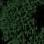

/content/10/-33.84853343930616_-33.84853343930616.png_36.jpg


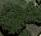

/content/10/-33.81580975244062_-33.81580975244062.png_17.jpg


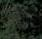

/content/10/-33.84853343930616_-33.84853343930616.png_49.jpg


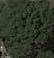

/content/10/-33.82056930704311_-33.82056930704311.png_3.jpg


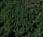

/content/10/-33.775954322152806_-33.775954322152806.png_16.jpg


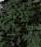

/content/10/-33.8613226347493_-33.8613226347493.png_14.jpg


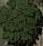

/content/10/-33.90670084469867_-33.90670084469867.png_0.jpg


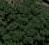

/content/10/-33.805987357059614_-33.805987357059614.png_42.jpg


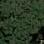

/content/10/-33.7955739455384_-33.7955739455384.png_84.jpg


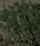

/content/10/-33.874052809962926_-33.874052809962926.png_3.jpg


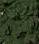

/content/10/-33.92049321986321_-33.92049321986321.png_29.jpg


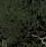

/content/10/-33.774165569919646_-33.774165569919646.png_77.jpg


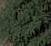

/content/10/-33.80384444476587_-33.80384444476587.png_20.jpg


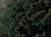

/content/10/-33.84853343930616_-33.84853343930616.png_22.jpg


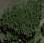

/content/10/-33.98214638453072_-33.98214638453072.png_0.jpg


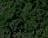

/content/10/-33.98307019138977_-33.98307019138977.png_10.jpg


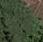

/content/10/-33.79127565817694_-33.79127565817694.png_62.jpg


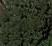

/content/10/-33.96918503792231_-33.96918503792231.png_20.jpg


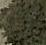

/content/10/-33.93014447793407_-33.93014447793407.png_4.jpg


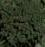

/content/10/-33.97764280851468_-33.97764280851468.png_6.jpg


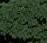

/content/10/-33.7955739455384_-33.7955739455384.png_14.jpg


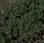

/content/10/-33.85393692228541_-33.85393692228541.png_42.jpg


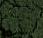

/content/10/-33.913442328940405_-33.913442328940405.png_32.jpg


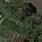

/content/10/-33.77977499635599_-33.77977499635599.png_60.jpg


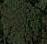

/content/10/-34.05975652023457_-34.05975652023457.png_7.jpg


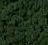

/content/10/-33.98307019138977_-33.98307019138977.png_39.jpg


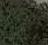

/content/10/-33.80897473791712_-33.80897473791712.png_31.jpg


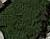

/content/10/-33.970025382836006_-33.970025382836006.png_10.jpg


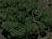

/content/10/-34.0440596679214_-34.0440596679214.png_13.jpg


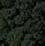

/content/10/-33.84853343930616_-33.84853343930616.png_74.jpg


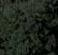

/content/10/-33.84853343930616_-33.84853343930616.png_38.jpg


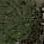

/content/10/-33.92560102690655_-33.92560102690655.png_13.jpg


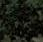

/content/10/-34.034844247315824_-34.034844247315824.png_34.jpg


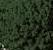

/content/10/-33.8613226347493_-33.8613226347493.png_5.jpg


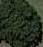

/content/10/-33.80975403857292_-33.80975403857292.png_17.jpg


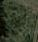

/content/10/-33.874052809962926_-33.874052809962926.png_25.jpg


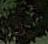

/content/10/-33.8125603368135_-33.8125603368135.png_19.jpg


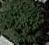

/content/10/-33.87926189595346_-33.87926189595346.png_0.jpg


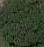

/content/10/-33.81456991599494_-33.81456991599494.png_17.jpg


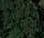

/content/10/-33.84853343930616_-33.84853343930616.png_18.jpg


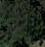

/content/10/-33.84853343930616_-33.84853343930616.png_1.jpg


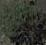

/content/10/-33.844230871244505_-33.844230871244505.png_5.jpg


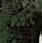

/content/10/-33.82118835175123_-33.82118835175123.png_20.jpg


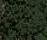

/content/10/-33.7955739455384_-33.7955739455384.png_80.jpg


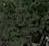

/content/10/-33.8212759735773_-33.8212759735773.png_12.jpg


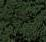

/content/10/-34.0440596679214_-34.0440596679214.png_5.jpg


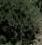

/content/10/-33.85691993785866_-33.85691993785866.png_28.jpg


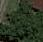

/content/10/-33.805987357059614_-33.805987357059614.png_22.jpg


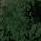

/content/10/-33.84853343930616_-33.84853343930616.png_57.jpg


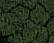

/content/10/-33.913442328940405_-33.913442328940405.png_33.jpg


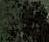

/content/10/-33.82118835175123_-33.82118835175123.png_10.jpg


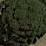

/content/10/-33.9366740557126_-33.9366740557126.png_4.jpg


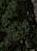

/content/10/-33.788032863260284_-33.788032863260284.png_56.jpg


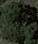

/content/10/-33.820399886844186_-33.820399886844186.png_1.jpg


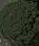

/content/10/-33.788032863260284_-33.788032863260284.png_3.jpg


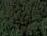

/content/10/-33.774165569919646_-33.774165569919646.png_27.jpg


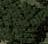

/content/10/-33.91108624210735_-33.91108624210735.png_2.jpg


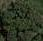

/content/10/-33.913442328940405_-33.913442328940405.png_12.jpg


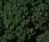

/content/10/-33.774165569919646_-33.774165569919646.png_8.jpg


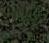

/content/10/-33.775954322152806_-33.775954322152806.png_54.jpg


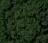

/content/10/-33.98307019138977_-33.98307019138977.png_18.jpg


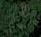

/content/10/-33.84853343930616_-33.84853343930616.png_32.jpg


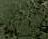

/content/10/-33.91747611903886_-33.91747611903886.png_19.jpg


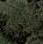

/content/10/-33.775954322152806_-33.775954322152806.png_18.jpg


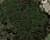

/content/10/-33.91731336912437_-33.91731336912437.png_2.jpg


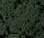

/content/10/-33.83612761820723_-33.83612761820723.png_16.jpg


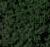

/content/10/-33.98307019138977_-33.98307019138977.png_17.jpg


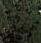

/content/10/-33.79817694475697_-33.79817694475697.png_36.jpg


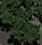

/content/10/-33.805987357059614_-33.805987357059614.png_23.jpg


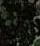

/content/10/-34.04817756328939_-34.04817756328939.png_29.jpg


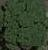

/content/10/-33.776279362565866_-33.776279362565866.png_6.jpg


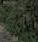

/content/10/-33.80897473791712_-33.80897473791712.png_16.jpg


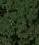

/content/10/-33.92071770130151_-33.92071770130151.png_54.jpg


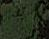

/content/10/-33.77204462165503_-33.77204462165503.png_11.jpg


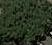

/content/10/-33.81475116780956_-33.81475116780956.png_6.jpg


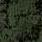

/content/10/-33.77254901554439_-33.77254901554439.png_60.jpg


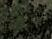

/content/10/-34.034844247315824_-34.034844247315824.png_20.jpg


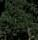

/content/10/-33.7955739455384_-33.7955739455384.png_76.jpg


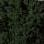

/content/10/-33.874052809962926_-33.874052809962926.png_41.jpg


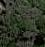

/content/10/-33.95990692866725_-33.95990692866725.png_20.jpg


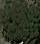

/content/10/-33.81475116780956_-33.81475116780956.png_8.jpg


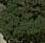

/content/10/-33.91548187886308_-33.91548187886308.png_22.jpg


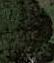

/content/10/-33.874052809962926_-33.874052809962926.png_2.jpg


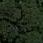

/content/10/-33.7955739455384_-33.7955739455384.png_86.jpg


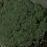

/content/10/-33.801540682301976_-33.801540682301976.png_1.jpg


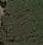

/content/10/-33.89883210872744_-33.89883210872744.png_53.jpg


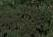

/content/10/-33.78740277568652_-33.78740277568652.png_20.jpg


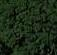

/content/10/-33.98307019138977_-33.98307019138977.png_40.jpg


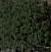

/content/10/-33.832925114904555_-33.832925114904555.png_7.jpg


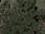

/content/10/-33.83939310108943_-33.83939310108943.png_0.jpg


/content/10/-33.776279362565866_-33.776279362565866.png_12.jpg


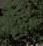

/content/10/-33.78678367009111_-33.78678367009111.png_10.jpg


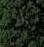

/content/10/-33.97967636751759_-33.97967636751759.png_41.jpg


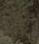

/content/10/-33.9296348024509_-33.9296348024509.png_38.jpg


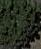

/content/10/-33.85759089763092_-33.85759089763092.png_12.jpg


/content/10/-33.79322352844539_-33.79322352844539.png_50.jpg


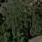

/content/10/-34.04817756328939_-34.04817756328939.png_17.jpg


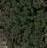

/content/10/-33.775954322152806_-33.775954322152806.png_71.jpg


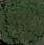

/content/10/-33.79127565817694_-33.79127565817694.png_5.jpg


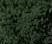

/content/10/-33.885429100221394_-33.885429100221394.png_34.jpg
----------------------------------------------------------


/content/11/-33.87300739454285_-33.87300739454285.png_10.jpg


/content/11/-34.03106634531281_-34.03106634531281.png_34.jpg


/content/11/-34.06008965076173_-34.06008965076173.png_46.jpg


/content/11/-33.91620426519703_-33.91620426519703.png_9.jpg


/content/11/-33.92973887689588_-33.92973887689588.png_46.jpg


/content/11/-33.79817694475697_-33.79817694475697.png_35.jpg


/content/11/-33.97764280851468_-33.97764280851468.png_53.jpg


/content/11/-33.906403962007815_-33.906403962007815.png_47.jpg


/content/11/-33.907249116719_-33.907249116719.png_25.jpg


/content/11/-33.920046555199235_-33.920046555199235.png_20.jpg


/content/11/-33.96260864427253_-33.96260864427253.png_16.jpg


/content/11/-33.92071770130151_-33.92071770130151.png_42.jpg


/content/11/-33.79689066318984_-33.79689066318984.png_46.jpg


/content/11/-33.92046249320792_-33.92046249320792.png_44.jpg


/content/11/-33.91425867323046_-33.91425867323046.png_9.jpg


/content/11/-33.96501659958289_-33.96501659958289.png_8.jpg


/content/11/-33.90656389648789_-33.90656389648789.png_5.jpg


/content/11/-33.970025382836006_-33.970025382836006.png_23.jpg


/content/11/-33.964306831909596_-33.964306831909596.png_37.jpg


/content/11/-33.90795006839414_-33.90795006839414.png_3.jpg


/content/11/-33.89883210872744_-33.89883210872744.png_34.jpg


/content/11/-33.93683627031715_-33.93683627031715.png_13.jpg


/content/11/-33.78132830284324_-33.78132830284324.png_35.jpg


/content/11/-33.81202107135806_-33.81202107135806.png_18.jpg


/content/11/-33.95756873295237_-33.95756873295237.png_17.jpg


/content/11/-33.80384444476587_-33.80384444476587.png_46.jpg


/content/11/-33.92331560899621_-33.92331560899621.png_42.jpg


/content/11/-34.05358480877774_-34.05358480877774.png_32.jpg


/content/11/-33.95338788313169_-33.95338788313169.png_25.jpg


/content/11/-33.96501659958289_-33.96501659958289.png_18.jpg


/content/11/-33.80574800633773_-33.80574800633773.png_37.jpg


/content/11/-33.98405015932163_-33.98405015932163.png_15.jpg


/content/11/-33.974194456550094_-33.974194456550094.png_37.jpg


/content/11/-33.96821607101372_-33.96821607101372.png_23.jpg


/content/11/-33.98401371375975_-33.98401371375975.png_26.jpg


/content/11/-33.79689066318984_-33.79689066318984.png_50.jpg


/content/11/-33.920046555199235_-33.920046555199235.png_23.jpg


/content/11/-33.953786645084264_-33.953786645084264.png_24.jpg


/content/11/-33.79208382680196_-33.79208382680196.png_14.jpg


/content/11/-33.851650482016794_-33.851650482016794.png_17.jpg


/content/11/-33.86288139852035_-33.86288139852035.png_39.jpg


/content/11/-33.968762189999936_-33.968762189999936.png_33.jpg


/content/11/-33.771661978605295_-33.771661978605295.png_13.jpg


/content/11/-33.91425867323046_-33.91425867323046.png_12.jpg


/content/11/-33.94416286870672_-33.94416286870672.png_13.jpg


/content/11/-33.90807947968192_-33.90807947968192.png_18.jpg


/content/11/-33.79689066318984_-33.79689066318984.png_44.jpg


/content/11/-33.80078884260376_-33.80078884260376.png_35.jpg


/content/11/-33.8160489739298_-33.8160489739298.png_29.jpg


/content/11/-33.95756873295237_-33.95756873295237.png_29.jpg


/content/11/-33.784620253157534_-33.784620253157534.png_42.jpg


/content/11/-33.85983197197308_-33.85983197197308.png_31.jpg


/content/11/-33.78678367009111_-33.78678367009111.png_19.jpg


/content/11/-33.959864698007685_-33.959864698007685.png_17.jpg


/content/11/-33.851650482016794_-33.851650482016794.png_32.jpg


/content/11/-33.98290397036044_-33.98290397036044.png_14.jpg


/content/11/-33.97039676265393_-33.97039676265393.png_40.jpg


/content/11/-33.89883210872744_-33.89883210872744.png_21.jpg


/content/11/-34.04020219188604_-34.04020219188604.png_36.jpg


/content/11/-33.91047395810337_-33.91047395810337.png_13.jpg


/content/11/-33.77492858950917_-33.77492858950917.png_25.jpg


/content/11/-33.79272203041733_-33.79272203041733.png_33.jpg


/content/11/-33.85983197197308_-33.85983197197308.png_22.jpg


/content/11/-33.92049321986321_-33.92049321986321.png_24.jpg


/content/11/-33.98426459454405_-33.98426459454405.png_30.jpg


/content/11/-33.79762945747859_-33.79762945747859.png_44.jpg


/content/11/-33.80556648530902_-33.80556648530902.png_33.jpg


/content/11/-33.836534872987535_-33.836534872987535.png_3.jpg


/content/11/-33.814392643509336_-33.814392643509336.png_28.jpg


/content/11/-33.90670084469867_-33.90670084469867.png_27.jpg


/content/11/-33.91525916281142_-33.91525916281142.png_52.jpg


/content/11/-33.92143324564951_-33.92143324564951.png_5.jpg


/content/11/-33.94033248385097_-33.94033248385097.png_23.jpg


/content/11/-33.97833800804419_-33.97833800804419.png_46.jpg


/content/11/-33.920799165386775_-33.920799165386775.png_21.jpg


/content/11/-33.97706397086192_-33.97706397086192.png_24.jpg


/content/11/-33.83165446563834_-33.83165446563834.png_47.jpg


/content/11/-33.9263666090922_-33.9263666090922.png_7.jpg


/content/11/-33.81701022985311_-33.81701022985311.png_32.jpg


/content/11/-33.97235110835986_-33.97235110835986.png_40.jpg


/content/11/-33.91195265784434_-33.91195265784434.png_15.jpg


/content/11/-33.955771136277015_-33.955771136277015.png_12.jpg


/content/11/-33.88085846895865_-33.88085846895865.png_16.jpg


/content/11/-33.81173224253344_-33.81173224253344.png_21.jpg


/content/11/-33.917216107222565_-33.917216107222565.png_8.jpg


/content/11/-33.89883210872744_-33.89883210872744.png_12.jpg


/content/11/-33.91548187886308_-33.91548187886308.png_18.jpg


/content/11/-33.91014460465312_-33.91014460465312.png_42.jpg


/content/11/-34.063661567701914_-34.063661567701914.png_8.jpg


/content/11/-33.87196721013416_-33.87196721013416.png_33.jpg


/content/11/-34.03892137271019_-34.03892137271019.png_57.jpg


/content/11/-33.81535115206846_-33.81535115206846.png_9.jpg


/content/11/-33.86122855260644_-33.86122855260644.png_22.jpg


/content/11/-33.94267835983631_-33.94267835983631.png_7.jpg


/content/11/-33.90512699972322_-33.90512699972322.png_26.jpg


/content/11/-33.8006543628537_-33.8006543628537.png_34.jpg


/content/11/-33.801540682301976_-33.801540682301976.png_47.jpg


/content/11/-33.87196721013416_-33.87196721013416.png_23.jpg


/content/11/-33.85691993785866_-33.85691993785866.png_13.jpg


/content/11/-33.93438224536404_-33.93438224536404.png_29.jpg
----------------------------------------------------------


/content/12/-33.79963973225738_-33.79963973225738.png_3.jpg


/content/12/-33.793517987148654_-33.793517987148654.png_37.jpg


/content/12/-33.8325839537181_-33.8325839537181.png_37.jpg


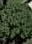

/content/12/-33.97764280851468_-33.97764280851468.png_9.jpg


/content/12/-34.052161107551896_-34.052161107551896.png_21.jpg


/content/12/-33.87196721013416_-33.87196721013416.png_32.jpg


/content/12/-33.96846285336229_-33.96846285336229.png_6.jpg


/content/12/-33.974194456550094_-33.974194456550094.png_31.jpg


/content/12/-33.933507613786325_-33.933507613786325.png_25.jpg


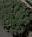

/content/12/-33.88085846895865_-33.88085846895865.png_5.jpg


/content/12/-33.80897473791712_-33.80897473791712.png_11.jpg


/content/12/-33.95443963473776_-33.95443963473776.png_6.jpg


/content/12/-33.977571521481245_-33.977571521481245.png_8.jpg


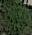

/content/12/-33.814151436279346_-33.814151436279346.png_20.jpg


/content/12/-33.853473766363024_-33.853473766363024.png_18.jpg


/content/12/-33.85393692228541_-33.85393692228541.png_22.jpg


/content/12/-33.96422754258788_-33.96422754258788.png_24.jpg


/content/12/-33.80313383211838_-33.80313383211838.png_23.jpg


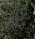

/content/12/-33.77477786112486_-33.77477786112486.png_19.jpg


/content/12/-33.93574485728175_-33.93574485728175.png_40.jpg


/content/12/-33.97039676265393_-33.97039676265393.png_35.jpg


/content/12/-33.90795006839414_-33.90795006839414.png_2.jpg


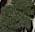

/content/12/-33.96450327978131_-33.96450327978131.png_27.jpg


/content/12/-33.982574284665546_-33.982574284665546.png_23.jpg


/content/12/-33.79223858531032_-33.79223858531032.png_3.jpg


/content/12/-33.956851588602134_-33.956851588602134.png_27.jpg


/content/12/-33.87300739454285_-33.87300739454285.png_21.jpg


/content/12/-33.80574800633773_-33.80574800633773.png_39.jpg


/content/12/-33.86122855260644_-33.86122855260644.png_16.jpg


/content/12/-33.97039676265393_-33.97039676265393.png_16.jpg


/content/12/-33.80078884260376_-33.80078884260376.png_30.jpg


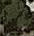

/content/12/-33.93765931056981_-33.93765931056981.png_25.jpg


/content/12/-33.79963973225738_-33.79963973225738.png_22.jpg


/content/12/-33.95730273942797_-33.95730273942797.png_16.jpg


/content/12/-34.04107787348382_-34.04107787348382.png_41.jpg


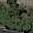

/content/12/-33.85759089763092_-33.85759089763092.png_21.jpg


/content/12/-33.91014460465312_-33.91014460465312.png_21.jpg


/content/12/-33.77269906651448_-33.77269906651448.png_42.jpg


/content/12/-33.90512699972322_-33.90512699972322.png_35.jpg


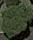

/content/12/-34.03677160959602_-34.03677160959602.png_9.jpg


/content/12/-33.92576753521442_-33.92576753521442.png_53.jpg


/content/12/-33.95730273942797_-33.95730273942797.png_28.jpg


/content/12/-33.784795244929164_-33.784795244929164.png_41.jpg


/content/12/-33.79341073135254_-33.79341073135254.png_45.jpg


/content/12/-33.953786645084264_-33.953786645084264.png_20.jpg


/content/12/-34.033365017731036_-34.033365017731036.png_19.jpg


/content/12/-33.81056329781624_-33.81056329781624.png_41.jpg


/content/12/-33.86122855260644_-33.86122855260644.png_28.jpg


/content/12/-33.954820329262276_-33.954820329262276.png_43.jpg


/content/12/-33.974519737480996_-33.974519737480996.png_43.jpg


/content/12/-33.94407247659519_-33.94407247659519.png_18.jpg


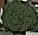

/content/12/-34.03677160959602_-34.03677160959602.png_13.jpg


/content/12/-33.80600584864532_-33.80600584864532.png_18.jpg


/content/12/-33.97129065781866_-33.97129065781866.png_17.jpg


/content/12/-33.7881458629625_-33.7881458629625.png_35.jpg


/content/12/-33.97764280851468_-33.97764280851468.png_31.jpg


/content/12/-33.78751943395539_-33.78751943395539.png_40.jpg


/content/12/-33.91948811581027_-33.91948811581027.png_24.jpg


/content/12/-33.96945427970518_-33.96945427970518.png_19.jpg


/content/12/-34.028841268192146_-34.028841268192146.png_24.jpg


/content/12/-33.963115096736395_-33.963115096736395.png_6.jpg


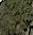

/content/12/-33.908736509946905_-33.908736509946905.png_13.jpg


/content/12/-33.77714794282482_-33.77714794282482.png_31.jpg


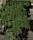

/content/12/-33.94407247659519_-33.94407247659519.png_8.jpg


/content/12/-33.80574800633773_-33.80574800633773.png_16.jpg


/content/12/-33.93574485728175_-33.93574485728175.png_29.jpg


/content/12/-33.97214649987404_-33.97214649987404.png_27.jpg


/content/12/-34.03677160959602_-34.03677160959602.png_29.jpg


/content/12/-33.9575494508767_-33.9575494508767.png_14.jpg


/content/12/-33.81018261141205_-33.81018261141205.png_22.jpg


/content/12/-33.78173763699905_-33.78173763699905.png_22.jpg


/content/12/-33.8212759735773_-33.8212759735773.png_27.jpg


/content/12/-33.81202107135806_-33.81202107135806.png_27.jpg


/content/12/-33.98023245961893_-33.98023245961893.png_25.jpg


/content/12/-33.9288631607713_-33.9288631607713.png_7.jpg


/content/12/-33.93765931056981_-33.93765931056981.png_36.jpg


/content/12/-33.982574284665546_-33.982574284665546.png_3.jpg


/content/12/-33.84622378450602_-33.84622378450602.png_24.jpg


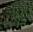

/content/12/-33.79341073135254_-33.79341073135254.png_27.jpg


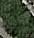

/content/12/-33.81456991599494_-33.81456991599494.png_44.jpg


/content/12/-33.910114025966166_-33.910114025966166.png_42.jpg


/content/12/-33.794766056579014_-33.794766056579014.png_33.jpg


/content/12/-33.90843029513644_-33.90843029513644.png_15.jpg


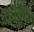

/content/12/-33.922329744499066_-33.922329744499066.png_14.jpg


/content/12/-33.982574284665546_-33.982574284665546.png_21.jpg


/content/12/-33.801540682301976_-33.801540682301976.png_53.jpg


/content/12/-33.91967731095415_-33.91967731095415.png_21.jpg


/content/12/-33.87061809048001_-33.87061809048001.png_6.jpg


/content/12/-33.805987357059614_-33.805987357059614.png_50.jpg


/content/12/-33.92534958615767_-33.92534958615767.png_13.jpg


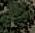

/content/12/-34.03892137271019_-34.03892137271019.png_26.jpg


/content/12/-33.92694526074041_-33.92694526074041.png_51.jpg


/content/12/-33.92618723253119_-33.92618723253119.png_3.jpg


/content/12/-33.869835193560625_-33.869835193560625.png_29.jpg


/content/12/-33.82355717281341_-33.82355717281341.png_12.jpg


/content/12/-33.814151436279346_-33.814151436279346.png_11.jpg


/content/12/-33.79322352844539_-33.79322352844539.png_8.jpg


/content/12/-33.80254487949665_-33.80254487949665.png_12.jpg


/content/12/-33.933507613786325_-33.933507613786325.png_4.jpg


/content/12/-33.954820329262276_-33.954820329262276.png_37.jpg
----------------------------------------------------------


/content/13/-33.974519737480996_-33.974519737480996.png_13.jpg


/content/13/-33.774165569919646_-33.774165569919646.png_79.jpg


/content/13/-33.77487029262844_-33.77487029262844.png_21.jpg


/content/13/-33.788032863260284_-33.788032863260284.png_5.jpg


/content/13/-33.806128795098715_-33.806128795098715.png_43.jpg


/content/13/-33.97129065781866_-33.97129065781866.png_35.jpg


/content/13/-33.844230871244505_-33.844230871244505.png_18.jpg


/content/13/-33.78740277568652_-33.78740277568652.png_37.jpg


/content/13/-33.77487029262844_-33.77487029262844.png_10.jpg


/content/13/-33.9296348024509_-33.9296348024509.png_12.jpg


/content/13/-33.80289295672762_-33.80289295672762.png_0.jpg


/content/13/-34.063661567701914_-34.063661567701914.png_18.jpg


/content/13/-33.77254901554439_-33.77254901554439.png_32.jpg


/content/13/-33.832925114904555_-33.832925114904555.png_22.jpg


/content/13/-33.80961749654923_-33.80961749654923.png_24.jpg


/content/13/-33.81269114630075_-33.81269114630075.png_8.jpg


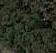

/content/13/-33.80897473791712_-33.80897473791712.png_49.jpg


/content/13/-33.79762945747859_-33.79762945747859.png_17.jpg


/content/13/-33.91726446346118_-33.91726446346118.png_8.jpg


/content/13/-33.81343619258548_-33.81343619258548.png_28.jpg


/content/13/-33.80600584864532_-33.80600584864532.png_5.jpg


/content/13/-33.82518198306368_-33.82518198306368.png_26.jpg


/content/13/-33.919328008694116_-33.919328008694116.png_3.jpg


/content/13/-34.05975652023457_-34.05975652023457.png_18.jpg


/content/13/-34.05358480877774_-34.05358480877774.png_16.jpg


/content/13/-33.92936514682347_-33.92936514682347.png_38.jpg


/content/13/-33.92936514682347_-33.92936514682347.png_46.jpg


/content/13/-33.814392643509336_-33.814392643509336.png_2.jpg


/content/13/-33.77204462165503_-33.77204462165503.png_35.jpg


/content/13/-34.04369269887961_-34.04369269887961.png_1.jpg


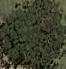

/content/13/-33.936934727662816_-33.936934727662816.png_0.jpg


/content/13/-33.96450327978131_-33.96450327978131.png_15.jpg


/content/13/-33.81202107135806_-33.81202107135806.png_12.jpg


/content/13/-34.04369269887961_-34.04369269887961.png_9.jpg


/content/13/-33.96163702635817_-33.96163702635817.png_0.jpg


/content/13/-33.91948811581027_-33.91948811581027.png_6.jpg


/content/13/-33.91108624210735_-33.91108624210735.png_14.jpg


/content/13/-33.85393692228541_-33.85393692228541.png_31.jpg


/content/13/-33.885429100221394_-33.885429100221394.png_13.jpg


/content/13/-33.85944570496735_-33.85944570496735.png_34.jpg


/content/13/-33.85944570496735_-33.85944570496735.png_36.jpg


/content/13/-33.92049321986321_-33.92049321986321.png_20.jpg


/content/13/-33.92576753521442_-33.92576753521442.png_2.jpg


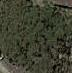

/content/13/-34.04593504687838_-34.04593504687838.png_15.jpg


/content/13/-33.80556648530902_-33.80556648530902.png_2.jpg


/content/13/-34.03729694257993_-34.03729694257993.png_7.jpg


/content/13/-33.91764819497187_-33.91764819497187.png_18.jpg


/content/13/-33.788032863260284_-33.788032863260284.png_1.jpg


/content/13/-33.92619375558609_-33.92619375558609.png_1.jpg


/content/13/-33.907058129708886_-33.907058129708886.png_5.jpg


/content/13/-34.034844247315824_-34.034844247315824.png_38.jpg


/content/13/-33.906403962007815_-33.906403962007815.png_5.jpg


/content/13/-33.92576753521442_-33.92576753521442.png_20.jpg


/content/13/-33.78132830284324_-33.78132830284324.png_1.jpg


/content/13/-33.80289295672762_-33.80289295672762.png_27.jpg


/content/13/-33.90843029513644_-33.90843029513644.png_35.jpg


/content/13/-33.92936514682347_-33.92936514682347.png_3.jpg


/content/13/-33.79430777628854_-33.79430777628854.png_20.jpg


/content/13/-34.04593504687838_-34.04593504687838.png_17.jpg


/content/13/-33.97213629614094_-33.97213629614094.png_2.jpg


/content/13/-33.784437582794766_-33.784437582794766.png_51.jpg


/content/13/-33.91195265784434_-33.91195265784434.png_16.jpg


/content/13/-33.79353198378261_-33.79353198378261.png_11.jpg


/content/13/-33.78740277568652_-33.78740277568652.png_43.jpg


/content/13/-33.92466729926398_-33.92466729926398.png_0.jpg


/content/13/-34.034844247315824_-34.034844247315824.png_10.jpg


/content/13/-33.976367714598126_-33.976367714598126.png_8.jpg


/content/13/-33.776279362565866_-33.776279362565866.png_15.jpg


/content/13/-33.92143324564951_-33.92143324564951.png_7.jpg


/content/13/-33.91014460465312_-33.91014460465312.png_14.jpg


/content/13/-34.03892137271019_-34.03892137271019.png_12.jpg


/content/13/-33.91967731095415_-33.91967731095415.png_3.jpg


/content/13/-33.91525916281142_-33.91525916281142.png_8.jpg


/content/13/-33.79689066318984_-33.79689066318984.png_14.jpg


/content/13/-33.90807947968192_-33.90807947968192.png_16.jpg


/content/13/-33.81154006507382_-33.81154006507382.png_16.jpg


/content/13/-33.78132830284324_-33.78132830284324.png_4.jpg


/content/13/-33.885429100221394_-33.885429100221394.png_0.jpg


/content/13/-33.79817694475697_-33.79817694475697.png_9.jpg


/content/13/-33.80210418723449_-33.80210418723449.png_0.jpg


/content/13/-34.05358480877774_-34.05358480877774.png_29.jpg


/content/13/-34.04593504687838_-34.04593504687838.png_6.jpg


/content/13/-33.97129065781866_-33.97129065781866.png_5.jpg


/content/13/-33.93438224536404_-33.93438224536404.png_10.jpg


/content/13/-33.920782491181214_-33.920782491181214.png_0.jpg


/content/13/-33.80961749654923_-33.80961749654923.png_2.jpg


/content/13/-33.91878005615652_-33.91878005615652.png_0.jpg


/content/13/-34.056282311215185_-34.056282311215185.png_0.jpg


/content/13/-34.04817756328939_-34.04817756328939.png_13.jpg


/content/13/-33.90843029513644_-33.90843029513644.png_5.jpg


/content/13/-34.03677160959602_-34.03677160959602.png_5.jpg


/content/13/-33.820399886844186_-33.820399886844186.png_19.jpg


/content/13/-33.81173224253344_-33.81173224253344.png_0.jpg


/content/13/-33.77254901554439_-33.77254901554439.png_15.jpg


/content/13/-33.91726446346118_-33.91726446346118.png_14.jpg


/content/13/-33.978472430137465_-33.978472430137465.png_1.jpg


/content/13/-33.78970910055953_-33.78970910055953.png_15.jpg


/content/13/-33.92936514682347_-33.92936514682347.png_16.jpg


/content/13/-33.80600584864532_-33.80600584864532.png_4.jpg


/content/13/-33.9296348024509_-33.9296348024509.png_17.jpg
----------------------------------------------------------
----------------------------------------------------------


In [ ]:
from IPython.display import Image, display

max_each_label = 100
for i in range(0, CLUSTERS + 1):
  folder_path = f"/content/{i}/"
  current = 0
  for filename in os.listdir(folder_path):
    if current >= max_each_label:
      break
    if filename.endswith('.jpg') or filename.endswith('.png'):
      display(Image(filename=folder_path + filename))
      print(folder_path + filename)
      current += 1
  print("----------------------------------------------------------")


# Larger area

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
! cp /content/drive/MyDrive/sydney_checkpoint2.pl .

Mounted at /content/drive


In [ ]:
from deepforest import main
import os
import matplotlib.pyplot as plt
# model = main.deepforest()
# model.use_release()
model  = main.deepforest.load_from_checkpoint("/content/sydney_checkpoint2.pl")

Reading config file: /usr/local/lib/python3.10/dist-packages/deepforest/data/deepforest_config.yml


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


No validation file provided. Turning off validation loop


In [ ]:
from  deepforest import get_data
raster_path = get_data("/content/output.tif")
predicted_raster = model.predict_tile(raster_path, return_plot = True, patch_size=700,patch_overlap=0.3)
f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)
plt.imshow(predicted_raster[:,:,::])


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=1` in the `DataLoader` to improve performance.


Predicting: |          | 0/? [00:00<?, ?it/s]

7395 predictions in overlapping windows, applying non-max supression
3662 predictions kept after non-max suppression


/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.10/dist-packages/deepforest/visualize.py:115: UserWarning: Input images must be channels last format [h, w, 3] not channels first [3, h, w], using np.rollaxis(image, 0, 3) to invert!
  warnings.warn("Input images must be channels last format [h, w, 3] not channels "
/usr/local/lib/python3.10/dist-packages/deepforest/visualize.py:123: UserWarning: No color was provided and the label column is not numeric. Using a single default color.
  warnings.warn("No color was provided and the label column is not numeric. "


In [ ]:
raster_path = get_data("/content/output.tif")
predicted_raster = model.predict_tile(raster_path, return_plot = False, patch_size=700,patch_overlap=0.3)
predicted_raster

/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=1` in the `DataLoader` to improve performance.


Predicting: |          | 0/? [00:00<?, ?it/s]

916 predictions in overlapping windows, applying non-max supression
410 predictions kept after non-max suppression


,xmin,ymin,xmax,ymax,label,score,image_path
0,980.0,1041.0,1023.0,1101.0,Tree,0.865996,output.tif
1,43.0,1159.0,87.0,1204.0,Tree,0.859090,output.tif
2,1354.0,555.0,1402.0,605.0,Tree,0.848772,output.tif
3,1755.0,1267.0,1803.0,1315.0,Tree,0.846090,output.tif
4,1675.0,1079.0,1729.0,1132.0,Tree,0.846033,output.tif
...,...,...,...,...,...,...,...
405,1445.0,1636.0,1492.0,1686.0,Tree,0.170572,output.tif
406,1086.0,529.0,1132.0,573.0,Tree,0.166600,output.tif
407,884.0,380.0,929.0,424.0,Tree,0.162074,output.tif
408,863.0,1159.0,922.0,1190.0,Tree,0.127704,output.tif


import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(predicted_raster, *['xmin'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(predicted_raster, *['ymin'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(predicted_raster, *['xmax'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(predicted_raster, *['ymax'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plot(df, x_colname, y_colname, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(6 * figscale, 6 * figscale))
  df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha)
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plot(predicted_raster, *['xmin', 'ymin'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plot(df, x_colname, y_colname, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(6 * figscale, 6 * figscale))
  df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha)
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plot(predicted_raster, *['ymin', 'xmax'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plot(df, x_colname, y_colname, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(6 * figscale, 6 * figscale))
  df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha)
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plot(predicted_raster, *['xmax', 'ymax'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plot(df, x_colname, y_colname, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(6 * figscale, 6 * figscale))
  df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha)
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plot(predicted_raster, *['ymax', 'score'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(predicted_raster, *['xmin'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(predicted_raster, *['ymin'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(predicted_raster, *['xmax'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(predicted_raster, *['ymax'], **{})
chart

In [ ]:
import rasterio
from rasterio.plot import show

img = get_data("/content/output.tif")
r = rasterio.open(img)
show(r )
# transform = r.transform
# crs = r.crs
# r


/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


<Axes: >

In [ ]:
from deepforest import get_data
type(get_data("/content/stitched_image.png"))

str

In [ ]:
r.height

400

In [ ]:
r.read(3)

array([[128, 106, 113, ..., 102, 115, 128],
       [152, 139, 110, ..., 114, 102, 100],
       [132, 107,  76, ..., 137, 103,  90],
       ...,
       [172, 130, 144, ..., 104, 183, 109],
       [117, 111, 137, ..., 131, 174,  87],
       [112, 107, 122, ..., 130, 133, 108]], dtype=uint8)

In [ ]:
from PIL import Image

# Open the PNG image
png_image = Image.open("/content/stitched_image.png")

# Ensure that the image has an RGB mode (some images might have different modes)
if png_image.mode != "RGB":
    png_image = png_image.convert("RGB")

# Save the RGB data as a TIFF image
png_image.save("output.tif")

# Close the image
png_image.close()


# Backend Test

In [ ]:
from deepforest import main
import joblib
import cv2
from keras.applications.vgg16 import VGG16
from keras.models import Model
from keras.applications.vgg16 import preprocess_input

detect_model_path = "/content/sydney_checkpoint2.pl"
cluster_model_path = "/content/cluster.pkl"
pca_path = "/content/pca.pkl"
detect_model = main.deepforest.load_from_checkpoint(detect_model_path)
cluster_model = joblib.load(cluster_model_path)
pca = joblib.load(pca_path)
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)
feature_extractor = model
rbg_image = cv2.imread("/content/stitched_image.png")

Reading config file: /usr/local/lib/python3.10/dist-packages/deepforest/data/deepforest_config.yml


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


No validation file provided. Turning off validation loop


In [ ]:
def map_label_to_tree_type(label):
    # for example only
    print(label)
    maper = {
        1 : 'Pine',
        2 : 'Spruce',
        3 : 'Birch',
        4 : 'Oak',
        5 : 'Ash',
        6 : 'Maple',
        7 : 'Aspen',
        9 : 'Willow',
        10 : 'Alder',
        11 : 'Poplar',
        12 : 'Fir',
        13 : 'Cedar',
        14 : 'Hemlock',
    }
    return maper[label]

def extract_features(image, model, pca):
    img = cv2.resize(image, (224, 224))
    reshaped_img = img.reshape(1,224,224,3)
    imgx = preprocess_input(reshaped_img)
    features = model.predict(imgx, use_multiprocessing=True)
    return pca.transform(features)

def process_one(index, row, bgr_image, feature_extractor, pca, cluster_model):
      xmin, ymin, xmax, ymax = row['xmin'], row['ymin'], row['xmax'], row['ymax']
      # crop the image using the bounding box
      cropped_image = bgr_image[int(ymin):int(ymax), int(xmin):int(xmax)]
      feature = extract_features(cropped_image, feature_extractor, pca)
      label = cluster_model.predict(feature)
      if label == 8:
          return None
      return {
          'seq_number' : index,
          'position' : {'x' : np.average([row['xmin'], row['xmax']]), 'y' : np.average([row['ymin'], row['ymax']])},
          'size' : {'width': row['xmax'] - row['xmin'], 'height': row['ymax'] - row['ymin']},
          'model_type' : map_label_to_tree_type(label[0])
      }

In [ ]:
def predict(bgr_image):
  pred = detect_model.predict_tile(image = bgr_image, return_plot = False, patch_size=700,patch_overlap=0.3)
  trees = []

  if pred is None:
      return trees
  for index, row in pred.iterrows():
      trees.append(process_one(index, row, bgr_image, feature_extractor, pca, cluster_model))
  return trees

In [ ]:
result = predict(rbg_image)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=1` in the `DataLoader` to improve performance.


Predicting: |          | 0/? [00:00<?, ?it/s]

1814 predictions in overlapping windows, applying non-max supression
936 predictions kept after non-max suppression
1/1 [==============================] - 0s 21ms/step
7
1/1 [==============================] - 0s 66ms/step
4
1/1 [==============================] - 0s 19ms/step
7
1/1 [==============================] - 0s 19ms/step
7
1/1 [==============================] - 0s 22ms/step
7
1/1 [==============================] - 0s 20ms/step
4
1/1 [==============================] - 0s 18ms/step
13
1/1 [==============================] - 0s 22ms/step
4
1/1 [==============================] - 0s 21ms/step
7
1/1 [==============================] - 0s 22ms/step
13
1/1 [==============================] - 0s 21ms/step
7
1/1 [==============================] - 0s 20ms/step
7
1/1 [==============================] - 0s 21ms/step
7
1/1 [==============================] - 0s 20ms/step
7
1/1 [==============================] - 0s 19ms/step
7
1/1 [==============================] - 0s 21ms/step
7
1/1 [=============

In [ ]:
len(result)

936

In [ ]:
!pip list | grep keras

keras                            2.13.1
